In [1]:
library(Signac)
library(Seurat)
library(EnsDb.Hsapiens.v86)
library(BSgenome.Hsapiens.UCSC.hg38)
set.seed(1234)
#library(dplyr)
library(AUCell)
library(GSEABase)
library(ggplot2)
library(future)
library(tidyverse)
library(RCurl)
library(AnnotationHub)
library(ggplot2)
library(ArchR)

Attaching SeuratObject

Loading required package: ensembldb

Loading required package: BiocGenerics


Attaching package: ‘BiocGenerics’


The following objects are masked from ‘package:stats’:

    IQR, mad, sd, var, xtabs


The following objects are masked from ‘package:base’:

    anyDuplicated, aperm, append, as.data.frame, basename, cbind,
    colnames, dirname, do.call, duplicated, eval, evalq, Filter, Find,
    get, grep, grepl, intersect, is.unsorted, lapply, Map, mapply,
    match, mget, order, paste, pmax, pmax.int, pmin, pmin.int,
    Position, rank, rbind, Reduce, rownames, sapply, setdiff, sort,
    table, tapply, union, unique, unsplit, which.max, which.min


Loading required package: GenomicRanges

Loading required package: stats4

Loading required package: S4Vectors


Attaching package: ‘S4Vectors’


The following objects are masked from ‘package:base’:

    expand.grid, I, unname


Loading required package: IRanges

Loading required package: GenomeInfoDb

Loading requir

In [2]:
options(future.globals.maxSize = 8000 * 1024^2)
library(BiocParallel)
register(SerialParam())

In [3]:
plan("multicore", workers = 70)


In [41]:
# get gene annotations for hg38
annotation <- GetGRangesFromEnsDb(ensdb = EnsDb.Hsapiens.v86)
seqlevelsStyle(annotation) <-'UCSC'
genome(annotation) <- "hg38"

Warning message in .merge_two_Seqinfo_objects(x, y):
"The 2 combined objects have no sequence levels in common. (Use
  suppressWarnings() to suppress this warning.)"
Warning message in .merge_two_Seqinfo_objects(x, y):
"The 2 combined objects have no sequence levels in common. (Use
  suppressWarnings() to suppress this warning.)"
Warning message in .merge_two_Seqinfo_objects(x, y):
"The 2 combined objects have no sequence levels in common. (Use
  suppressWarnings() to suppress this warning.)"
Warning message in .merge_two_Seqinfo_objects(x, y):
"The 2 combined objects have no sequence levels in common. (Use
  suppressWarnings() to suppress this warning.)"
Warning message in .merge_two_Seqinfo_objects(x, y):
"The 2 combined objects have no sequence levels in common. (Use
  suppressWarnings() to suppress this warning.)"
Warning message in .merge_two_Seqinfo_objects(x, y):
"The 2 combined objects have no sequence levels in common. (Use
  suppressWarnings() to suppress this warning.)"
Warn

In [42]:
#atac
core1<-"/disk1/pengweixing/lene_sc_glio/02.single_cell/Core/outs/atac_fragments.tsv.gz"
names(core1)<-"core1"
edge1<-"/disk1/pengweixing/lene_sc_glio/02.single_cell/EDGE/outs/atac_fragments.tsv.gz"
names(edge1)<-"edge1"
core2<-"/disk1/xilu/glioblastoma_single_cell/1.Data/sample1/outs/atac_fragments.tsv.gz"
names(core2)<-"core2"
edge2<-"/disk1/xilu/glioblastoma_single_cell/1.Data/sample2/outs/atac_fragments.tsv.gz"
names(edge2)<-"edge2"
edge3<-"/disk1/xilu/glioblastoma_single_cell/1.Data/sample3/outs/atac_fragments.tsv.gz"
names(edge3)<-"core3"
core3<-"/disk1/xilu/glioblastoma_single_cell/1.Data/sample4/outs/atac_fragments.tsv.gz"
names(edge3)<-"core3"

In [6]:
#rna-seq
glio_core11<-get(load("/disk1/xilu/glioblastoma_single_cell/1.RNA/1.RNA_seq_seurat/glio_rna.core.filterh5.filter.RData"))
glio_core21<-get(load("/disk1/xilu/glioblastoma_single_cell/1.RNA/1.RNA_seq_seurat_second/glio_rna.core.filterh5.filter.RData"))
glio_core31<-get(load("/disk1/xilu/glioblastoma_single_cell/1.RNA/1.RNA_seq_seurat_third/glio_rna.core.filterh5.filter.RData"))
glio_edge11<-get(load("/disk1/xilu/glioblastoma_single_cell/1.RNA/1.RNA_seq_seurat/glio_rna.edge.filterh5.filter.RData"))
glio_edge21<-get(load("/disk1/xilu/glioblastoma_single_cell/1.RNA/1.RNA_seq_seurat_second/glio_rna.edge.filterh5.filter.RData"))
glio_edge31<-get(load("/disk1/xilu/glioblastoma_single_cell/1.RNA/1.RNA_seq_seurat_third/glio_rna.edge.filterh5.filter.RData"))

In [7]:
glio_core11<-RenameCells(object = glio_core11,new.names = gsub("core_RNA_","",names(glio_core11$orig.ident)))
glio_core21<-RenameCells(object = glio_core21,new.names = gsub("core_RNA_","",names(glio_core21$orig.ident)))
glio_core31<-RenameCells(object = glio_core31,new.names = gsub("core_RNA_","",names(glio_core31$orig.ident)))
glio_edge11<-RenameCells(object = glio_edge11,new.names = gsub("edge_RNA_","",names(glio_edge11$orig.ident)))
glio_edge21<-RenameCells(object = glio_edge21,new.names = gsub("edge_RNA_","",names(glio_edge21$orig.ident)))
glio_edge31<-RenameCells(object = glio_edge31,new.names = gsub("edge_RNA_","",names(glio_edge31$orig.ident)))

In [8]:
counts_core1 <- Read10X_h5("/disk1/pengweixing/lene_sc_glio/02.single_cell/Core/outs/filtered_feature_bc_matrix.h5")
counts_edge1 <- Read10X_h5("/disk1/pengweixing/lene_sc_glio/02.single_cell/EDGE/outs/filtered_feature_bc_matrix.h5")
counts_core2 <- Read10X_h5("/disk1/xilu/glioblastoma_single_cell/1.Data/sample1/outs/filtered_feature_bc_matrix.h5")
counts_edge2 <- Read10X_h5("/disk1/xilu/glioblastoma_single_cell/1.Data/sample2/outs/filtered_feature_bc_matrix.h5")
counts_core3 <- Read10X_h5("/disk1/xilu/glioblastoma_single_cell/1.Data/sample4/outs/filtered_feature_bc_matrix.h5")
counts_edge3 <- Read10X_h5("/disk1/xilu/glioblastoma_single_cell/1.Data/sample3/outs/filtered_feature_bc_matrix.h5")


Genome matrix has multiple modalities, returning a list of matrices for this genome

Genome matrix has multiple modalities, returning a list of matrices for this genome

Genome matrix has multiple modalities, returning a list of matrices for this genome

Genome matrix has multiple modalities, returning a list of matrices for this genome

Genome matrix has multiple modalities, returning a list of matrices for this genome

Genome matrix has multiple modalities, returning a list of matrices for this genome



In [9]:
#rna-seq
glio_core1<-CreateSeuratObject(counts = counts_core1$`Gene Expression`,assay = "RNA")
glio_core2<-CreateSeuratObject(counts = counts_core2$`Gene Expression`,assay = "RNA")
glio_core3<-CreateSeuratObject(counts = counts_core3$`Gene Expression`,assay = "RNA")
glio_edge1<-CreateSeuratObject(counts = counts_edge1$`Gene Expression`,assay = "RNA")
glio_edge2<-CreateSeuratObject(counts = counts_edge2$`Gene Expression`,assay = "RNA")
glio_edge3<-CreateSeuratObject(counts = counts_edge3$`Gene Expression`,assay = "RNA")

In [10]:
glio_core1[["ATAC"]]<-CreateChromatinAssay(counts = counts_core1$Peaks, sep = c(":", "-"),fragments = core1, annotation = annotation)

Computing hash



In [11]:
glio_edge1[["ATAC"]]<-CreateChromatinAssay(counts = counts_edge1$Peaks, sep = c(":", "-"),fragments = edge1, annotation = annotation)

Computing hash



In [12]:
glio_core2[["ATAC"]]<-CreateChromatinAssay(counts = counts_core2$Peaks, sep = c(":", "-"),fragments = core2, annotation = annotation)

Computing hash



In [13]:
glio_edge2[["ATAC"]]<-CreateChromatinAssay(counts = counts_edge2$Peaks, sep = c(":", "-"),fragments = edge2, annotation = annotation)

Computing hash



In [14]:
glio_core3[["ATAC"]]<-CreateChromatinAssay(counts = counts_core3$Peaks, sep = c(":", "-"),fragments = core3, annotation = annotation)

Computing hash



In [15]:
glio_edge3[["ATAC"]]<-CreateChromatinAssay(counts = counts_edge3$Peaks, sep = c(":", "-"),fragments = edge3, annotation = annotation)

Computing hash



In [16]:
glio_core1<-glio_core1[,rownames(glio_core11@meta.data)]
glio_core2<-glio_core2[,rownames(glio_core21@meta.data)]
glio_core3<-glio_core3[,rownames(glio_core31@meta.data)]

glio_edge1<-glio_edge1[,rownames(glio_edge11@meta.data)]
glio_edge2<-glio_edge2[,rownames(glio_edge21@meta.data)]
glio_edge3<-glio_edge3[,rownames(glio_edge31@meta.data)]

In [17]:
glio_core1$type <- "core"
glio_edge1$type <- "edge"
glio_core2$type <- "core"
glio_edge2$type <- "edge"
glio_core3$type <- "core"
glio_edge3$type <- "edge"

In [18]:
glio_core1$patient <- "patient1"
glio_edge1$patient <- "patient1"
glio_core2$patient <- "patient2"
glio_edge2$patient <- "patient2"
glio_core3$patient <- "patient3"
glio_edge3$patient <- "patient3"

In [19]:
DefaultAssay(glio_core1) <- "ATAC"
DefaultAssay(glio_edge1) <- "ATAC"
DefaultAssay(glio_core2) <- "ATAC"
DefaultAssay(glio_edge2) <- "ATAC"
DefaultAssay(glio_core3) <- "ATAC"
DefaultAssay(glio_edge3) <- "ATAC"
options(future.globals.maxSize = 8000 * 1024^2)

In [20]:
combined.peaks <- UnifyPeaks(object.list = list(glio_core1, glio_core2, glio_core3, glio_edge1,glio_edge2,glio_edge3), mode = "reduce")

Warning message in .merge_two_Seqinfo_objects(x, y):
"Each of the 2 combined objects has sequence levels not in the other:
  - in 'x': GL000194.1, KI270727.1
  - in 'y': KI270726.1
  Make sure to always combine/compare objects based on the same reference
  genome (use suppressWarnings() to suppress this warning)."
Warning message in .merge_two_Seqinfo_objects(x, y):
"Each of the 2 combined objects has sequence levels not in the other:
  - in 'x': KI270727.1, KI270726.1
  - in 'y': KI270711.1
  Make sure to always combine/compare objects based on the same reference
  genome (use suppressWarnings() to suppress this warning)."
Warning message in .merge_two_Seqinfo_objects(x, y):
"Each of the 2 combined objects has sequence levels not in the other:
  - in 'x': KI270728.1, KI270726.1, KI270711.1
  - in 'y': GL000218.1
  Make sure to always combine/compare objects based on the same reference
  genome (use suppressWarnings() to suppress this warning)."
Warning message in .merge_two_Seqinfo_ob

In [21]:
#peaks.use<-sample(combined.peaks,21300)

In [22]:
peaks.use<-combined.peaks[1:213000]

In [23]:
counts_core1_peak_matrix<-FeatureMatrix(fragments = Fragments(glio_core1),features = peaks.use,cells = colnames(glio_core1))
counts_core2_peak_matrix<-FeatureMatrix(fragments = Fragments(glio_core2),features = peaks.use,cells = colnames(glio_core2))
counts_core3_peak_matrix<-FeatureMatrix(fragments = Fragments(glio_core3),features = peaks.use,cells = colnames(glio_core3))
counts_edge1_peak_matrix<-FeatureMatrix(fragments = Fragments(glio_edge1),features = peaks.use,cells = colnames(glio_edge1))
counts_edge2_peak_matrix<-FeatureMatrix(fragments = Fragments(glio_edge2),features = peaks.use,cells = colnames(glio_edge2))
counts_edge3_peak_matrix<-FeatureMatrix(fragments = Fragments(glio_edge3),features = peaks.use,cells = colnames(glio_edge3))



Extracting reads overlapping genomic regions

Extracting reads overlapping genomic regions

Extracting reads overlapping genomic regions

Extracting reads overlapping genomic regions

Extracting reads overlapping genomic regions

Extracting reads overlapping genomic regions



In [24]:
glio_core1[["ATAC_common_peak"]] <- CreateChromatinAssay(counts = counts_core1_peak_matrix,ranges = peaks.use,annotation = annotation,fragments = Fragments(glio_core1))
glio_core2[["ATAC_common_peak"]] <- CreateChromatinAssay(counts = counts_core2_peak_matrix,ranges = peaks.use,annotation = annotation,fragments = Fragments(glio_core2))
glio_core3[["ATAC_common_peak"]] <- CreateChromatinAssay(counts = counts_core3_peak_matrix,ranges = peaks.use,annotation = annotation,fragments = Fragments(glio_core3))
glio_edge1[["ATAC_common_peak"]] <- CreateChromatinAssay(counts = counts_edge1_peak_matrix,ranges = peaks.use,annotation = annotation,fragments = Fragments(glio_edge1))
glio_edge2[["ATAC_common_peak"]] <- CreateChromatinAssay(counts = counts_edge2_peak_matrix,ranges = peaks.use,annotation = annotation,fragments = Fragments(glio_edge2))
glio_edge3[["ATAC_common_peak"]] <- CreateChromatinAssay(counts = counts_edge3_peak_matrix,ranges = peaks.use,annotation = annotation,fragments = Fragments(glio_edge3))

Warning message:
"Keys should be one or more alphanumeric characters followed by an underscore, setting key from atac_common_peak_ to ataccommonpeak_"
Warning message:
"Keys should be one or more alphanumeric characters followed by an underscore, setting key from atac_common_peak_ to ataccommonpeak_"
Warning message:
"Keys should be one or more alphanumeric characters followed by an underscore, setting key from atac_common_peak_ to ataccommonpeak_"
Warning message:
"Keys should be one or more alphanumeric characters followed by an underscore, setting key from atac_common_peak_ to ataccommonpeak_"
Warning message:
"Keys should be one or more alphanumeric characters followed by an underscore, setting key from atac_common_peak_ to ataccommonpeak_"
Warning message:
"Keys should be one or more alphanumeric characters followed by an underscore, setting key from atac_common_peak_ to ataccommonpeak_"


In [25]:
DefaultAssay(glio_core1) <- "ATAC_common_peak"
DefaultAssay(glio_edge1) <- "ATAC_common_peak"
DefaultAssay(glio_core2) <- "ATAC_common_peak"
DefaultAssay(glio_edge2) <- "ATAC_common_peak"
DefaultAssay(glio_core3) <- "ATAC_common_peak"
DefaultAssay(glio_edge3) <- "ATAC_common_peak"

In [26]:
glio_core1 <- NucleosomeSignal(glio_core1)
glio_core1 <- TSSEnrichment(glio_core1)
glio_edge1 <- NucleosomeSignal(glio_edge1)
glio_edge1 <- TSSEnrichment(glio_edge1)
glio_core2 <- NucleosomeSignal(glio_core2)
glio_core2 <- TSSEnrichment(glio_core2)
glio_edge2 <- NucleosomeSignal(glio_edge2)
glio_edge2 <- TSSEnrichment(glio_edge2)
glio_core3 <- NucleosomeSignal(glio_core3)
glio_core3 <- TSSEnrichment(glio_core3)
glio_edge3 <- NucleosomeSignal(glio_edge3)
glio_edge3 <- TSSEnrichment(glio_edge3)

Extracting TSS positions

Extracting fragments at TSSs


Computing TSS enrichment score

Extracting TSS positions

Extracting fragments at TSSs


Computing TSS enrichment score

Extracting TSS positions

Extracting fragments at TSSs


Computing TSS enrichment score

Extracting TSS positions

Extracting fragments at TSSs


Computing TSS enrichment score

Extracting TSS positions

Extracting fragments at TSSs


Computing TSS enrichment score

Extracting TSS positions

Extracting fragments at TSSs


Computing TSS enrichment score



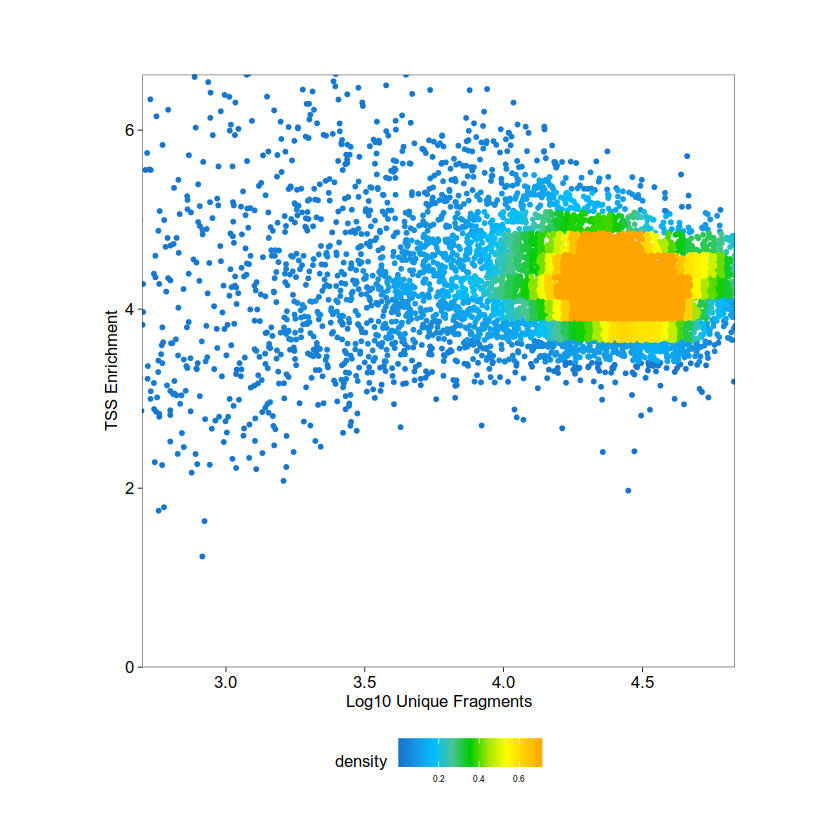

In [27]:
df_edge<-glio_edge1@meta.data[,c('nCount_ATAC','TSS.enrichment','nucleosome_signal','TSS.percentile')]
df_edge$nFrags<-log10(df_edge$nCount_ATAC)
colnames(df_edge)<-replace(x=colnames(df_edge),list=c(colnames(df_edge)=='nFrags'),values='log10(nFrags)')

ggPoint(x=df_edge[,5],y=df_edge[,2],colorDensity = T,     
    continuousSet = "sambaNight",
    xlabel = "Log10 Unique Fragments",
    ylabel = "TSS Enrichment",
    xlim = c(log10(500), quantile(df_edge[,5], probs = 0.99)),
    ylim = c(0, quantile(df_edge[,2], probs = 0.99))
        )

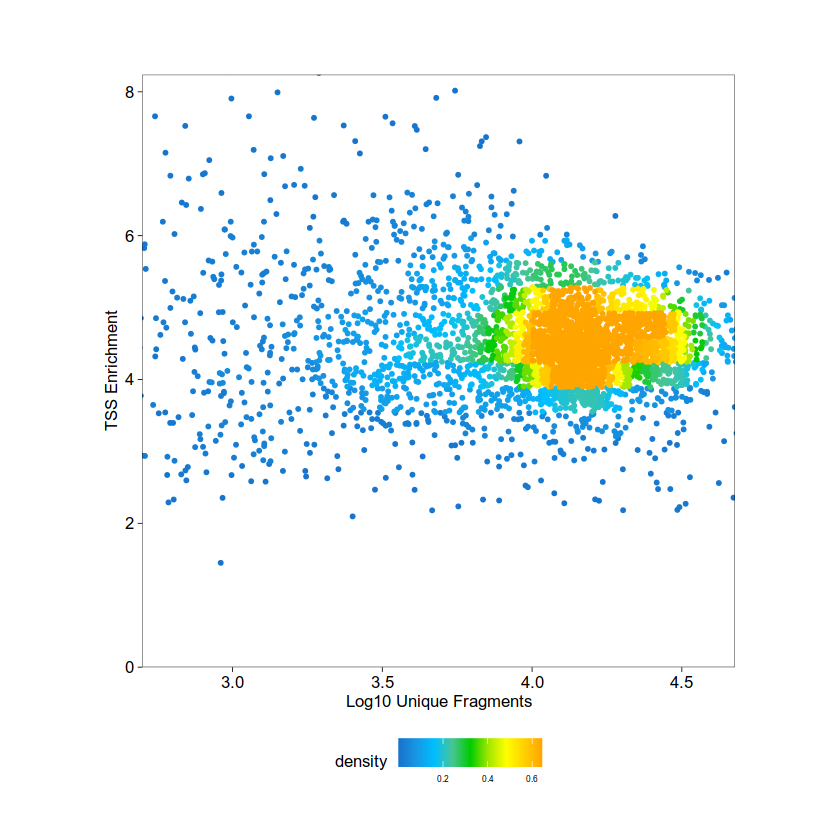

In [28]:
df_edge<-glio_edge2@meta.data[,c('nCount_ATAC','TSS.enrichment','nucleosome_signal','TSS.percentile')]
df_edge$nFrags<-log10(df_edge$nCount_ATAC)
colnames(df_edge)<-replace(x=colnames(df_edge),list=c(colnames(df_edge)=='nFrags'),values='log10(nFrags)')
ggPoint(x=df_edge[,5],y=df_edge[,2],colorDensity = T,     
    continuousSet = "sambaNight",
    xlabel = "Log10 Unique Fragments",
    ylabel = "TSS Enrichment",
    xlim = c(log10(500), quantile(df_edge[,5], probs = 0.99)),
    ylim = c(0, quantile(df_edge[,2], probs = 0.99))
        )


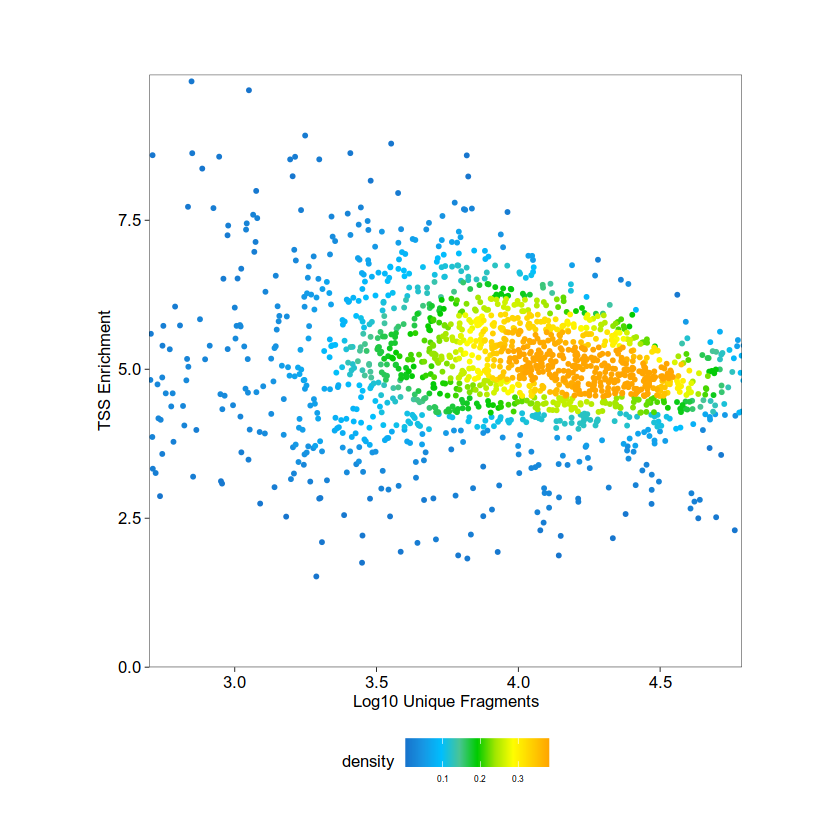

In [29]:
df_edge<-glio_edge3@meta.data[,c('nCount_ATAC','TSS.enrichment','nucleosome_signal','TSS.percentile')]
df_edge$nFrags<-log10(df_edge$nCount_ATAC)
colnames(df_edge)<-replace(x=colnames(df_edge),list=c(colnames(df_edge)=='nFrags'),values='log10(nFrags)')
ggPoint(x=df_edge[,5],y=df_edge[,2],colorDensity = T,     
    continuousSet = "sambaNight",
    xlabel = "Log10 Unique Fragments",
    ylabel = "TSS Enrichment",
    xlim = c(log10(500), quantile(df_edge[,5], probs = 0.99)),
    ylim = c(0, quantile(df_edge[,2], probs = 0.99))
        )


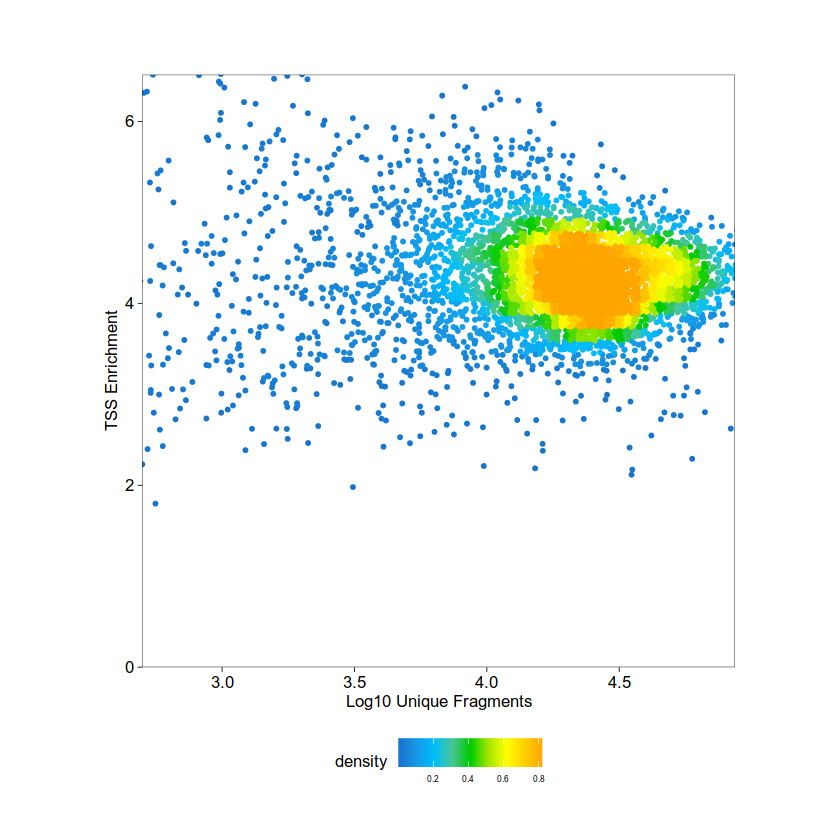

In [30]:
df_edge<-glio_core1@meta.data[,c('nCount_ATAC','TSS.enrichment','nucleosome_signal','TSS.percentile')]
df_edge$nFrags<-log10(df_edge$nCount_ATAC)
colnames(df_edge)<-replace(x=colnames(df_edge),list=c(colnames(df_edge)=='nFrags'),values='log10(nFrags)')
ggPoint(x=df_edge[,5],y=df_edge[,2],colorDensity = T,     
    continuousSet = "sambaNight",
    xlabel = "Log10 Unique Fragments",
    ylabel = "TSS Enrichment",
    xlim = c(log10(500), quantile(df_edge[,5], probs = 0.99)),
    ylim = c(0, quantile(df_edge[,2], probs = 0.99))
        )

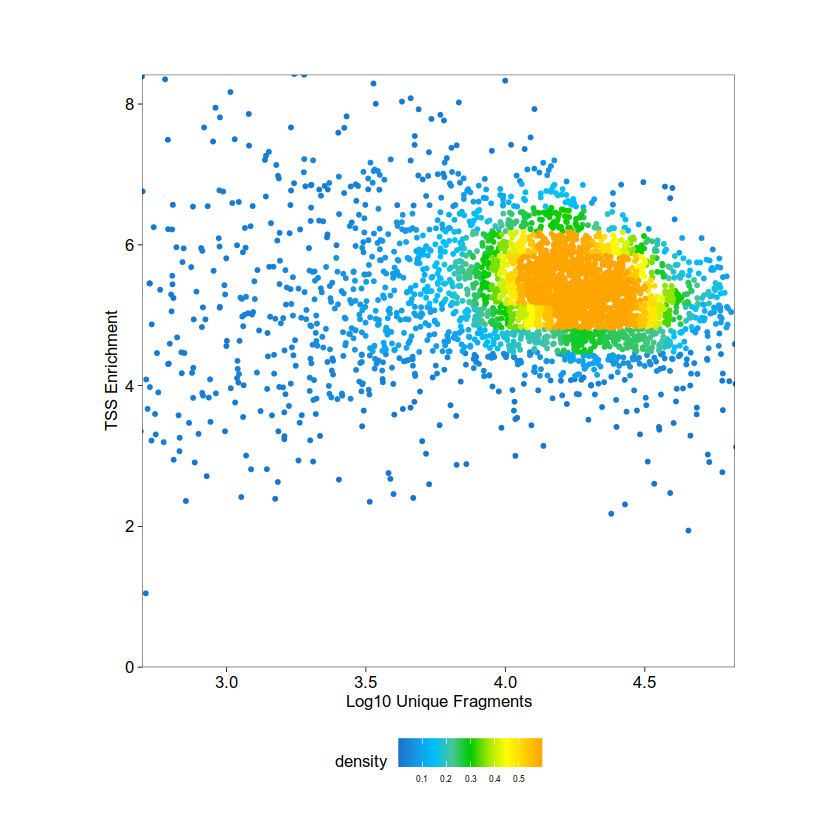

In [31]:
df_edge<-glio_core2@meta.data[,c('nCount_ATAC','TSS.enrichment','nucleosome_signal','TSS.percentile')]
df_edge$nFrags<-log10(df_edge$nCount_ATAC)
colnames(df_edge)<-replace(x=colnames(df_edge),list=c(colnames(df_edge)=='nFrags'),values='log10(nFrags)')
ggPoint(x=df_edge[,5],y=df_edge[,2],colorDensity = T,     
    continuousSet = "sambaNight",
    xlabel = "Log10 Unique Fragments",
    ylabel = "TSS Enrichment",
    xlim = c(log10(500), quantile(df_edge[,5], probs = 0.99)),
    ylim = c(0, quantile(df_edge[,2], probs = 0.99))
        )

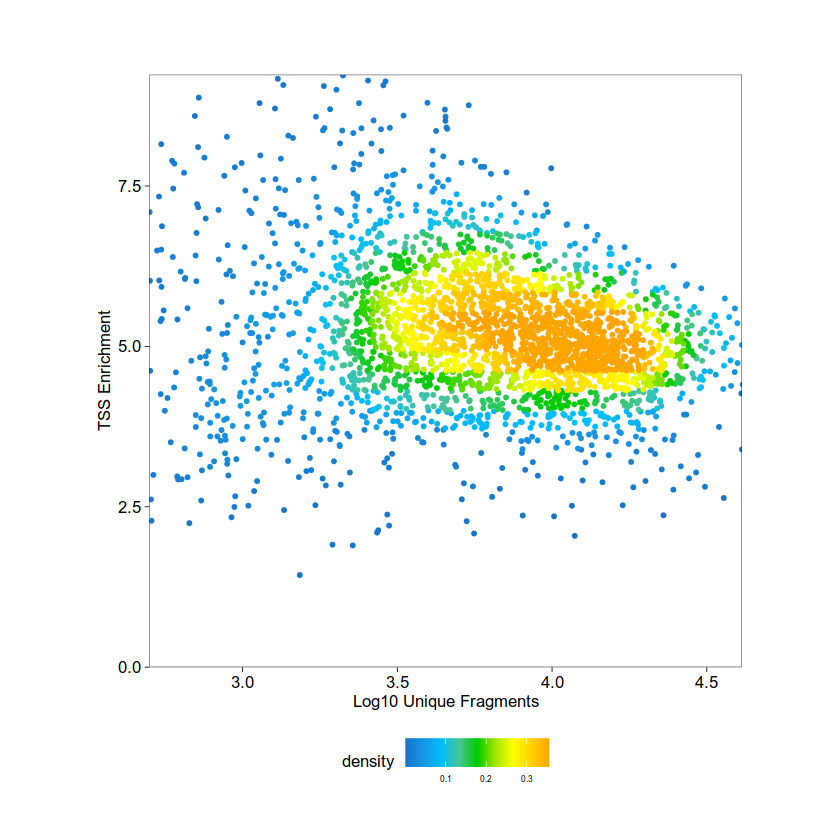

In [32]:
df_edge<-glio_core3@meta.data[,c('nCount_ATAC','TSS.enrichment','nucleosome_signal','TSS.percentile')]
df_edge$nFrags<-log10(df_edge$nCount_ATAC)
colnames(df_edge)<-replace(x=colnames(df_edge),list=c(colnames(df_edge)=='nFrags'),values='log10(nFrags)')
ggPoint(x=df_edge[,5],y=df_edge[,2],colorDensity = T,     
    continuousSet = "sambaNight",
    xlabel = "Log10 Unique Fragments",
    ylabel = "TSS Enrichment",
    xlim = c(log10(500), quantile(df_edge[,5], probs = 0.99)),
    ylim = c(0, quantile(df_edge[,2], probs = 0.99))
        )

In [33]:
glio_core1<- subset(
  x = glio_core1,
    subset = nCount_ATAC > 1000 &
    nucleosome_signal < 2 &
    TSS.percentile > 0.15 &
    TSS.enrichment > 2 

)
glio_core2<- subset(
  x = glio_core2,
    subset = nCount_ATAC > 1000 &
    nucleosome_signal < 2 &
    TSS.percentile > 0.15 &
    TSS.enrichment > 2 

)
glio_core3<- subset(
  x = glio_core3,
    subset = nCount_ATAC > 1000 &
    nucleosome_signal < 2 &
    TSS.percentile > 0.15 &
    TSS.enrichment > 2 

)
glio_edge1<- subset(
  x = glio_edge1,
    subset = nCount_ATAC > 1000 &
    nucleosome_signal < 2 &
    TSS.percentile > 0.15 &
    TSS.enrichment > 2 

)
glio_edge2<- subset(
  x = glio_edge2,
    subset = nCount_ATAC > 1000 &
    nucleosome_signal < 2 &
    TSS.percentile > 0.15 &
    TSS.enrichment > 2 

)
glio_edge3<- subset(
  x = glio_edge3,
    subset = nCount_ATAC > 1000 &
    nucleosome_signal < 2 &
    TSS.percentile > 0.15 &
    TSS.enrichment > 2 

)

In [34]:
glio_core1
glio_core2
glio_core3
glio_edge1
glio_edge2
glio_edge3

An object of class Seurat 
382506 features across 4468 samples within 3 assays 
Active assay: ATAC_common_peak (213000 features, 0 variable features)
 2 other assays present: RNA, ATAC

An object of class Seurat 
344833 features across 2868 samples within 3 assays 
Active assay: ATAC_common_peak (213000 features, 0 variable features)
 2 other assays present: RNA, ATAC

An object of class Seurat 
320733 features across 2488 samples within 3 assays 
Active assay: ATAC_common_peak (213000 features, 0 variable features)
 2 other assays present: RNA, ATAC

An object of class Seurat 
431464 features across 8510 samples within 3 assays 
Active assay: ATAC_common_peak (213000 features, 0 variable features)
 2 other assays present: RNA, ATAC

An object of class Seurat 
349524 features across 3100 samples within 3 assays 
Active assay: ATAC_common_peak (213000 features, 0 variable features)
 2 other assays present: RNA, ATAC

An object of class Seurat 
324963 features across 1307 samples within 3 assays 
Active assay: ATAC_common_peak (213000 features, 0 variable features)
 2 other assays present: RNA, ATAC

In [35]:
core1.downsample = subset(glio_core1, cells = sample(Cells(glio_core1), 4468))

core2.downsample = subset(glio_core2, cells = sample(Cells(glio_core2), 2868))
edge1.downsample = subset(glio_edge1, cells = sample(Cells(glio_edge1), 8510))

edge2.downsample = subset(glio_edge2, cells = sample(Cells(glio_edge2), 3100))
edge3.downsample = subset(glio_edge3, cells = sample(Cells(glio_edge3), 1307))
core3.downsample = subset(glio_core3, cells = sample(Cells(glio_core3), 2488))


In [36]:
core1.downsample[["ATAC"]]<-NULL
core2.downsample[["ATAC"]]<-NULL
core3.downsample[["ATAC"]]<-NULL
edge1.downsample[["ATAC"]]<-NULL
edge2.downsample[["ATAC"]]<-NULL
edge3.downsample[["ATAC"]]<-NULL

In [37]:
glio<-merge(core1.downsample,c(core2.downsample,core3.downsample,edge1.downsample,edge2.downsample,edge3.downsample),add.cell.ids=c("core1","core2","core3","edge1","edge2","edge3"))

save(glio,file="merged_core_edge.RData")

In [38]:
glio

An object of class Seurat 
249601 features across 22741 samples within 2 assays 
Active assay: ATAC_common_peak (213000 features, 0 variable features)
 1 other assay present: RNA

In [39]:
save(glio,file="merged_core_edge_all.RData")

In [1]:
load("merged_core_edge_all.RData")

In [41]:
DefaultAssay(glio) <- "RNA"

In [42]:
#mito
DefaultAssay(glio) <- "RNA"
total_counts_per_cell<-colSums(glio@assays$RNA@counts)
mito_gene<-rownames(glio)[grep("^MT-",rownames(glio@assays$RNA@counts))]
glio$percent_mito<-colSums(glio@assays$RNA@counts[mito_gene,])/total_counts_per_cell

In [43]:
glio<-PercentageFeatureSet(glio,"^RP[SL]",col.name="percent_ribo")


In [44]:
#add number of genes per UMI for each cell to metadata
glio$log10GenesPerUMI<-log10(glio$nFeature_RNA)/log10(glio$nCount_RNA)

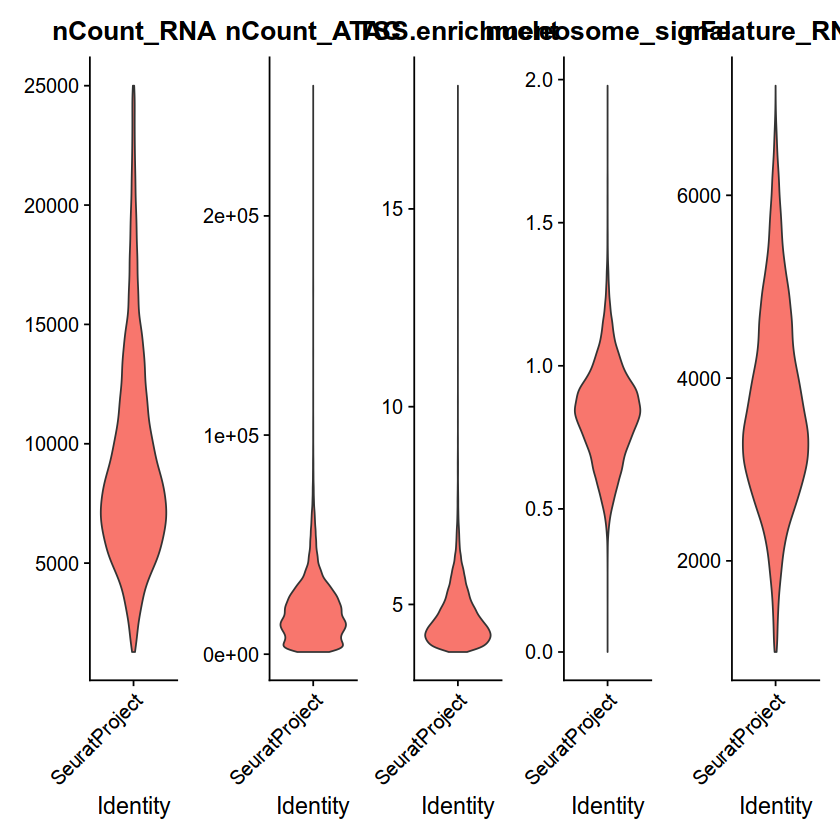

In [45]:
VlnPlot(
  object = glio,
  features = c("nCount_RNA", "nCount_ATAC", "TSS.enrichment", "nucleosome_signal","nFeature_RNA"),
  ncol = 5,
  pt.size = 0
)

In [46]:
quantile(glio@meta.data$TSS.enrichment)

0%       25%       50%       75%      100% 
 3.798004  4.192844  4.528805  5.074047 18.115218

In [47]:
###cell cycle
cc_file <- getURL("https://raw.githubusercontent.com/hbc/tinyatlas/master/cell_cycle/Homo_sapiens.csv")
cell_cycle_genes <- read.csv(text = cc_file)
ah <- AnnotationHub()
ahDb <- query(ah,
              pattern = c("Homo sapiens", "EnsDb"),
              ignore.case = TRUE)
id <- ahDb %>%
        mcols() %>%
        rownames() %>%
        tail(n = 1)
edb <- ah[[id]]
annotations <- genes(edb,
                     return.type = "data.frame")
annotations <- annotations %>%
        dplyr::select(gene_id, gene_name, seq_name, gene_biotype, description)
# Get gene names for Ensembl IDs for each gene
cell_cycle_markers <- dplyr::left_join(cell_cycle_genes, annotations, by = c("geneID" = "gene_id"))

# Acquire the S phase genes
s_genes <- cell_cycle_markers %>%
        dplyr::filter(phase == "S") %>%
        pull("gene_name")

# Acquire the G2M phase genes
g2m_genes <- cell_cycle_markers %>%
        dplyr::filter(phase == "G2/M") %>%
        pull("gene_name")

snapshotDate(): 2022-10-31

loading from cache



In [48]:
#RNA analysis
DefaultAssay(glio) <- "RNA"


In [49]:
ribo.genes<- c(rownames(glio@assays$RNA@data)[grep("^RP[1:9]",rownames(glio@assays$RNA@data))],rownames(glio@assays$RNA@data)[grep("^RP[L,S]",rownames(glio@assays$RNA@data))])

Warning message in asMethod(object):
"sparse->dense coercion: allocating vector of size 6.2 GiB"


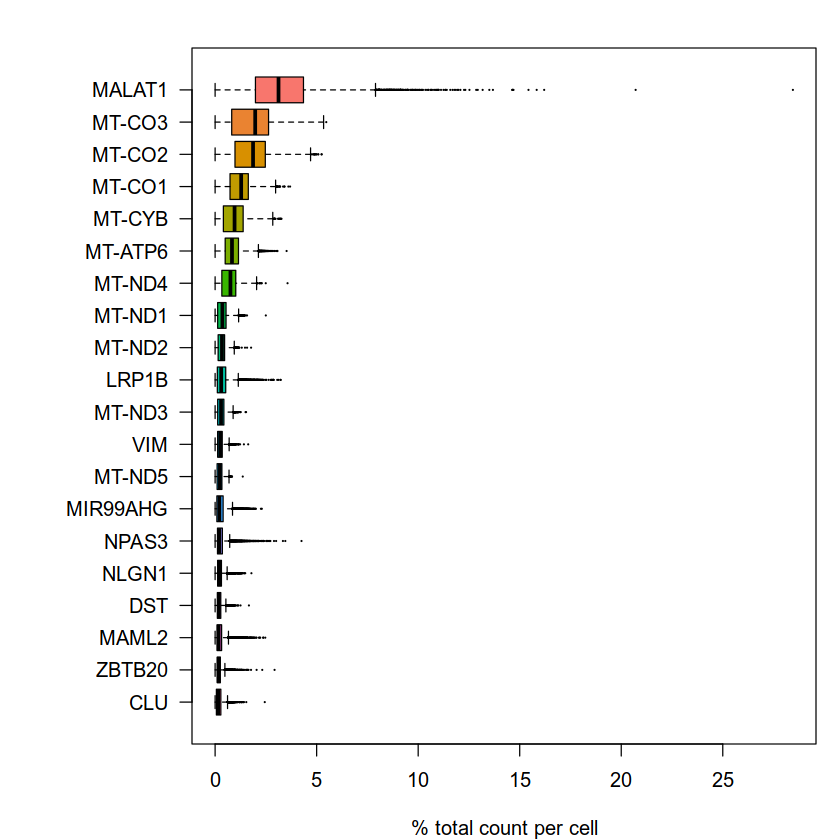

In [50]:
#gene expressiom
par(mar = c(4, 8, 2, 1))
C <- glio@assays$RNA@counts
C <- Matrix::t(Matrix::t(C)/Matrix::colSums(C)) * 100
most_expressed <- order(apply(C, 1, median), decreasing = T)[20:1]
boxplot(as.matrix(t(C[most_expressed, ])), cex = 0.1, las = 1, xlab = "% total count per cell",
    col = (scales::hue_pal())(20)[20:1], horizontal = TRUE)

In [51]:
glio<-NormalizeData(glio, normalization.method = "LogNormalize", scale.factor = 10000)
glio<-FindVariableFeatures(glio,selection.method="vst",nfeatures=6000,verbose=T)
glio <- CellCycleScoring(glio, s.features = s_genes, g2m.features = g2m_genes, set.ident = TRUE)


In [52]:
mito.genes<- c(rownames(glio@assays$RNA@data)[grep("^MT",rownames(glio@assays$RNA@data))])
removed.genes<-c(ribo.genes,"MALAT1",mito.genes)

In [53]:
glio$CC.Difference <- glio$S.Score - glio$G2M.Score
glio<-ScaleData(glio,vars.to.regress=c("CC.Difference","percent_mito","nCount_RNA"))
#glio<-RunPCA(glio,features = rownames(glio@assays$RNA@data)[!rownames(glio@assays$RNA@data) %in% removed.genes],npcs=100,nfeatures.print=10)
glio<-RunPCA(glio,features = VariableFeatures(glio)[!VariableFeatures(glio)%in% removed.genes],npcs=100,nfeatures.print=10)


Regressing out CC.Difference, percent_mito, nCount_RNA

Centering and scaling data matrix

PC_ 1 
Positive:  IGFBP7, COL21A1, AHR, EFEMP1, COL1A2, PRICKLE1, ITGBL1, CALD1, PALLD, ANK2 
Negative:  PTN, NCAM1, LHFPL3, PTPRZ1, NAV2, C1orf61, NUP107, NOVA1, SNTG1, MARCKSL1 
PC_ 2 
Positive:  XIST, LINC02315, EYA4, KCNH7, ADGRV1, MIR3681HG, SORCS1, TSIX, RMST, A2M 
Negative:  NLGN4Y, NUP107, MDM2, VCAN, SLC35E3, MDGA2, LANCL2, COL20A1, DNM3, MIR924HG 
PC_ 3 
Positive:  DIAPH3, BRIP1, POLQ, ANLN, BRCA2, RRM2, NCAPG2, CENPK, NCAPG, PRIM2 
Negative:  MAP2, GRIA2, LINC00609, SOX6, PDE4B, CHL1, PTPRZ1, GAD1, AKAP6, MDGA2 
PC_ 4 
Positive:  NFIA, NEAT1, FAT3, FIGN, XIST, IGFBP7, TRPM3, ITPR2, NIBAN1, EFEMP1 
Negative:  NEFL, TGFBI, COL6A2, JAKMIP2-AS1, CACNA1A, SLCO5A1, PPFIA2, COL6A1, AL117329.1, AC092957.1 
PC_ 5 
Positive:  MEOX2, AGMO, MDGA2, TENM1, GRIA2, CHL1, SDK1, PLCB4, VOPP1, IGF2BP3 
Negative:  COL19A1, TFPI2, ID1, LINC02742, NECTIN3, LINC02755, OXR1, CADPS, DACH1, GAP43 



In [54]:
glio<-RunTSNE(glio,dims=1:30)
glio<-RunUMAP(glio,dims=1:30)


Warning message:
"The default method for RunUMAP has changed from calling Python UMAP via reticulate to the R-native UWOT using the cosine metric
To use Python UMAP via reticulate, set umap.method to 'umap-learn' and metric to 'correlation'
This message will be shown once per session"
12:55:54 UMAP embedding parameters a = 0.9922 b = 1.112

12:55:54 Read 22741 rows and found 30 numeric columns

12:55:54 Using Annoy for neighbor search, n_neighbors = 30

12:55:54 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

12:55:57 Writing NN index file to temp file /tmp/Rtmp8SOW8s/file147a72d7ce24

12:55:57 Searching Annoy index using 70 threads, search_k = 3000

12:55:57 Annoy recall = 100%

12:56:00 Commencing smooth kNN distance calibration using 70 threads
 with target n_neighb

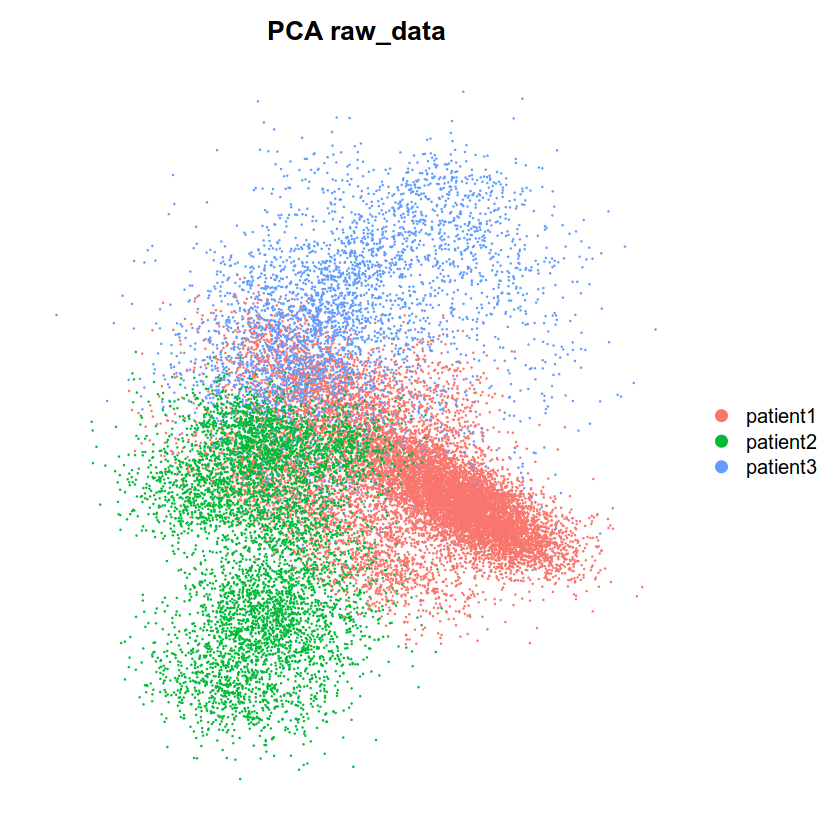

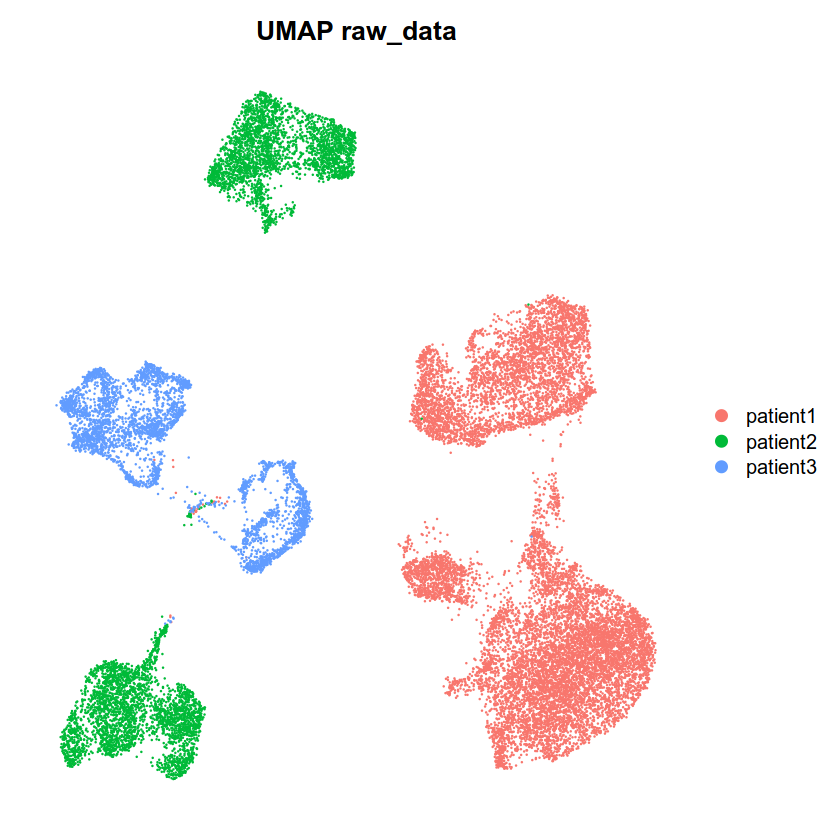

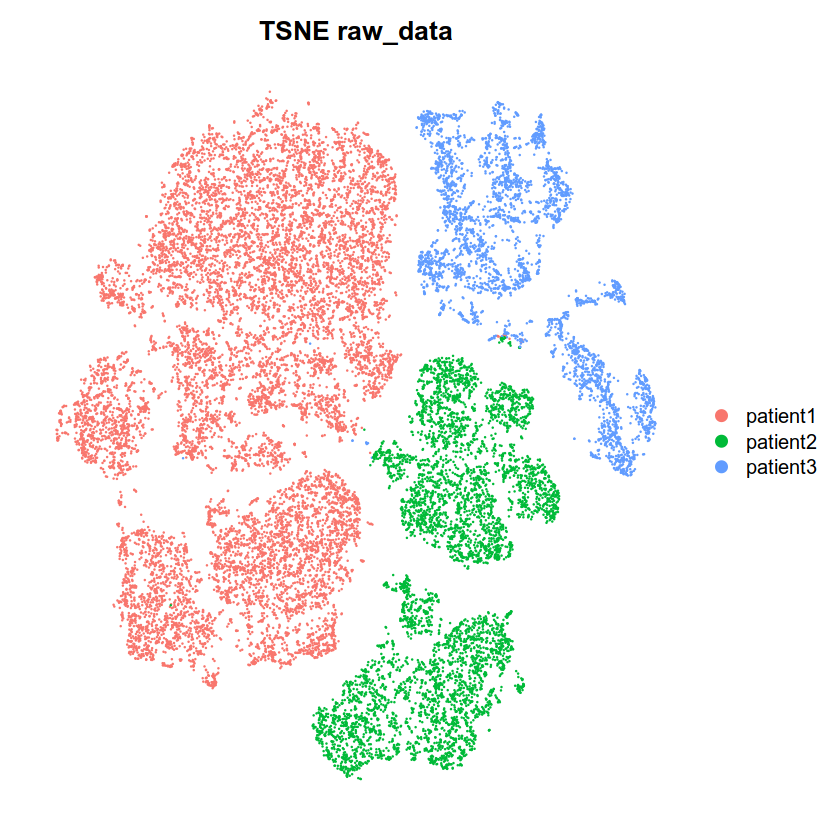

In [55]:
DimPlot(glio,reduction="pca",group.by="patient")+NoAxes()+ggtitle("PCA raw_data")
DimPlot(glio,reduction="umap",group.by="patient")+NoAxes()+ggtitle("UMAP raw_data")
DimPlot(glio,reduction="tsne",group.by="patient")+NoAxes()+ggtitle("TSNE raw_data")


In [56]:
#data integration
DefaultAssay(glio) <- "RNA"
glio.list <- SplitObject(glio, split.by = "patient")

In [57]:
glio.anchors <- FindIntegrationAnchors(object.list = glio.list, dims = 1:30,
    reduction = "cca")

Computing 2000 integration features

Scaling features for provided objects

Finding all pairwise anchors

Running CCA

Merging objects

Finding neighborhoods

Finding anchors

	Found 21590 anchors

Filtering anchors

	Retained 4358 anchors

Running CCA

Merging objects

Finding neighborhoods

Finding anchors

	Found 15015 anchors

Filtering anchors

	Retained 3031 anchors

Running CCA

Merging objects

Finding neighborhoods

Finding anchors

	Found 12787 anchors

Filtering anchors

	Retained 4629 anchors



In [58]:
glio.int <- IntegrateData(anchorset = glio.anchors, dims = 1:30, new.assay.name = "CCA_RNA")


Merging dataset 3 into 2

Extracting anchors for merged samples

Finding integration vectors

Finding integration vector weights

Integrating data

Warning message:
"Keys should be one or more alphanumeric characters followed by an underscore, setting key from cca_rna_ to ccarna_"
Warning message:
"Keys should be one or more alphanumeric characters followed by an underscore, setting key from cca_rna_ to ccarna_"
Merging dataset 2 3 into 1

Extracting anchors for merged samples

Finding integration vectors

Finding integration vector weights

Integrating data

Warning message:
"Keys should be one or more alphanumeric characters followed by an underscore, setting key from cca_rna_ to ccarna_"
Warning message:
"Keys should be one or more alphanumeric characters followed by an underscore, setting key from cca_rna_ to ccarna_"
Warning message:
"Keys should be one or more alphanumeric characters followed by an underscore, setting key from cca_rna_ to ccarna_"


In [59]:
# Run Dimensionality reduction on integrated space
glio.int <- ScaleData(glio.int,vars.to.regress=c("CC.Difference","percent_mito","nCount_RNA"), verbose = FALSE)
glio.int <- RunPCA(glio.int, npcs = 30, verbose = FALSE,reduction.name = "pca",reduction.key = "rnaPC_")
glio.int <- RunUMAP(glio.int, dims = 1:30,reduction.name = "rna.umap",reduction.key = "rnaUMAP_")

13:15:16 UMAP embedding parameters a = 0.9922 b = 1.112

13:15:16 Read 22741 rows and found 30 numeric columns

13:15:16 Using Annoy for neighbor search, n_neighbors = 30

13:15:16 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

13:15:18 Writing NN index file to temp file /tmp/Rtmp8SOW8s/file147a12f4b6f2

13:15:18 Searching Annoy index using 70 threads, search_k = 3000

13:15:18 Annoy recall = 100%

13:15:22 Commencing smooth kNN distance calibration using 70 threads
 with target n_neighbors = 30

13:15:26 Initializing from normalized Laplacian + noise (using irlba)

13:15:27 Commencing optimization for 200 epochs, with 1000418 positive edges

13:15:40 Optimization finished



In [60]:
#glio.int <- RunTSNE(glio.int, dims = 1:30)

In [61]:
library("cowplot")

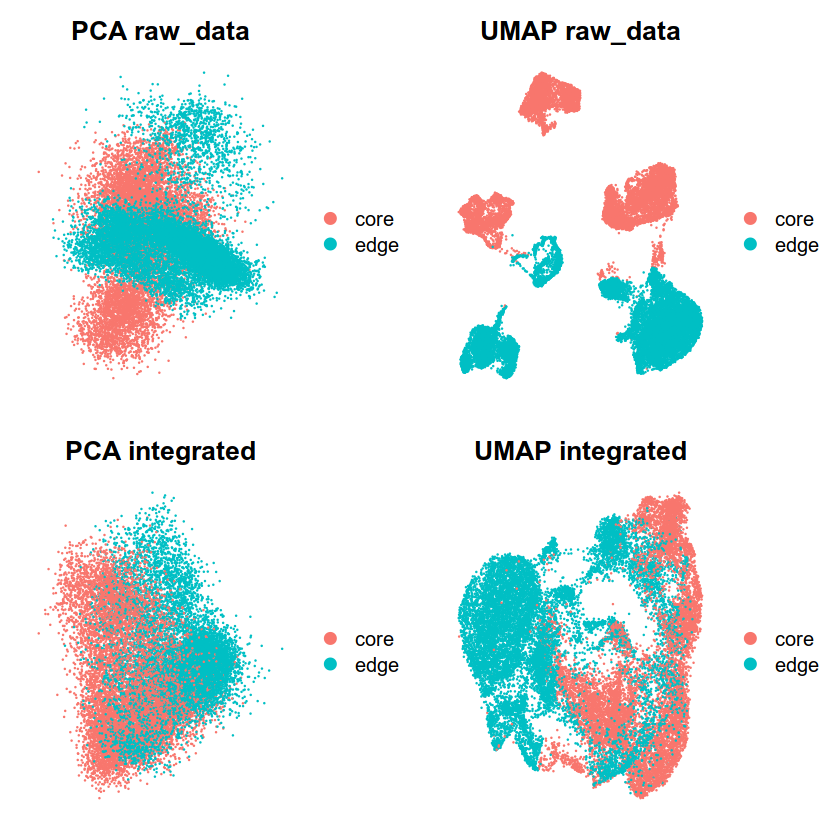

In [62]:
plot_grid(ncol = 2,
  DimPlot(glio, reduction = "pca", group.by = "type")+NoAxes()+ggtitle("PCA raw_data"),
#  DimPlot(glio, reduction = "tsne", group.by = "type")+NoAxes()+ggtitle("tSNE raw_data"),
  DimPlot(glio, reduction = "umap", group.by = "type")+NoAxes()+ggtitle("UMAP raw_data"),
  
  DimPlot(glio.int, reduction = "pca", group.by = "type")+NoAxes()+ggtitle("PCA integrated"),
#  DimPlot(glio.int, reduction = "tsne", group.by = "type")+NoAxes()+ggtitle("tSNE integrated"),
  DimPlot(glio.int, reduction = "rna.umap", group.by = "type")+NoAxes()+ggtitle("UMAP integrated")
)

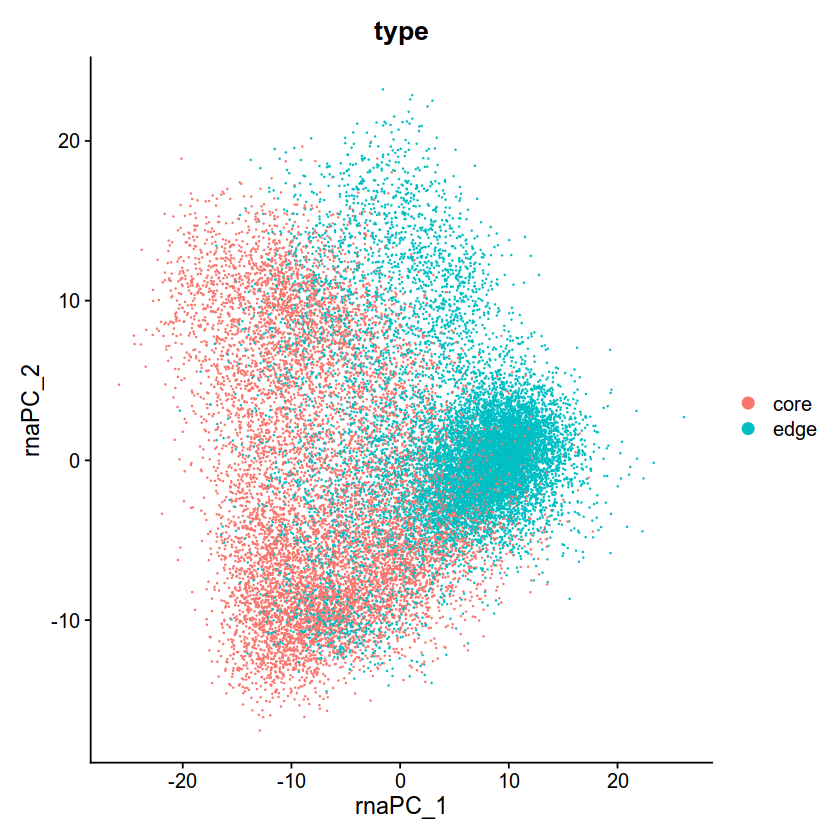

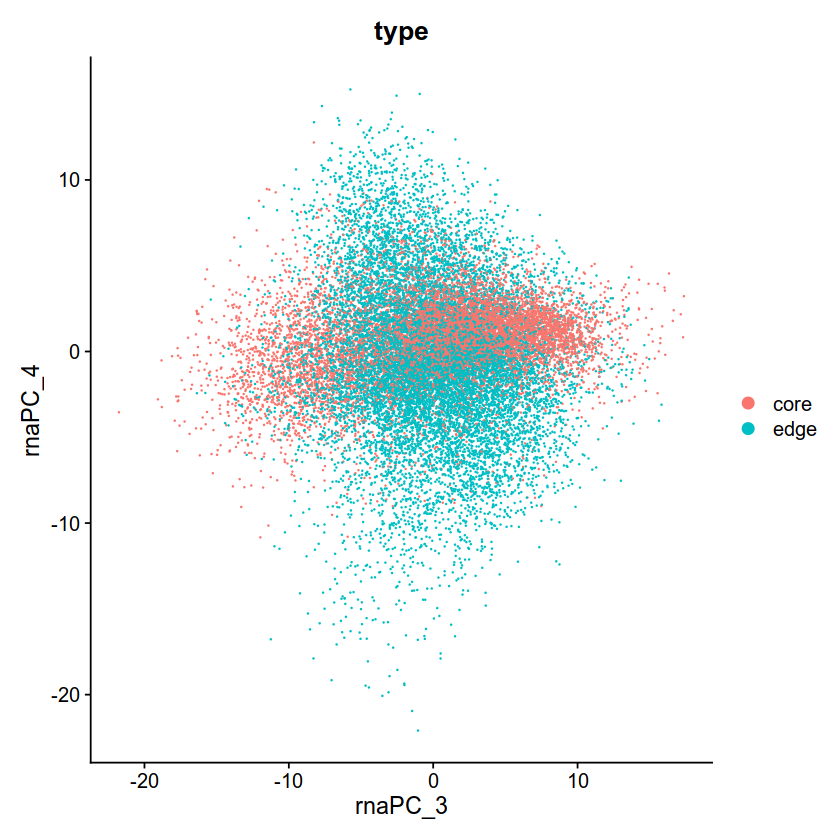

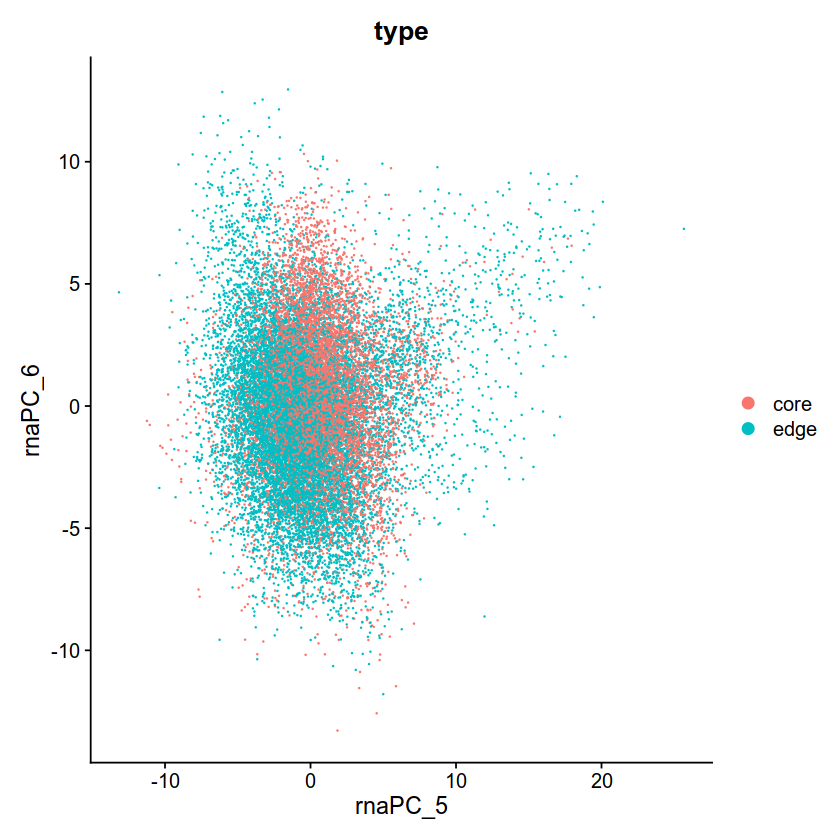

In [63]:
DimPlot(glio.int, reduction = "pca", group.by = "type",dims=1:2)
DimPlot(glio.int, reduction = "pca", group.by = "type",dims=3:4)
DimPlot(glio.int, reduction = "pca", group.by = "type",dims=5:6)


In [64]:
pc.int2 <- data.frame(glio.int@reductions$pca@cell.embeddings)

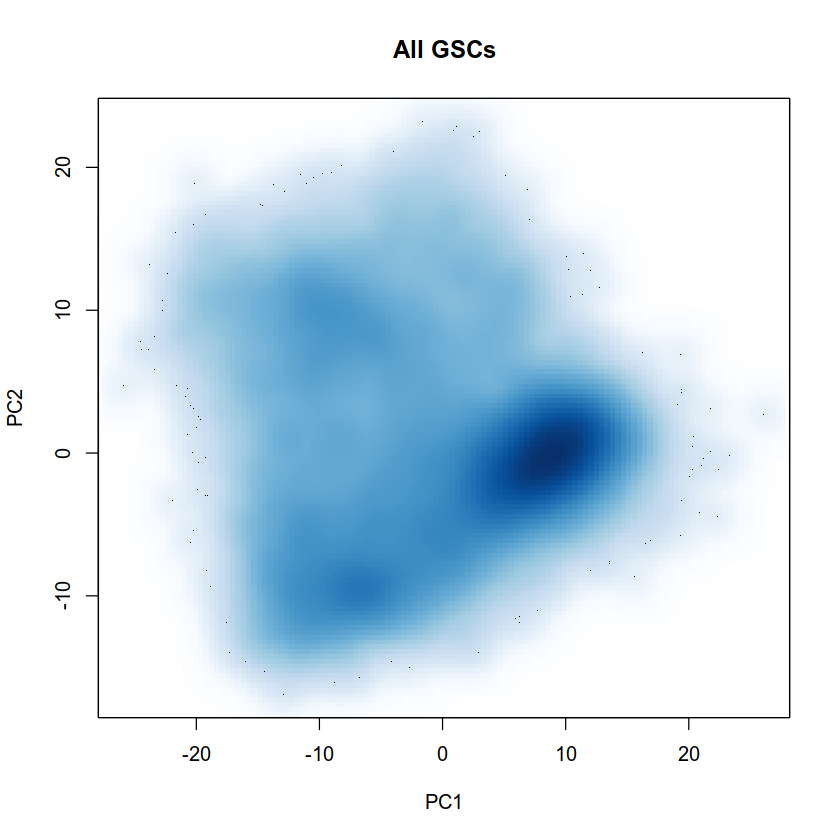

In [65]:
smoothScatter(pc.int2$rnaPC_1, 
     pc.int2$rnaPC_2, 
     cex = 0.3, 
     xlab = "PC1",
     ylab = "PC2",
     main = "All GSCs"
    )


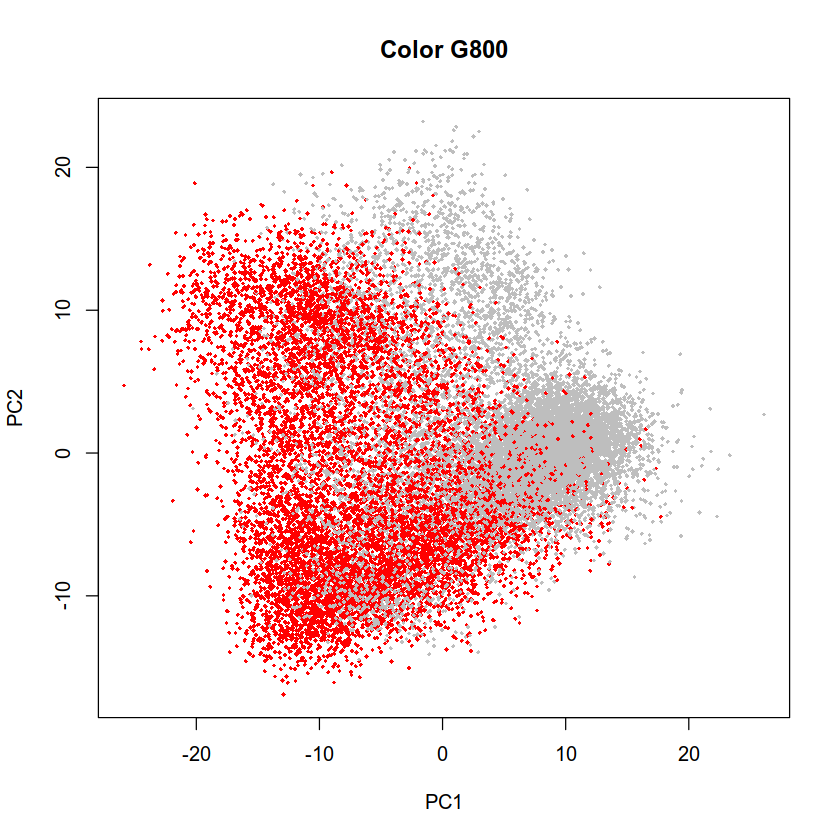

In [66]:
plot(pc.int2$rnaPC_1, 
     pc.int2$rnaPC_2, 
     cex = 0.5, 
     xlab = "PC1",
     ylab = "PC2",
     main = "Color G800",
     col= ifelse(grepl("core", rownames(pc.int2)), "red", "grey"),
     pch = 18
    )

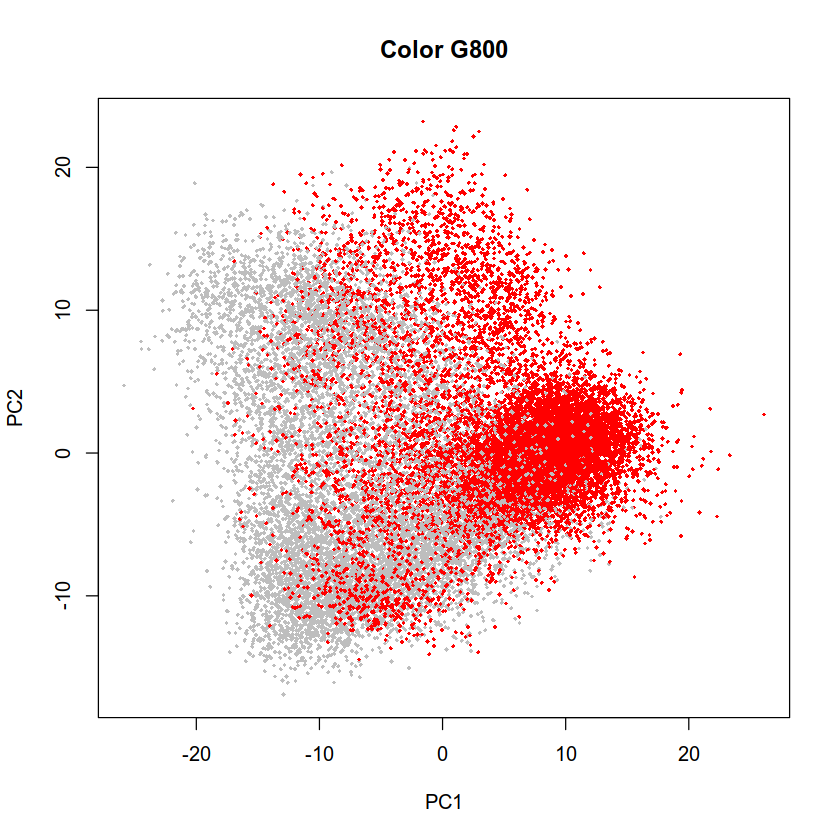

In [67]:
plot(pc.int2$rnaPC_1, 
     pc.int2$rnaPC_2, 
     cex = 0.5, 
     xlab = "PC1",
     ylab = "PC2",
     main = "Color G800",
     col= ifelse(grepl("edge", rownames(pc.int2)), "red", "grey"),
     pch = 18
    )

In [68]:
nGenes<-100
pca.int2.genes <- data.frame(glio.int@reductions$pca@feature.loadings)

In [69]:
top <- rownames(pca.int2.genes[order(pca.int2.genes$rnaPC_1, decreasing = TRUE), ])[1:nGenes]
bottome<-rownames(pca.int2.genes[order(pca.int2.genes$rnaPC_1,decreasing =F),])[1:nGenes]

In [70]:
glio.int$sample<-matrix(unlist(strsplit(names(glio.int$orig.ident),"_")),ncol=2,byrow=T)[,1]

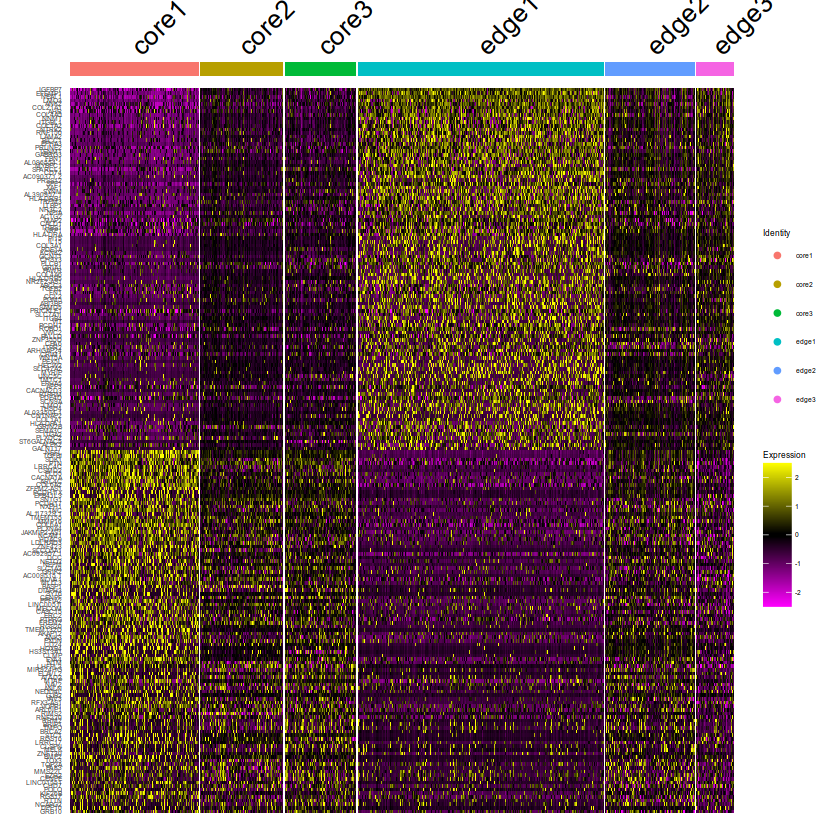

In [71]:
DoHeatmap(glio.int, features = as.character(c(top,bottome)), group.by = "sample")+theme(text = element_text(size = 5))

In [72]:
glio.int.matrix<-as.matrix(glio.int@assays$RNA@data)
cells_rankings <- AUCell_buildRankings(glio.int.matrix, nCores=30, plotStats=FALSE)
#calculate enrichment for the gene signatures
geneSets <- GeneSet(c(top), setName="geneSet1")
cells_AUC <- AUCell_calcAUC(geneSets, cells_rankings)

Warning message in asMethod(object):
"sparse->dense coercion: allocating vector of size 6.2 GiB"
Warning message in .AUCell_buildRankings(exprMat = exprMat, featureType = featureType, :
"nCores is no longer used. It will be deprecated in the next AUCell version."


,threshold,nCells
Global_k1,0.3443892,7412
L_k2,0.3254482,7774
R_k3,0.2590535,8488
minimumDens,0.2735247,8384


minimumDens 
  0.2735247

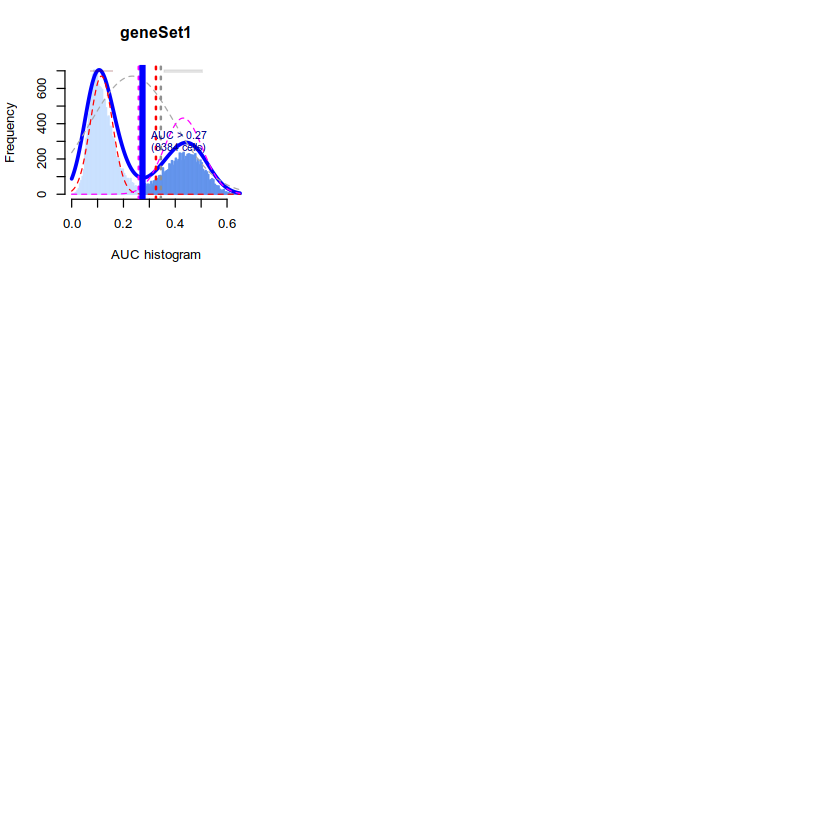

In [73]:
#Determine the cells with the given gene signatures or active gene sets
par(mfrow=c(3,3)) 
cells_assignment <- AUCell_exploreThresholds(cells_AUC, plotHist=TRUE, assign=TRUE) 
cells_assignment$geneSet1$aucThr$thresholds
cells_assignment$geneSet1$aucThr$selected

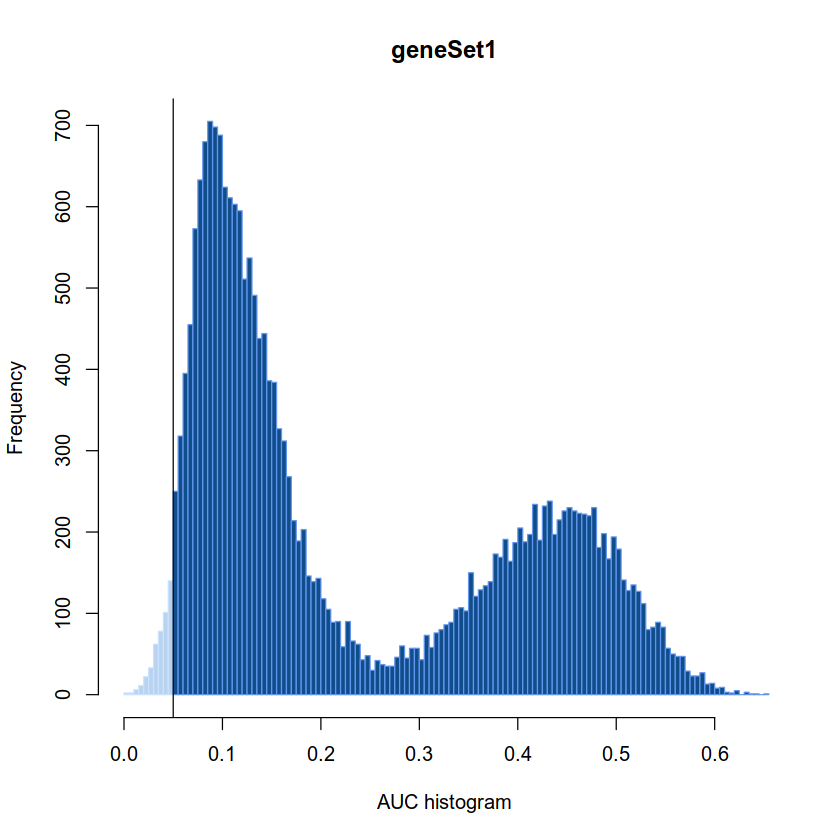

In [74]:
#ploting
geneSetName<-rownames(cells_AUC)[grep("geneSet1", rownames(cells_AUC))]
AUCell_plotHist(cells_AUC[geneSetName,], aucThr=0.05)
abline(v=0.05)

In [75]:
edge_AUC<-data.frame(t(as.data.frame(cells_AUC@assays@data$AUC)))
colnames(edge_AUC)<-"AUC"
#add AU#add AU"C
glio.int<-AddMetaData(glio.int,metadata=edge_AUC)
glio.int$edge_AUC = edge_AUC

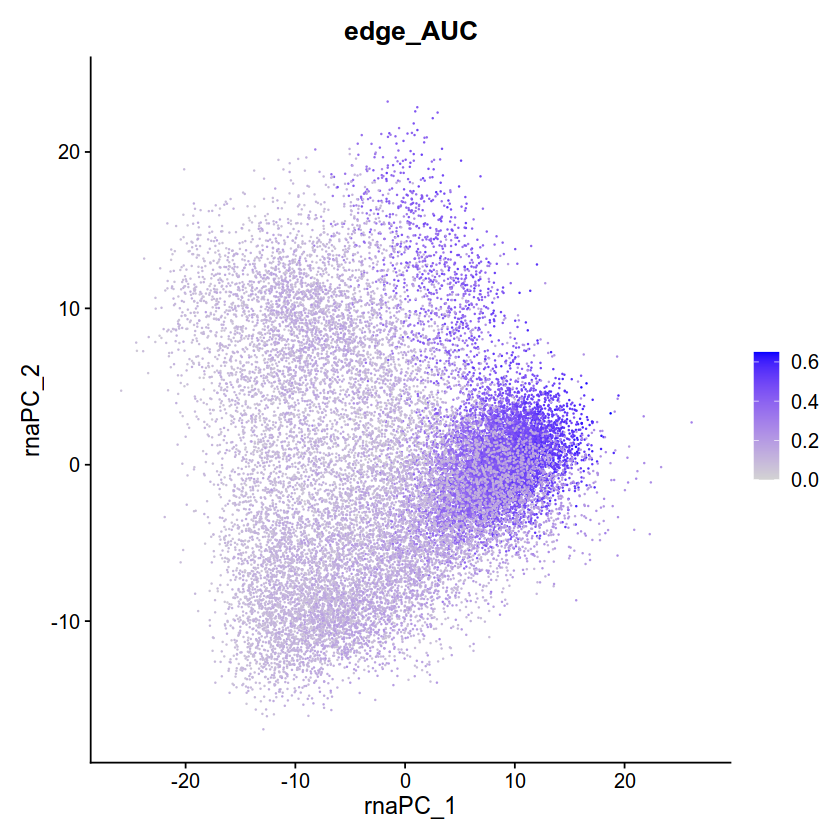

In [76]:
FeaturePlot(glio.int, features = 'edge_AUC',reduction="pca")

In [77]:
glio.int.matrix<-as.matrix(glio.int@assays$RNA@data)
cells_rankings <- AUCell_buildRankings(glio.int.matrix, nCores=30, plotStats=FALSE)
#calculate enrichment for the gene signatures
geneSets <- GeneSet(c(bottome), setName="geneSet1")
cells_AUC <- AUCell_calcAUC(geneSets, cells_rankings)

Warning message in asMethod(object):
"sparse->dense coercion: allocating vector of size 6.2 GiB"
Warning message in .AUCell_buildRankings(exprMat = exprMat, featureType = featureType, :
"nCores is no longer used. It will be deprecated in the next AUCell version."


,threshold,nCells
Global_k1,0.2767255,5125
L_k2,0.1578600,13915
R_k3,0.2575824,6149
minimumDens,0.1345721,14703


minimumDens 
  0.1345721

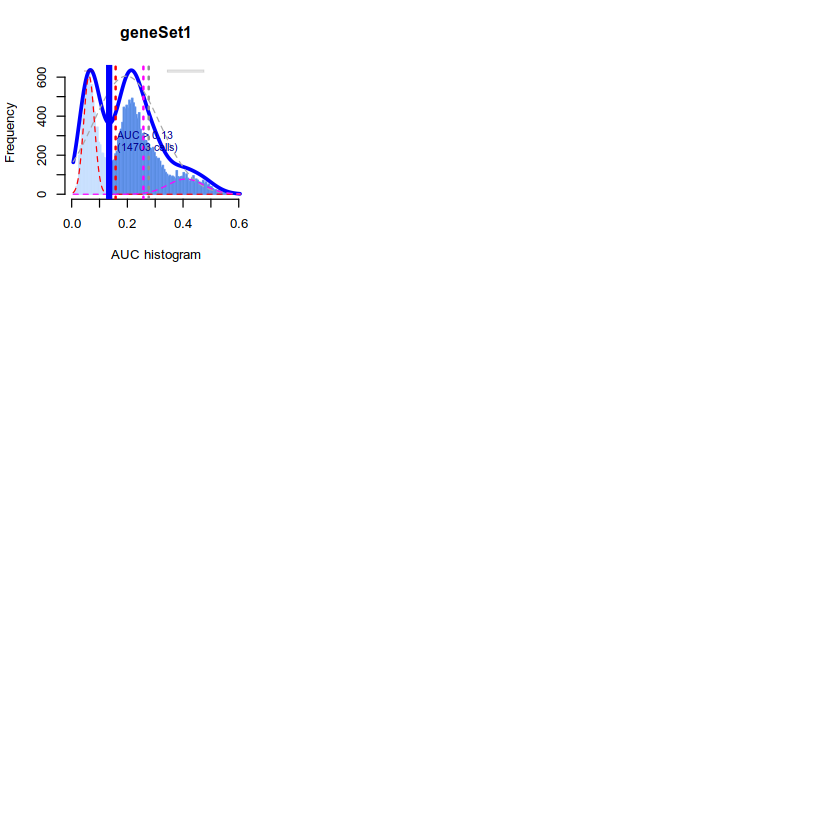

In [78]:
#Determine the cells with the given gene signatures or active gene sets
par(mfrow=c(3,3)) 
cells_assignment <- AUCell_exploreThresholds(cells_AUC, plotHist=TRUE, assign=TRUE) 
cells_assignment$geneSet1$aucThr$thresholds
cells_assignment$geneSet1$aucThr$selected

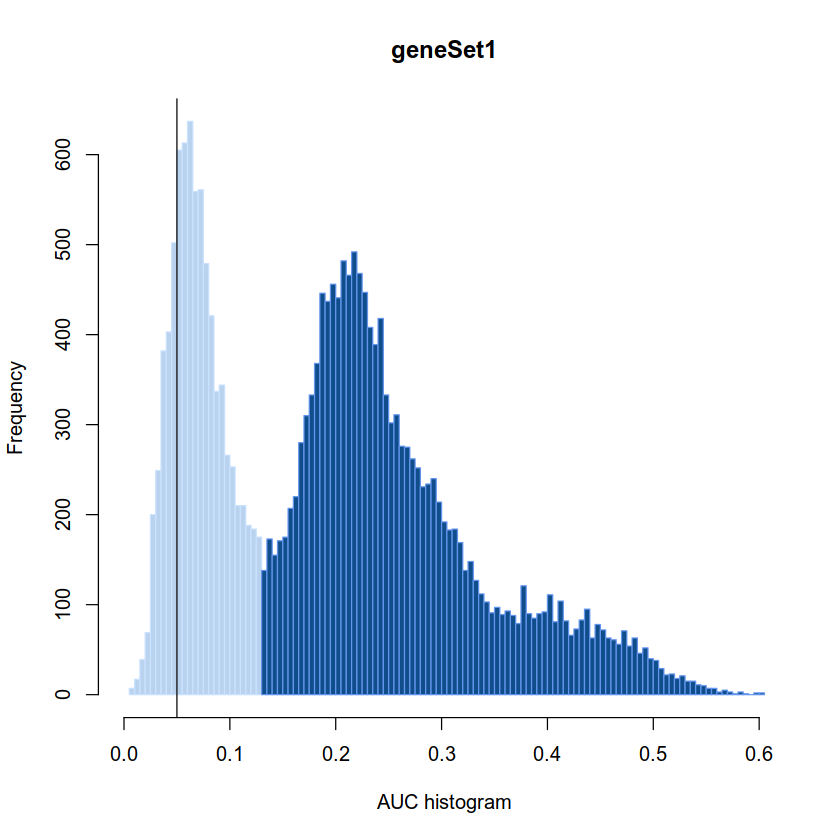

In [79]:
#ploting
geneSetName<-rownames(cells_AUC)[grep("geneSet1", rownames(cells_AUC))]
AUCell_plotHist(cells_AUC[geneSetName,], aucThr=0.13)
abline(v=0.05)

In [80]:
core_AUC<-data.frame(t(as.data.frame(cells_AUC@assays@data$AUC)))
colnames(core_AUC)<-"AUC"
#add AU#add AU"C
glio.int<-AddMetaData(glio.int,metadata=core_AUC)
glio.int$core_AUC = core_AUC

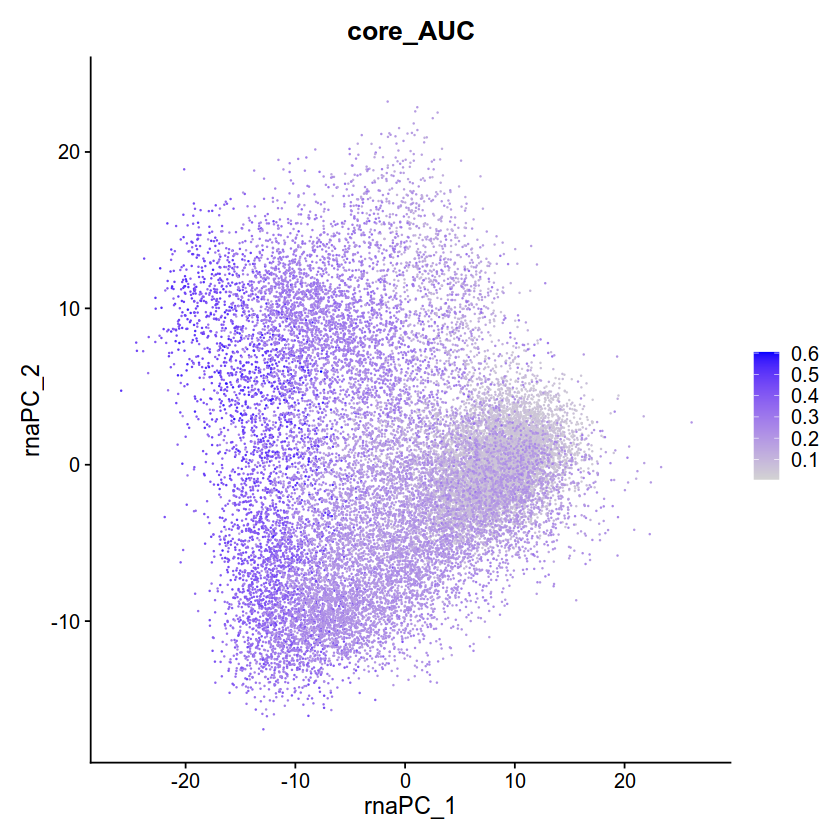

In [81]:
FeaturePlot(glio.int, features = 'core_AUC',reduction="pca")

In [84]:
DefaultAssay(glio.int) <- "ATAC_common_peak"
glio.int <- RunTFIDF(glio.int)
glio.int <- FindTopFeatures(glio.int, min.cutoff = 20)
glio.int <- RunSVD(glio.int)
glio.int <- RunUMAP(glio.int, reduction = 'lsi', dims = 2:50)

Performing TF-IDF normalization

Running SVD

Scaling cell embeddings

13:30:56 UMAP embedding parameters a = 0.9922 b = 1.112

13:30:56 Read 22741 rows and found 49 numeric columns

13:30:56 Using Annoy for neighbor search, n_neighbors = 30

13:30:56 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

13:30:59 Writing NN index file to temp file /tmp/Rtmp8SOW8s/file147a358ac6eb

13:30:59 Searching Annoy index using 70 threads, search_k = 3000

13:30:59 Annoy recall = 100%

13:31:02 Commencing smooth kNN distance calibration using 70 threads
 with target n_neighbors = 30

13:31:06 Initializing from normalized Laplacian + noise (using irlba)

13:31:09 Commencing optimization for 200 epochs, with 926846 positive edges

13:31:21 Optimization finished



In [85]:
library(harmony)
DefaultAssay(glio.int) <- "ATAC_common_peak"
glio.int <- RunHarmony(object = glio.int, group.by.vars = 'patient', reduction = 'lsi', assay.use = 'ATAC_common_peak', project.dim = FALSE)
#glio.int <- RunUMAP(hm.integrated, dims = 1:30, reduction = 'harmony',reduction.key = 'atacUMAP_')


Harmony 1/10

Harmony 2/10

Harmony converged after 2 iterations



In [86]:
glio.int <- RunUMAP(glio.int, dims = 1:30, reduction = 'harmony',reduction.key = 'atacUMAP_')


13:31:52 UMAP embedding parameters a = 0.9922 b = 1.112

13:31:52 Read 22741 rows and found 30 numeric columns

13:31:52 Using Annoy for neighbor search, n_neighbors = 30

13:31:52 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

13:31:54 Writing NN index file to temp file /tmp/Rtmp8SOW8s/file147a5228bb63

13:31:54 Searching Annoy index using 70 threads, search_k = 3000

13:31:54 Annoy recall = 100%

13:31:57 Commencing smooth kNN distance calibration using 70 threads
 with target n_neighbors = 30

13:32:01 Initializing from normalized Laplacian + noise (using irlba)

13:32:02 Commencing optimization for 200 epochs, with 907126 positive edges

13:32:14 Optimization finished



In [87]:
glio.int

An object of class Seurat 
251601 features across 22741 samples within 3 assays 
Active assay: ATAC_common_peak (213000 features, 212787 variable features)
 2 other assays present: RNA, CCA_RNA
 5 dimensional reductions calculated: pca, rna.umap, lsi, umap, harmony

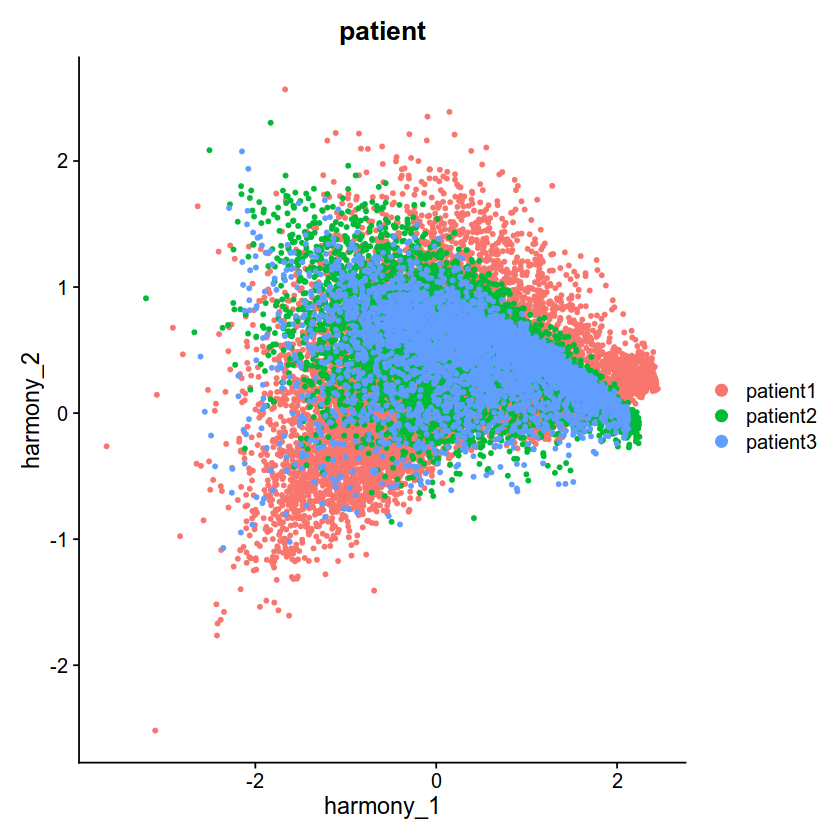

In [88]:
DimPlot(glio.int, group.by = 'patient', pt.size = 1,reduction="harmony")

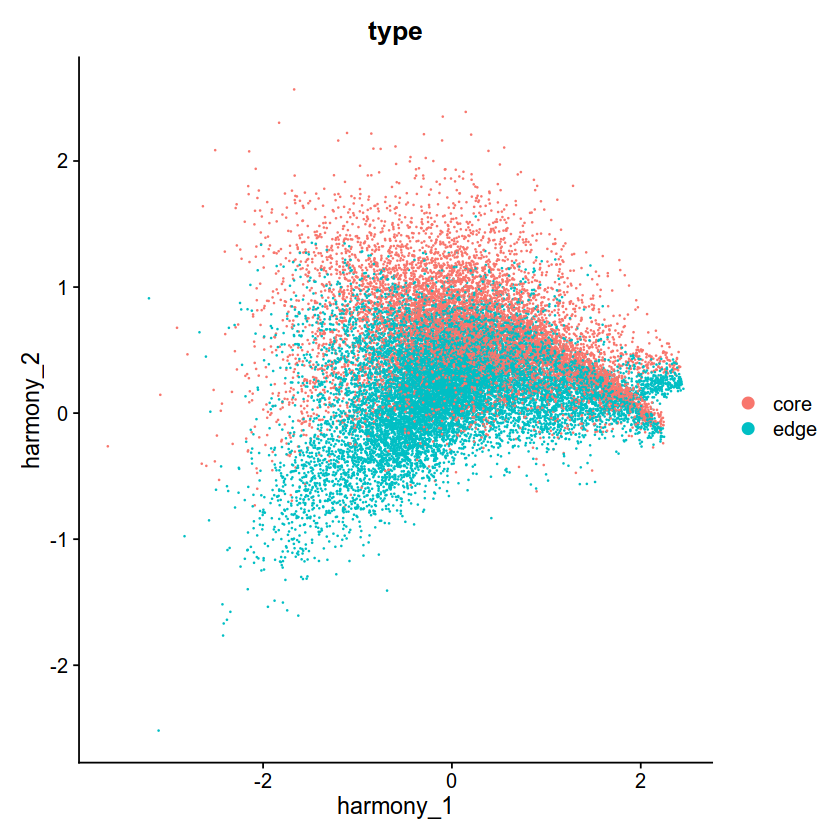

In [89]:
DimPlot(glio.int, group.by = 'type', pt.size = 0.1,reduction="harmony")

In [90]:
glio.int <- FindMultiModalNeighbors(glio.int, reduction.list = list("pca", "harmony"), dims.list = list(1:30, 2:50))
glio.int <- RunUMAP(glio.int, nn.name = "weighted.nn", reduction.name = "wnn.umap", reduction.key = "wnnUMAP_")
glio.int <- FindClusters(glio.int, graph.name = "wsnn", algorithm = 3, verbose = FALSE)

Calculating cell-specific modality weights

Finding 20 nearest neighbors for each modality.

Calculating kernel bandwidths

Finding multimodal neighbors

Constructing multimodal KNN graph

Constructing multimodal SNN graph

13:38:39 UMAP embedding parameters a = 0.9922 b = 1.112

13:38:42 Commencing smooth kNN distance calibration using 70 threads
 with target n_neighbors = 20

13:38:46 Initializing from normalized Laplacian + noise (using irlba)

13:38:47 Commencing optimization for 200 epochs, with 675414 positive edges

13:39:01 Optimization finished

Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-1') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.

In [91]:
glio.int <- FindSubCluster(glio.int, cluster = 3, graph.name = "wsnn", algorithm = 3)


Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 1789
Number of edges: 50373

Running smart local moving algorithm...
Maximum modularity in 10 random starts: 0.7635
Number of communities: 5
Elapsed time: 0 seconds


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-1') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


In [92]:
glio.int

An object of class Seurat 
251601 features across 22741 samples within 3 assays 
Active assay: ATAC_common_peak (213000 features, 212787 variable features)
 2 other assays present: RNA, CCA_RNA
 6 dimensional reductions calculated: pca, rna.umap, lsi, umap, harmony, wnn.umap

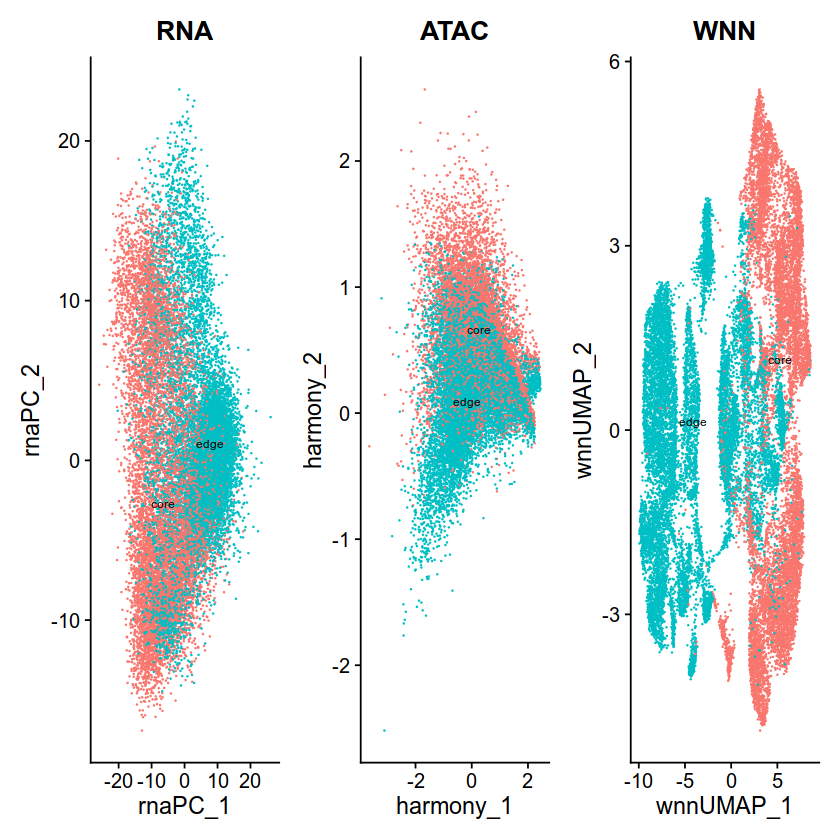

In [93]:
p1 <- DimPlot(glio.int, reduction = "pca", group.by = "type", label = TRUE, label.size = 2.5, repel = TRUE) + ggtitle("RNA")
p2 <- DimPlot(glio.int, reduction = "harmony", group.by = "type", label = TRUE, label.size = 2.5, repel = TRUE) + ggtitle("ATAC")
p3 <- DimPlot(glio.int, reduction = "wnn.umap", group.by = "type",label = TRUE, label.size = 2.5, repel = TRUE) + ggtitle("WNN")
p1 + p2 + p3 & NoLegend() & theme(plot.title = element_text(hjust = 0.5))

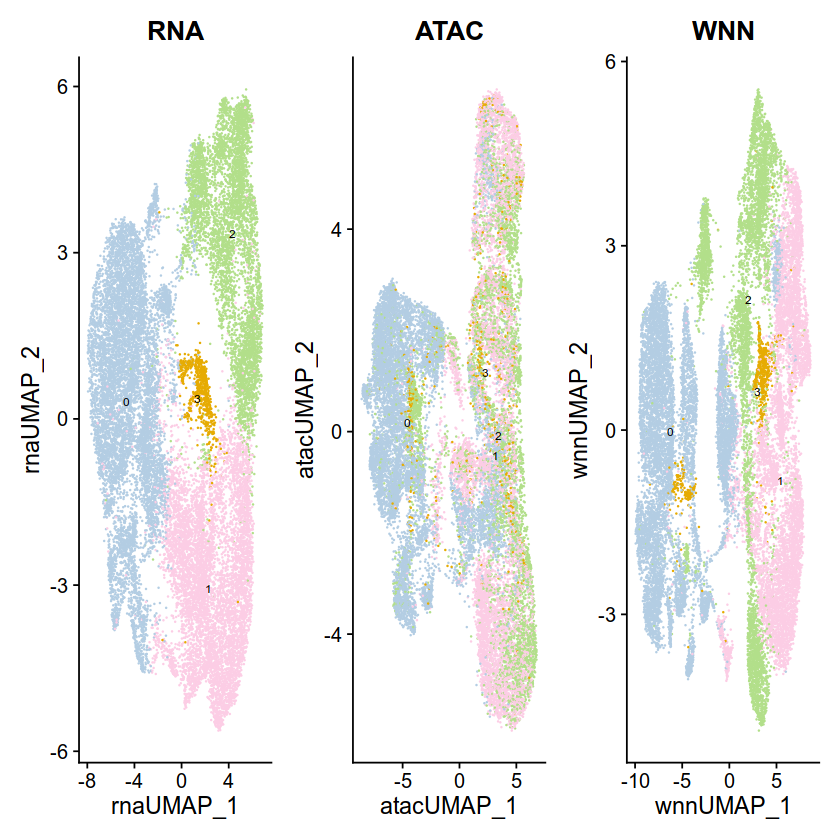

In [140]:
col<-c("#B3CDE3","#FCCDE5","#B2DF8A","#E6AB02","#FDBF6F")
p1 <- DimPlot(glio.int, reduction = "rna.umap", group.by = "CCA_RNA_snn_res.0.2", label = TRUE, label.size = 2.5, repel = TRUE,cols=col) + ggtitle("RNA")
p2 <- DimPlot(glio.int, reduction = "umap", group.by = "CCA_RNA_snn_res.0.2", label = TRUE, label.size = 2.5, repel = TRUE,cols=col) + ggtitle("ATAC")
p3 <- DimPlot(glio.int, reduction = "wnn.umap", group.by = "CCA_RNA_snn_res.0.2",label = TRUE, label.size = 2.5, repel = TRUE,cols=col) + ggtitle("WNN")
p1 + p2 + p3 & NoLegend() & theme(plot.title = element_text(hjust = 0.5))

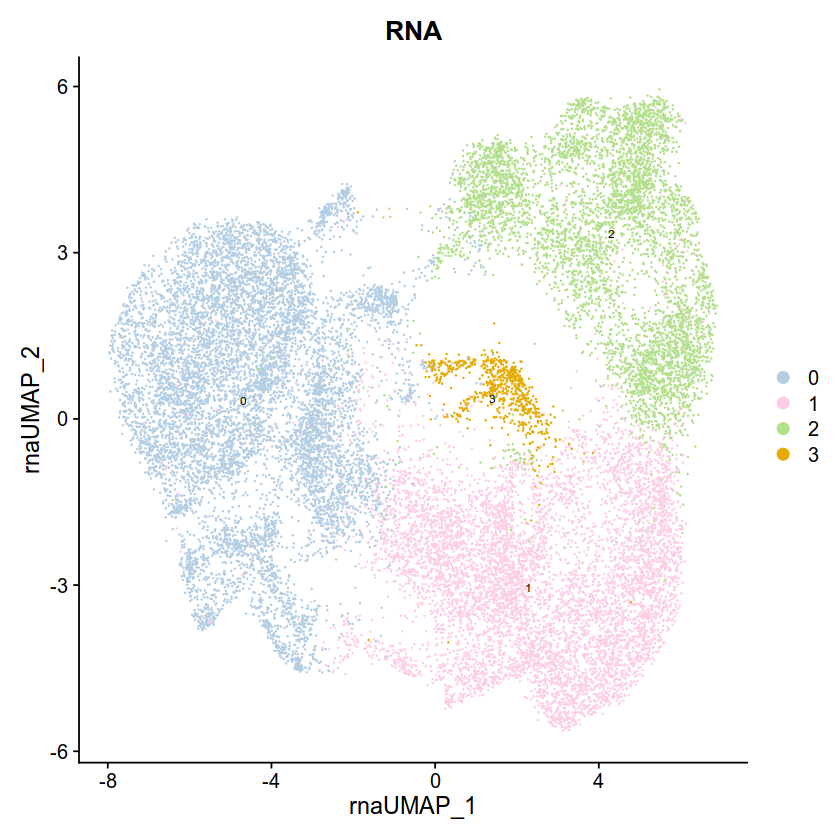

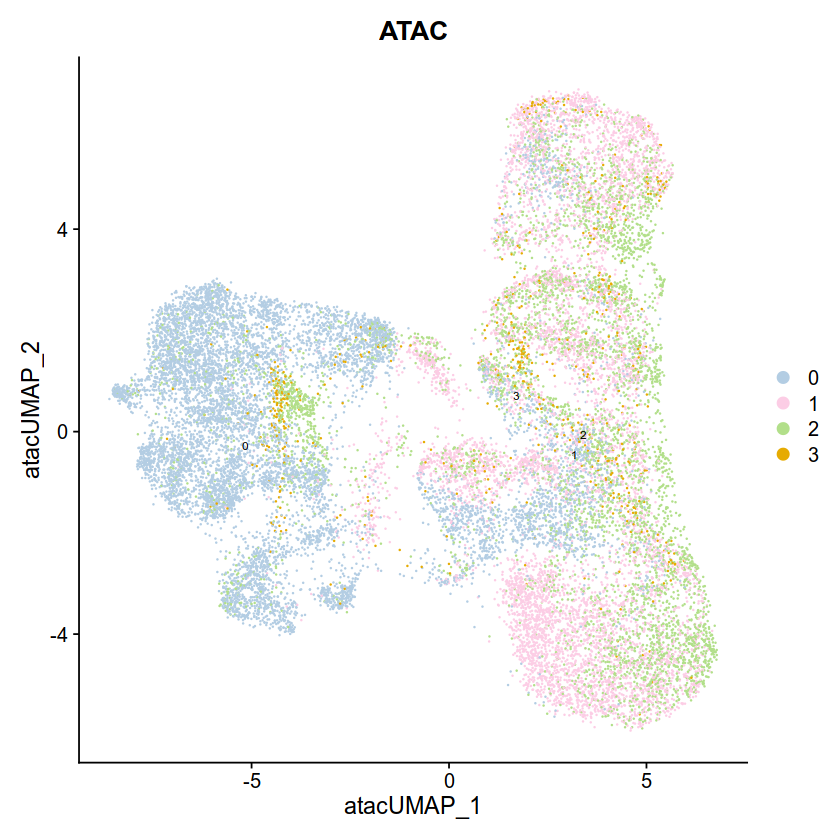

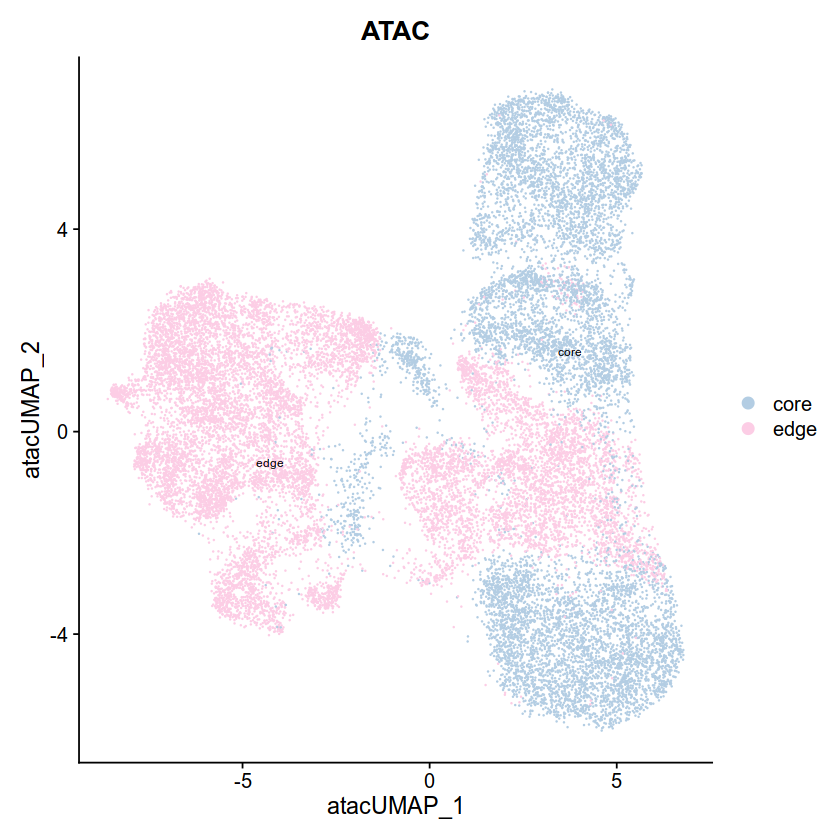

In [141]:
p1
p2
 DimPlot(glio.int, reduction = "umap", group.by = "type", label = TRUE, label.size = 2.5, repel = TRUE,cols=col) + ggtitle("ATAC")


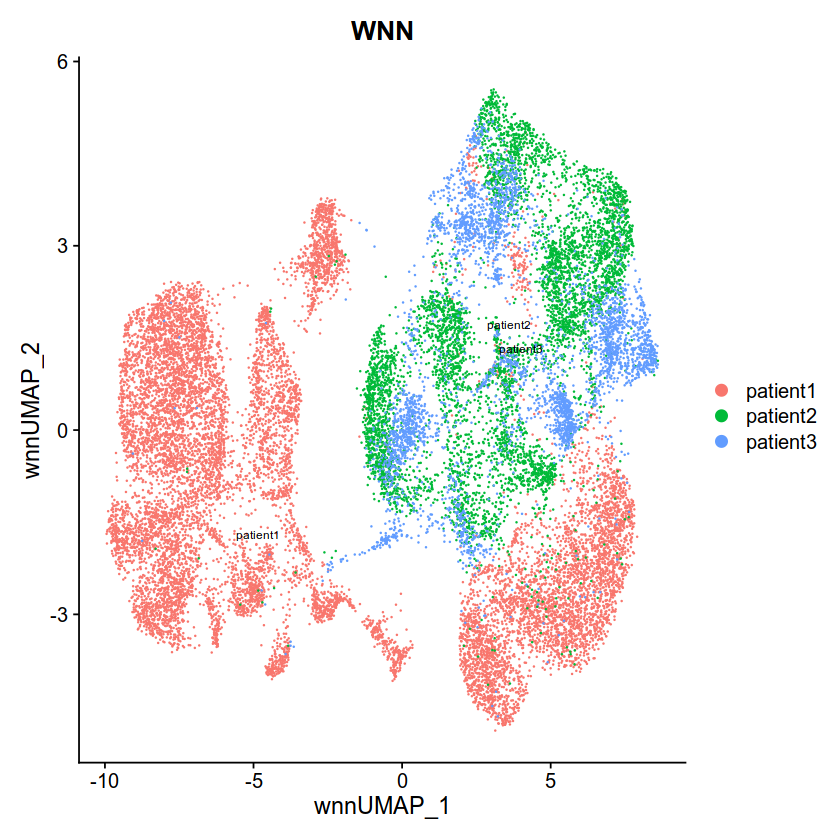

In [94]:
DimPlot(glio.int, reduction = "wnn.umap", group.by = "patient",label = TRUE, label.size = 2.5, repel = TRUE) + ggtitle("WNN")

In [95]:
#save(glio.int2,file="multi_omic_analysis_core_edge.glio.Rdata")

In [114]:
#save(glio.int,file="glio.int.all.rdata")

In [1]:
load("glio.int.all.rdata")

In [96]:
a<-load("/disk1/xilu/glioblastoma_single_cell/merged.data.glioblastoma.core.edge.rdata")

In [97]:
cluster<-data.frame(glio.int2$new_cluster)

In [98]:
glio.int<-AddMetaData(glio.int,metadata=cluster)

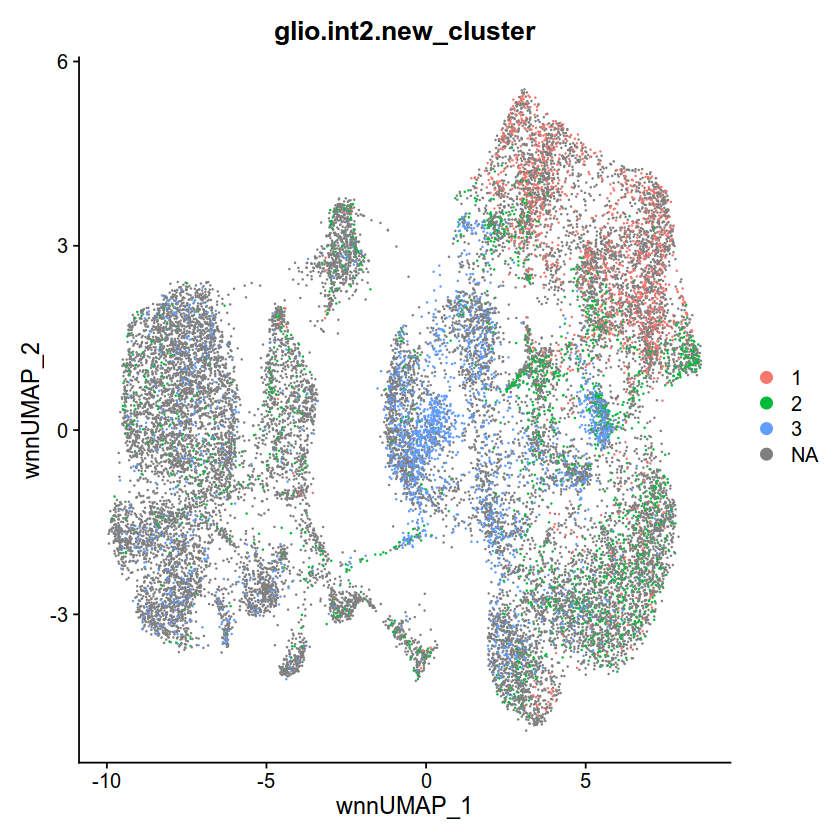

In [100]:
DimPlot(glio.int,reduction="wnn.umap", group.by = "glio.int2.new_cluster")

In [108]:
DefaultAssay(glio.int) <- "CCA_RNA"
glio.int<-FindNeighbors(glio.int,dims=1:30,k.param=60,prune.SNN=1/20)
#filtered_seurat<-FindNeighbors(filtered_seurat,dims=1:30)
names(glio.int@graphs)

Computing nearest neighbor graph

Computing SNN



[1] "wknn"        "wsnn"        "CCA_RNA_nn"  "CCA_RNA_snn"

In [109]:
for( res in c(0.1,0.2,0.3,0.4,0.6,0.8,1)){
    glio.int<-FindClusters(glio.int,graph.name='CCA_RNA_snn',resolution=res,algorithm=1)
    #filtered_seurat<-FindClusters(filtered_seurat,resolution=res)
}

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 22741
Number of edges: 3427367

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.9367
Number of communities: 3
Elapsed time: 12 seconds


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-1') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 22741
Number of edges: 3427367

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.9038
Number of communities: 4
Elapsed time: 12 seconds


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-1') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 22741
Number of edges: 3427367

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8820
Number of communities: 8
Elapsed time: 13 seconds


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-1') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 22741
Number of edges: 3427367

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8629
Number of communities: 9
Elapsed time: 14 seconds


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-1') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 22741
Number of edges: 3427367

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8307
Number of communities: 11
Elapsed time: 12 seconds


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-1') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 22741
Number of edges: 3427367

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8076
Number of communities: 13
Elapsed time: 12 seconds


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-1') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 22741
Number of edges: 3427367

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.7884
Number of communities: 13
Elapsed time: 14 seconds


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-1') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


In [5]:
library(RColorBrewer)
n <- 20
qual_col_pals = brewer.pal.info[brewer.pal.info$category == 'qual',]
col_vector = unlist(mapply(brewer.pal, qual_col_pals$maxcolors, rownames(qual_col_pals)))
col<-sample(col_vector, n)

In [6]:
col2<-col
col2
col<-c("#B3CDE3","#FCCDE5","#B2DF8A","#E6AB02","#FDBF6F")

[1] "#B15928" "#E31A1C" "#1B9E77" "#386CB0" "#B3E2CD" "#666666" "#FFFF99"
 [8] "#E6AB02" "#FC8D62" "#B3B3B3" "#FDB462" "#FFFFB3" "#FB9A99" "#CBD5E8"
[15] "#33A02C" "#FB8072" "#FDC086" "#FDDAEC" "#CCEBC5" "#FBB4AE"

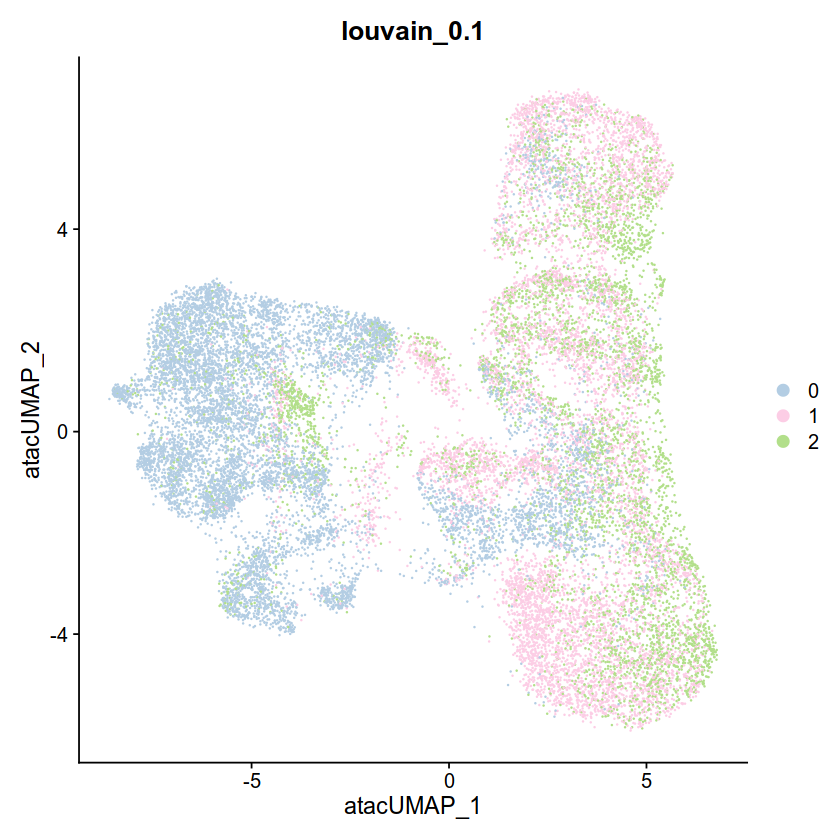

ERROR while rich displaying an object: Error in `palette()`:
! Insufficient values in manual scale. 8 needed but only 5 provided.

Traceback:
1. tryCatch(withCallingHandlers({
 .     if (!mime %in% names(repr::mime2repr)) 
 .         stop("No repr_* for mimetype ", mime, " in repr::mime2repr")
 .     rpr <- repr::mime2repr[[mime]](obj)
 .     if (is.null(rpr)) 
 .         return(NULL)
 .     prepare_content(is.raw(rpr), rpr)
 . }, error = error_handler), error = outer_handler)
2. tryCatchList(expr, classes, parentenv, handlers)
3. tryCatchOne(expr, names, parentenv, handlers[[1L]])
4. doTryCatch(return(expr), name, parentenv, handler)
5. withCallingHandlers({
 .     if (!mime %in% names(repr::mime2repr)) 
 .         stop("No repr_* for mimetype ", mime, " in repr::mime2repr")
 .     rpr <- repr::mime2repr[[mime]](obj)
 .     if (is.null(rpr)) 
 .         return(NULL)
 .     prepare_content(is.raw(rpr), rpr)
 . }, error = error_handler)
6. repr::mime2repr[[mime]](obj)
7. repr_text.defau

ERROR while rich displaying an object: Error in `palette()`:
! Insufficient values in manual scale. 13 needed but only 5 provided.

Traceback:
1. tryCatch(withCallingHandlers({
 .     if (!mime %in% names(repr::mime2repr)) 
 .         stop("No repr_* for mimetype ", mime, " in repr::mime2repr")
 .     rpr <- repr::mime2repr[[mime]](obj)
 .     if (is.null(rpr)) 
 .         return(NULL)
 .     prepare_content(is.raw(rpr), rpr)
 . }, error = error_handler), error = outer_handler)
2. tryCatchList(expr, classes, parentenv, handlers)
3. tryCatchOne(expr, names, parentenv, handlers[[1L]])
4. doTryCatch(return(expr), name, parentenv, handler)
5. withCallingHandlers({
 .     if (!mime %in% names(repr::mime2repr)) 
 .         stop("No repr_* for mimetype ", mime, " in repr::mime2repr")
 .     rpr <- repr::mime2repr[[mime]](obj)
 .     if (is.null(rpr)) 
 .         return(NULL)
 .     prepare_content(is.raw(rpr), rpr)
 . }, error = error_handler)
6. repr::mime2repr[[mime]](obj)
7. repr_text.defa

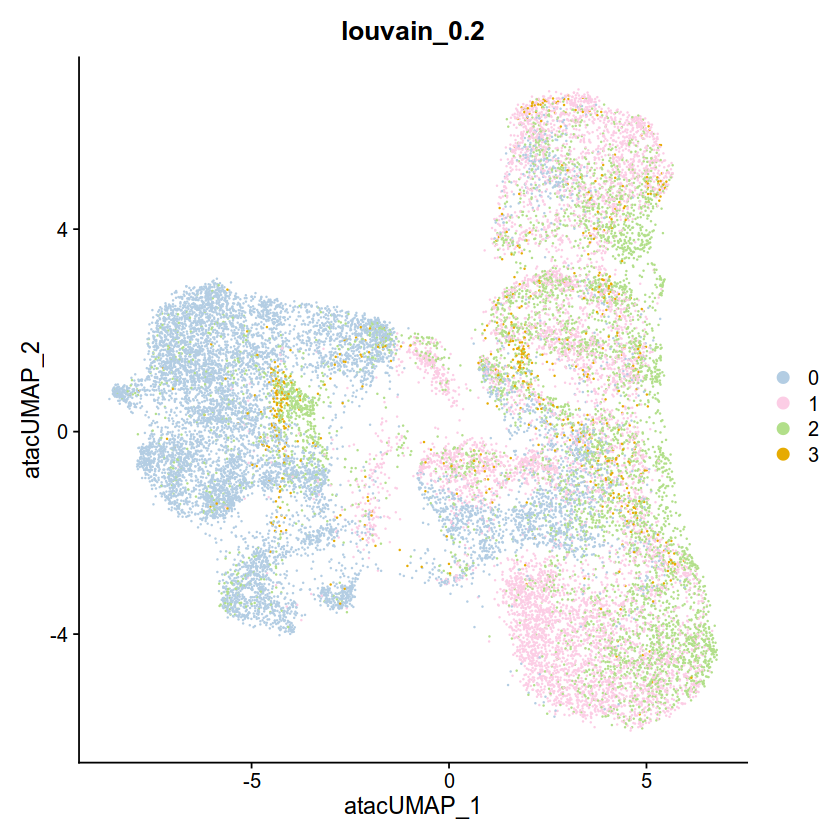

In [90]:
DimPlot(glio.int, reduction = "umap", group.by = "CCA_RNA_snn_res.0.1",cols = col) + ggtitle("louvain_0.1")
DimPlot(glio.int,reduction="umap",group.by="CCA_RNA_snn_res.0.2",cols = col) + ggtitle("louvain_0.2")
DimPlot(glio.int,reduction="umap",group.by="CCA_RNA_snn_res.0.3",cols = col) + ggtitle("louvain_0.3")
DimPlot(glio.int,reduction="umap",group.by="CCA_RNA_snn_res.0.4",cols = col) + ggtitle("louvain_0.4")
#DimPlot(alldata.int,reduction="tsne",group.by="CCA_snn_res.0.4",cols = col) + ggtitle("louvain_0.4")
DimPlot(glio.int, reduction = "umap", group.by = "CCA_RNA_snn_res.0.6",cols = col) + ggtitle("louvain_0.6")
DimPlot(glio.int,reduction="umap",group.by="CCA_RNA_snn_res.0.8",cols = col) + ggtitle("louvain_0.8")
DimPlot(glio.int, reduction = "umap", group.by = "CCA_RNA_snn_res.1",cols = col) + ggtitle("louvain_1")

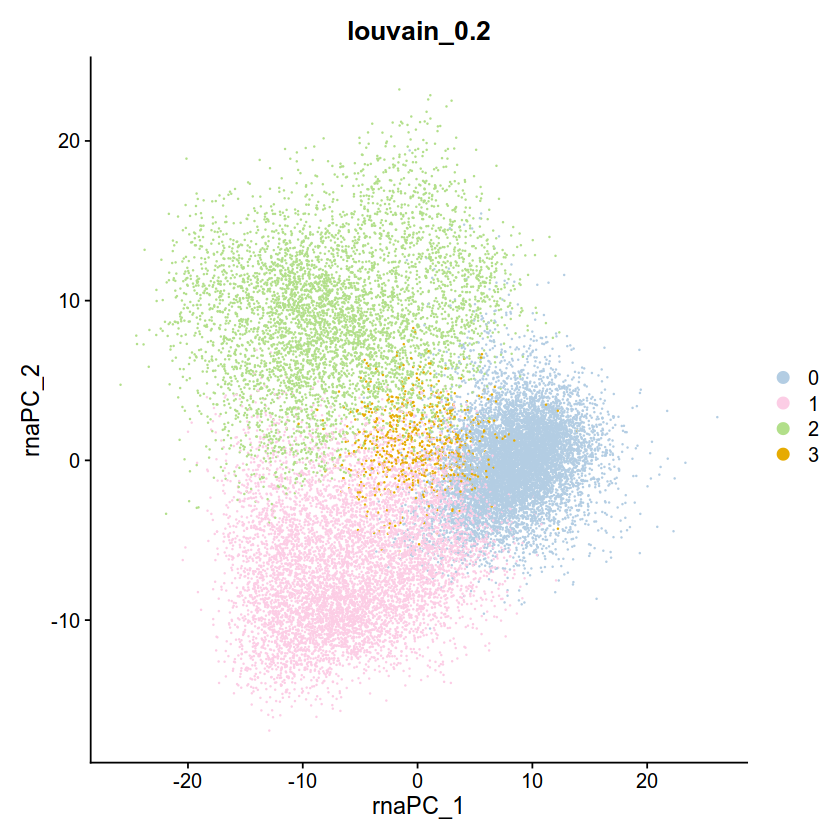

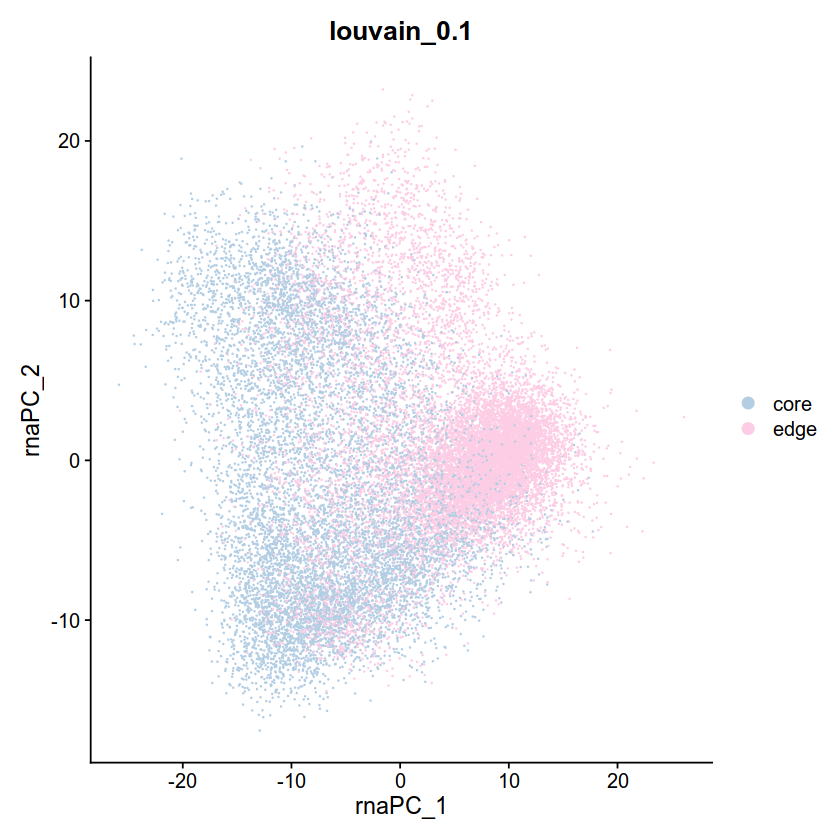

In [87]:
DimPlot(glio.int, reduction = "pca", group.by = "CCA_RNA_snn_res.0.2",cols = col) + ggtitle("louvain_0.2")
DimPlot(glio.int, reduction = "pca", group.by = "type",cols = col) + ggtitle("louvain_0.1")

In [120]:
col

[1] "#B3CDE3" "#FCCDE5" "#B2DF8A" "#E6AB02" "#FDBF6F"

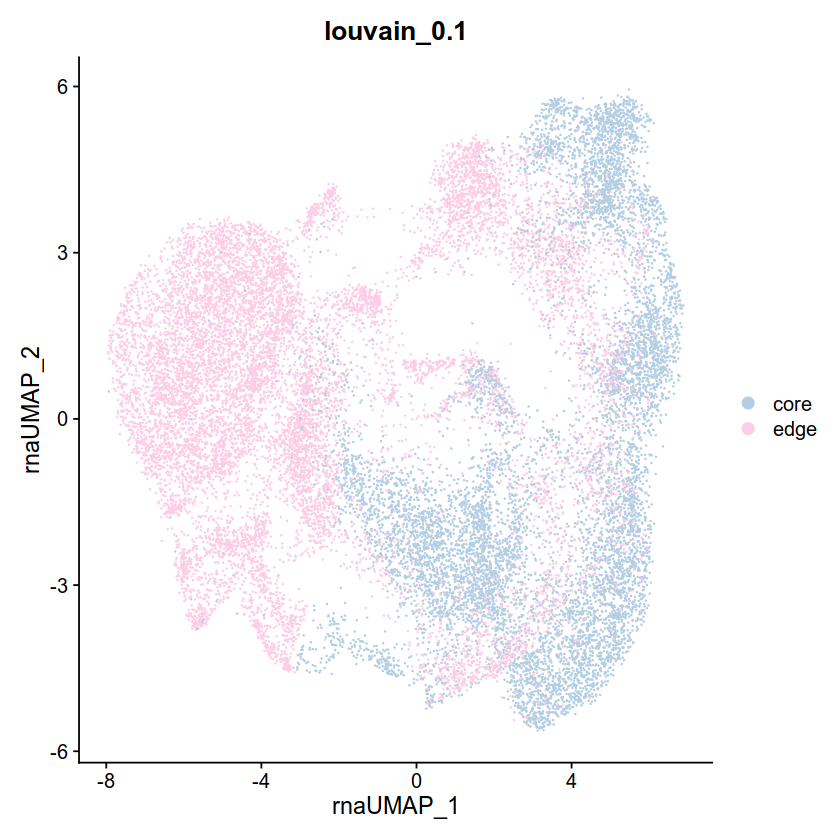

In [118]:
DimPlot(glio.int, reduction = "rna.umap", group.by = "type") + ggtitle("louvain_0.1")

In [93]:
table(glio.int$`CCA_RNA_snn_res.0.2`,glio.int$type)

   
    core edge
  0  402 8993
  1 5858 1447
  2 3290 2080
  3  274  397

In [94]:
DimPlot(glio.int, reduction = "pca", group.by = "sample",cols = col) + ggtitle("louvain_0.2")

ERROR while rich displaying an object: Error in `palette()`:
! Insufficient values in manual scale. 6 needed but only 5 provided.

Traceback:
1. tryCatch(withCallingHandlers({
 .     if (!mime %in% names(repr::mime2repr)) 
 .         stop("No repr_* for mimetype ", mime, " in repr::mime2repr")
 .     rpr <- repr::mime2repr[[mime]](obj)
 .     if (is.null(rpr)) 
 .         return(NULL)
 .     prepare_content(is.raw(rpr), rpr)
 . }, error = error_handler), error = outer_handler)
2. tryCatchList(expr, classes, parentenv, handlers)
3. tryCatchOne(expr, names, parentenv, handlers[[1L]])
4. doTryCatch(return(expr), name, parentenv, handler)
5. withCallingHandlers({
 .     if (!mime %in% names(repr::mime2repr)) 
 .         stop("No repr_* for mimetype ", mime, " in repr::mime2repr")
 .     rpr <- repr::mime2repr[[mime]](obj)
 .     if (is.null(rpr)) 
 .         return(NULL)
 .     prepare_content(is.raw(rpr), rpr)
 . }, error = error_handler)
6. repr::mime2repr[[mime]](obj)
7. repr_text.defau

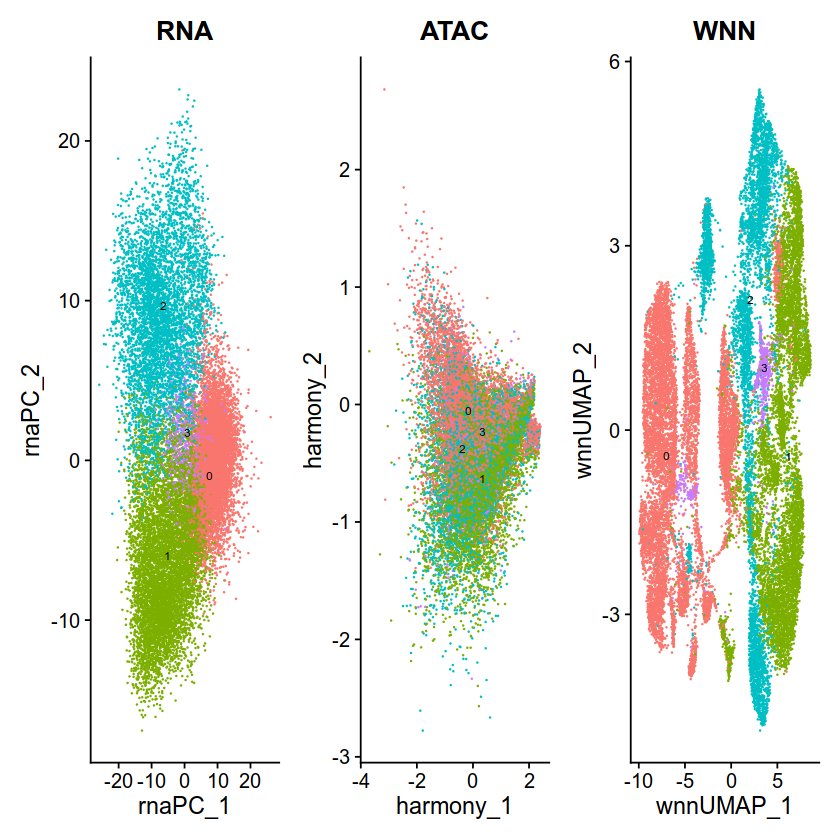

In [95]:
p1 <- DimPlot(glio.int, reduction = "pca", group.by = "CCA_RNA_snn_res.0.2", label = TRUE, label.size = 2.5, repel = TRUE) + ggtitle("RNA")
p2 <- DimPlot(glio.int, reduction = "harmony", group.by = "CCA_RNA_snn_res.0.2", label = TRUE, label.size = 2.5, repel = TRUE) + ggtitle("ATAC")
p3 <- DimPlot(glio.int, reduction = "wnn.umap", group.by = "CCA_RNA_snn_res.0.2",label = TRUE, label.size = 2.5, repel = TRUE) + ggtitle("WNN")
p1 + p2 + p3 & NoLegend() & theme(plot.title = element_text(hjust = 0.5))

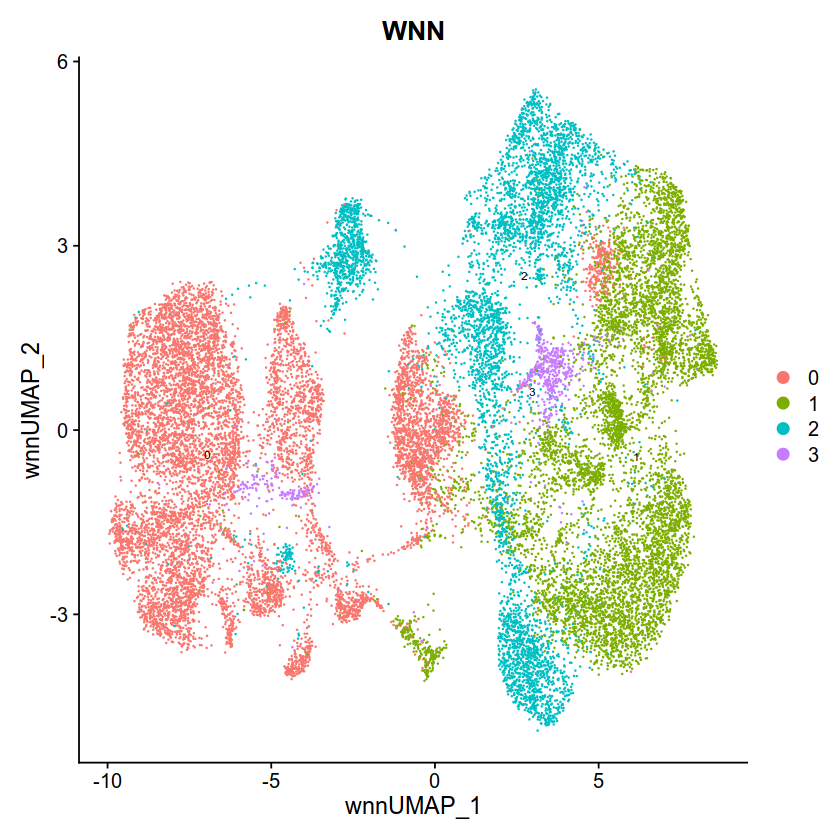

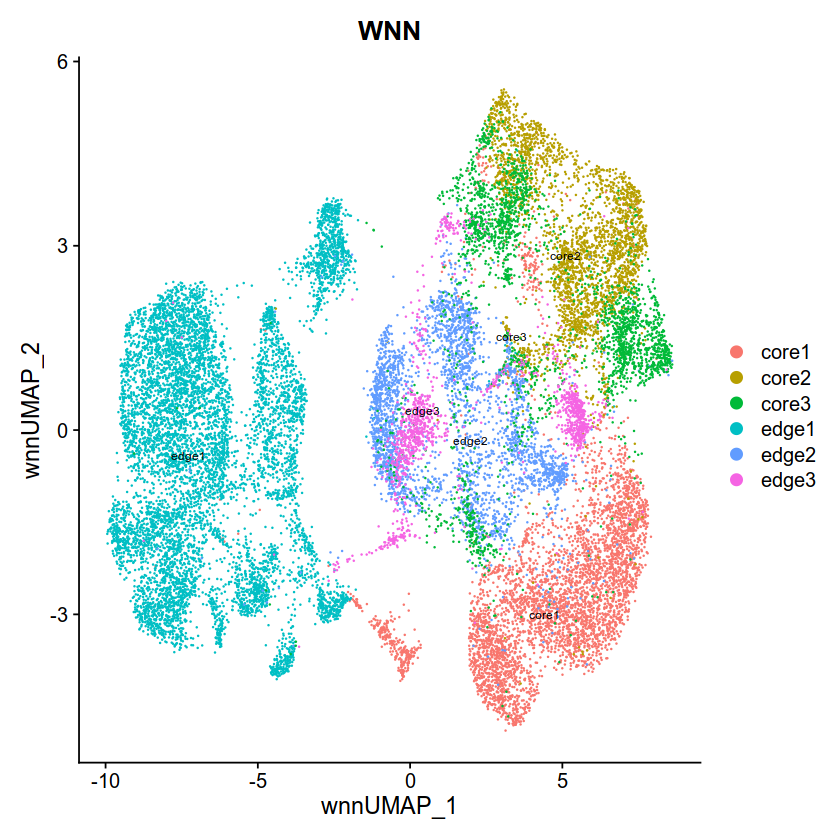

In [30]:
p3
 DimPlot(glio.int, reduction = "wnn.umap", group.by = "sample",label = TRUE, label.size = 2.5, repel = TRUE) + ggtitle("WNN")

In [31]:
table(glio.int$`CCA_RNA_snn_res.0.2`,glio.int$sample)

   
    core1 core2 core3 edge1 edge2 edge3
  0    54   243   105  7440   968   585
  1  3024  1634  1200    24   913   510
  2  1360   860  1070   865  1050   165
  3    30   131   113   181   169    47

In [109]:
DefaultAssay(glio.int) <- "CCA_RNA"
markers_rna <- presto:::wilcoxauc.Seurat(X = glio.int, group_by = 'CCA_RNA_snn_res.0.2', assay = 'data', seurat_assay = 'CCA_RNA')
colnames(markers_rna) <- paste0("RNA.", colnames(markers_rna))
markers_rna$gene <- markers_rna$RNA.feature

In [110]:
topTFs_rna <- function(CCA_RNA_snn_res.0.2, padj.cutoff = 0.01) {
  ctmarkers_rna <- dplyr::filter(
    markers_rna, RNA.group == CCA_RNA_snn_res.0.2, RNA.padj < 0.01, RNA.logFC > 0.5,RNA.auc>0.6 ) 
  ctmarkers_motif <- dplyr::filter(
    markers_motifs, motif.group == CCA_RNA_snn_res.0.2, motif.padj < padj.cutoff, motif.logFC > 0) 
  top_tfs <- ctmarkers_rna
  return(top_tfs)
}

In [111]:
tf1_rna<-topTFs_rna("0")
tf2_rna<-topTFs_rna("1")
tf3_rna<-topTFs_rna("2")
tf4_rna<-topTFs_rna("3")
tf_rna<-rbind(tf1_rna,tf2_rna,tf3_rna,tf4_rna)


In [112]:
length(which(tf_rna$RNA.group == "0"))


[1] 67

In [99]:
tf_rna$RNA.feature[which(tf_rna$RNA.group == 1)]
tf_rna$RNA.feature[which(tf_rna$RNA.group == 2)]
tf_rna$RNA.feature[which(tf_rna$RNA.group == 0)]
tf_rna$RNA.feature[which(tf_rna$RNA.group == 3)]

[1] "DCC"         "AC002069.2"  "GRIK1"       "LRRTM4"      "NEFL"       
 [6] "NXPH1"       "GRIK2"       "PLD5"        "AC092957.1"  "LRRC4C"     
[11] "TGFBI"       "CACNA1A"     "SDK1"        "PLXNA4"      "PPFIA2"     
[16] "NKAIN3"      "JAKMIP2-AS1" "SNTG1"       "TNC"         "COL6A1"     
[21] "EYA4"        "SOX2-OT"     "LINC00511"   "SOX4"        "MMP16"      
[26] "FREM2"       "NOVA1"       "LDLRAD3"     "SLC1A3"      "NEDD4L"     
[31] "PTPRZ1"      "PTN"         "ARL4C"       "CASC15"      "FHIT"

[1] "APOLD1"     "ASPM"       "PLD5"       "HMGA2"      "MIR924HG"  
 [6] "CENPE"      "TOP2A"      "CENPF"      "LRRC4C"     "DIAPH3"    
[11] "KIF14"      "SDK1"       "CSMD2"      "KIF18A"     "ARHGAP11B" 
[16] "AC073529.1" "GPC6"       "GAS2L3"     "TPX2"       "BRIP1"     
[21] "KIF18B"     "CIT"        "RFC3"       "NAV2"       "MKI67"     
[26] "KIF4A"      "KNL1"       "ANLN"       "ECT2"       "KPNA2"     
[31] "RRM2"       "CENPP"      "SGO2"       "CDCA2"      "NUF2"      
[36] "NUSAP1"     "GTSE1"      "DTL"        "BUB1"       "E2F7"      
[41] "POLQ"       "SCLT1"      "RTTN"       "FANCI"      "NCAPG"     
[46] "ATAD2"      "KIF20B"     "CENPK"      "SPC25"      "CEP128"    
[51] "DBF4"       "MMS22L"     "CCDC18"     "NDC80"      "MELK"      
[56] "DLEU2"      "SMC4"       "KIF15"      "CLSPN"      "XRCC2"     
[61] "C21orf58"   "MIS18BP1"   "LINC01572"  "BRCA2"      "CIP2A"     
[66] "Z94721.1"   "PRIM2"      "PARPBP"     "TACC3"      "EZH2"      
[71] "CENPI"      "POLA1"      "AP001347.1" "STIL"       "TMPO"      
[76] "NCAPG2"     "PBX3"       "ATAD5"      "LMNB1"

[1] "COL3A1"     "FN1"        "PDE1A"      "ROBO2"      "ACTG2"     
 [6] "ARHGAP24"   "CHSY3"      "GABRG3"     "EPHA3"      "MYBPC1"    
[11] "SPP1"       "THBS1"      "PCDH7"      "KCNK2"      "COL1A2"    
[16] "LAMA2"      "PRSS12"     "ITGBL1"     "CPA6"       "ALPK2"     
[21] "RNF150"     "EFEMP1"     "PRUNE2"     "COL21A1"    "PDE1C"     
[26] "BICC1"      "LMO3"       "TRPM3"      "CD74"       "NTRK2"     
[31] "HLA-DRA"    "GRIN2B"     "NR3C2"      "TGFB2"      "TMTC2"     
[36] "HLA-DRB1"   "LTBP1"      "CALD1"      "GRIA1"      "NFIA"      
[41] "AL096854.1" "NNMT"       "AHR"        "NEAT1"      "SPARCL1"   
[46] "GCNT1"      "PDE4D"      "IGFBP7"     "AL390957.1" "CTNNA2"    
[51] "PRICKLE1"   "SYNM"       "CRIM1"      "PALLD"      "FBN1"      
[56] "AC090371.2" "CCDC102B"   "TENM1"      "MAP2"       "ABCC3"     
[61] "PLCB1"      "AFF3"       "COL4A5"     "ANK2"       "NRP1"      
[66] "XAF1"       "ROBO1"

[1] "ASPM"    "CENPE"   "TOP2A"   "CENPF"   "ARL6IP1" "TPX2"    "MKI67"  
 [8] "CCNB1"   "PRC1"    "SMC4"    "UBE2S"   "CAV1"

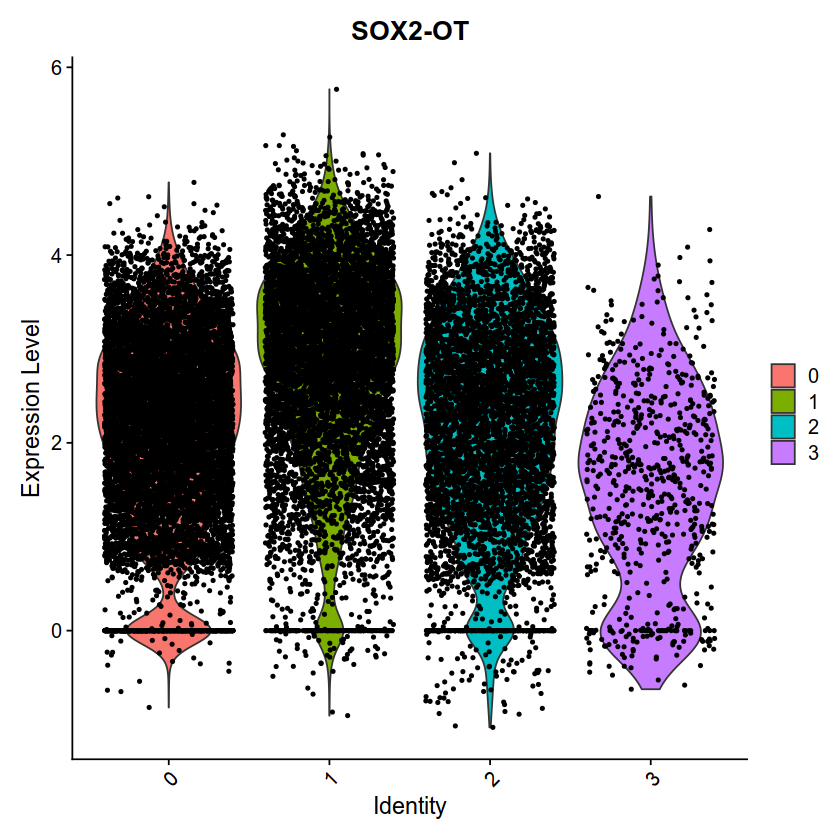

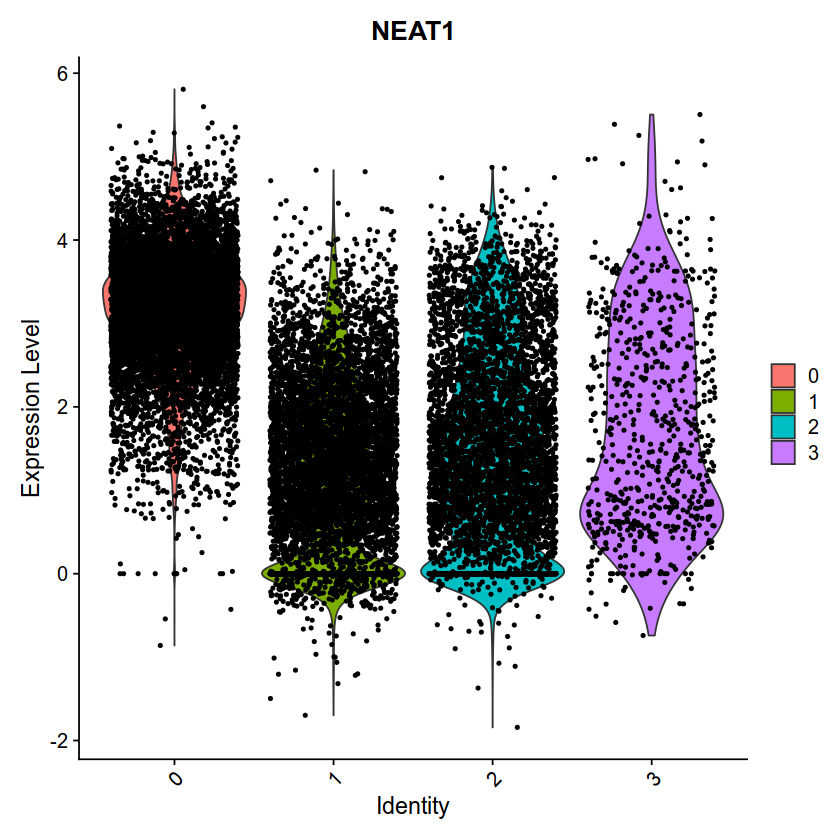

In [27]:
DefaultAssay(glio.int) <- "CCA_RNA"
VlnPlot(object = glio.int, features = 'SOX2-OT', group.by = 'CCA_RNA_snn_res.0.2')
VlnPlot(object = glio.int, features = 'NEAT1', group.by = 'CCA_RNA_snn_res.0.2')

In [18]:
tf_rna

RNA.feature,RNA.group,RNA.avgExpr,RNA.logFC,RNA.statistic,RNA.auc,RNA.pval,RNA.padj,RNA.pct_in,RNA.pct_out,gene
<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>
DCC,1,0.9519223,0.7002902,87451570,0.7755550,0,0,84.51745,42.39440,DCC
AC002069.2,1,0.9895744,0.6219024,80156782,0.7108620,0,0,80.49281,51.46411,AC002069.2
GRIK1,1,1.5481157,0.9270296,84724317,0.7513687,0,0,87.24162,57.76108,GRIK1
LRRTM4,1,0.6939048,0.5425450,83259966,0.7383822,0,0,76.70089,39.14226,LRRTM4
NEFL,1,1.3586518,0.9663030,96424244,0.8551282,0,0,94.09993,45.16714,NEFL
NXPH1,1,1.4679289,1.1100951,90453653,0.8021787,0,0,87.92608,45.55584,NXPH1
GRIK2,1,1.2150379,0.6725473,82401314,0.7307674,0,0,90.44490,56.23218,GRIK2
PLD5,1,1.2091601,0.5546894,79302981,0.7032901,0,0,91.86858,59.86007,PLD5
AC092957.1,1,1.8718198,0.8519023,85465728,0.7579438,0,0,95.08556,69.22130,AC092957.1


Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.


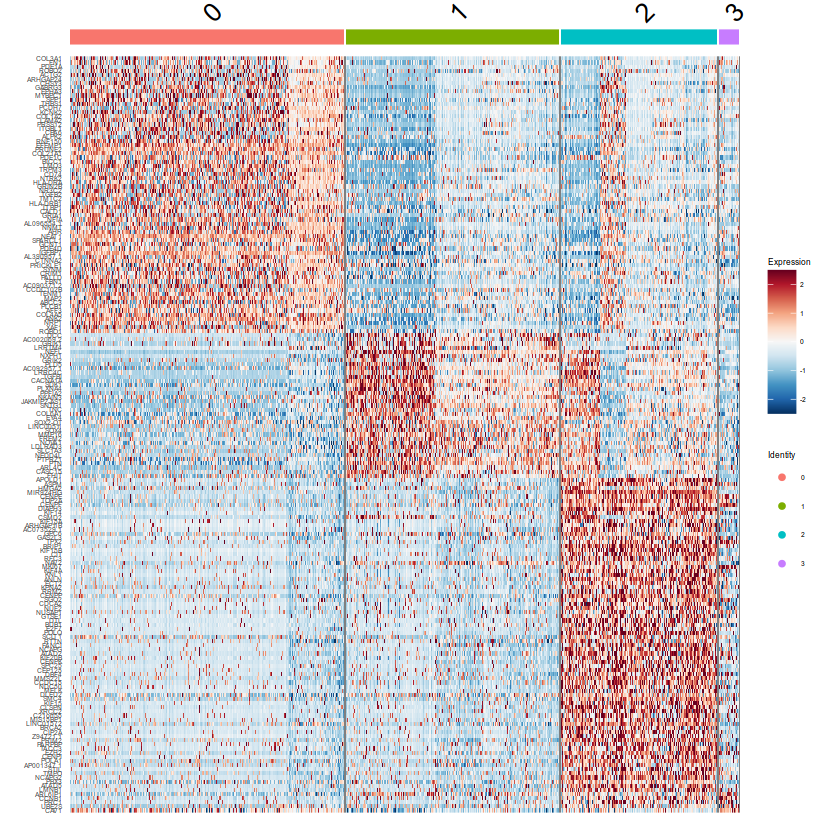

In [102]:
DefaultAssay(glio.int) <- "CCA_RNA"
mapal <- colorRampPalette(RColorBrewer::brewer.pal(11,"RdBu"))(256)
#filtered_seurat<-ScaleData(filtered_seurat,features=as.character(unique(top5$gene)),assay="RNA")
DoHeatmap(glio.int, features = as.character(tf_rna$RNA.feature), group.by = "CCA_RNA_snn_res.0.2")+scale_fill_gradientn(colours = rev(mapal))+theme(text = element_text(size = 5))

In [113]:
tf_rna %>% group_by(RNA.group) %>% top_n(30, RNA.auc) -> top30


Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.


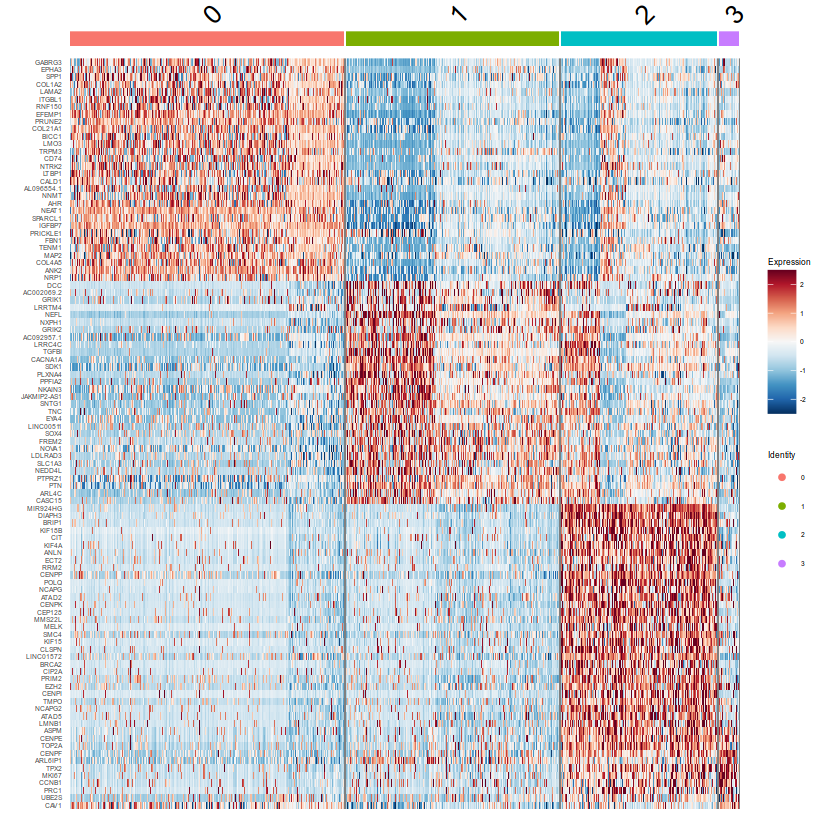

In [114]:
DefaultAssay(glio.int) <- "CCA_RNA"
mapal <- colorRampPalette(RColorBrewer::brewer.pal(11,"RdBu"))(256)
#filtered_seurat<-ScaleData(filtered_seurat,features=as.character(unique(top5$gene)),assay="RNA")
DoHeatmap(glio.int, features = as.character(top30$RNA.feature), group.by = "CCA_RNA_snn_res.0.2")+scale_fill_gradientn(colours = rev(mapal))+theme(text = element_text(size = 5))

In [116]:
pdf("all.cells.scrna-seq.differential.gene.pdf")
DoHeatmap(glio.int, features = as.character(top30$RNA.feature), group.by = "CCA_RNA_snn_res.0.2")+scale_fill_gradientn(colours = rev(mapal))+theme(text = element_text(size = 5))
dev.off()

Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.


png 
  2

In [101]:
#counts<-as.matrix(glio.int2@assays$ATAC_common_peak@counts)

In [102]:
#saveRDS(counts,file="counts.chromvar.rds")

In [103]:
getwd()

[1] "/disk1/xilu/glioblastoma_single_cell/1.RNA/1.RNA_seq_seurat"

In [43]:
DefaultAssay(glio.int) <- "ATAC_common_peak"
peaks <- CallPeaks(
  object = glio.int,
  group.by = "CCA_RNA_snn_res.0.2"
)

Processing file /disk1/pengweixing/lene_sc_glio/02.single_cell/Core/outs/atac_fragments.tsv.gz




Processing file /disk1/xilu/glioblastoma_single_cell/1.Data/sample1/outs/atac_fragments.tsv.gz




Processing file /disk1/xilu/glioblastoma_single_cell/1.Data/sample4/outs/atac_fragments.tsv.gz




Processing file /disk1/pengweixing/lene_sc_glio/02.single_cell/EDGE/outs/atac_fragments.tsv.gz




Processing file /disk1/xilu/glioblastoma_single_cell/1.Data/sample2/outs/atac_fragments.tsv.gz




Processing file /disk1/xilu/glioblastoma_single_cell/1.Data/sample3/outs/atac_fragments.tsv.gz




Processing file /disk1/pengweixing/lene_sc_glio/02.single_cell/Core/outs/atac_fragments.tsv.gz




Processing file /disk1/xilu/glioblastoma_single_cell/1.Data/sample1/outs/atac_fragments.tsv.gz




Processing file /disk1/xilu/glioblastoma_single_cell/1.Data/sample4/outs/atac_fragments.tsv.gz




Processing file /disk1/pengweixing/lene_sc_glio/02.single_cell/EDGE/outs/atac_fragments.tsv.gz




Processing

Warning message:
"Removed 97 rows containing missing values (`geom_segment()`)."
Warning message:
"Removed 1 rows containing missing values (`geom_segment()`)."


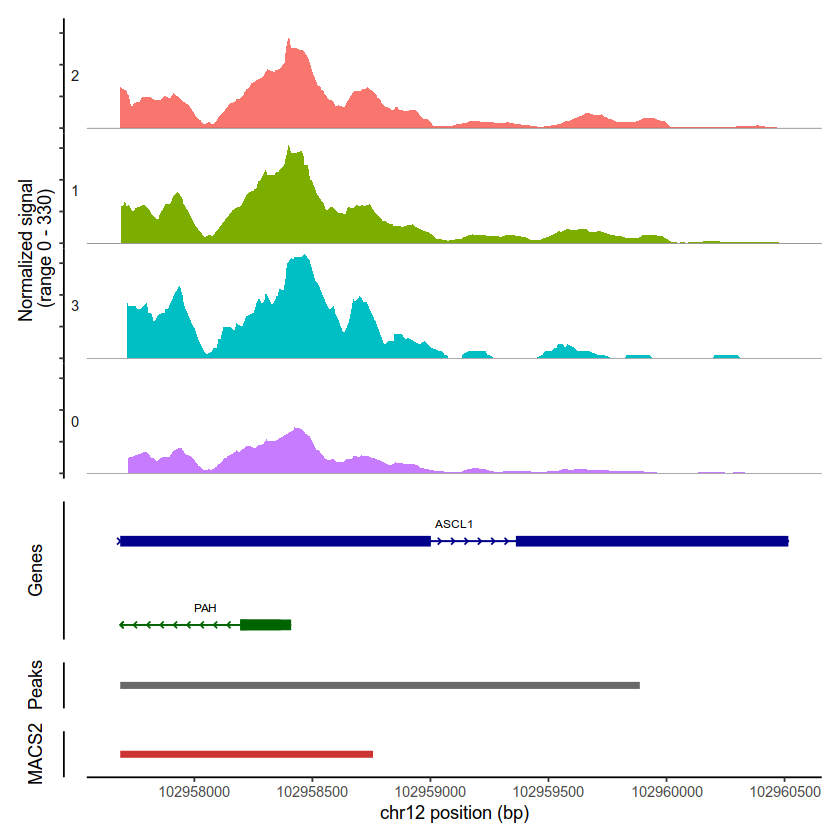

In [44]:
CoveragePlot(
  object = glio.int,
  region = "ASCL1",
  ranges = peaks,
  ranges.title = "MACS2"
)

In [45]:
peaks <- keepStandardChromosomes(peaks, pruning.mode = "coarse")
peaks <- subsetByOverlaps(x = peaks, ranges = blacklist_hg38_unified, invert = TRUE)

In [48]:
macs2_counts <- FeatureMatrix(
  fragments = Fragments(glio.int),
  features = peaks,
  cells = colnames(glio.int)
)


Extracting reads overlapping genomic regions

Extracting reads overlapping genomic regions

Extracting reads overlapping genomic regions

Extracting reads overlapping genomic regions

Extracting reads overlapping genomic regions

Extracting reads overlapping genomic regions



In [49]:
glio.int[["peaks"]]<-CreateChromatinAssay(
  counts = macs2_counts,
  fragments = Fragments(glio.int),
  annotation = annotation
)

In [50]:
save(glio.int,file="glio.int2.all.peak.rdata")

In [51]:
DefaultAssay(glio.int) <- "peaks"
glio.int <- RunTFIDF(glio.int)
glio.int <- FindTopFeatures(glio.int, min.cutoff = 20)
glio.int <- RunSVD(glio.int)
glio.int <- RunUMAP(glio.int, reduction = 'lsi',dims = 2:50)

Performing TF-IDF normalization

Running SVD

Scaling cell embeddings

Warning message:
"The default method for RunUMAP has changed from calling Python UMAP via reticulate to the R-native UWOT using the cosine metric
To use Python UMAP via reticulate, set umap.method to 'umap-learn' and metric to 'correlation'
This message will be shown once per session"
21:20:52 UMAP embedding parameters a = 0.9922 b = 1.112

21:20:52 Read 22741 rows and found 49 numeric columns

21:20:52 Using Annoy for neighbor search, n_neighbors = 30

21:20:52 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

21:20:55 Writing NN index file to temp file /tmp/RtmpxLeu0A/file815f39190255

21:20:55 Searching Annoy index using 70 threads, search_k = 3000

21:20:55 Annoy recall = 100%

21:20:57 Commencing

In [52]:
library(harmony)
DefaultAssay(glio.int) <- "peaks"
glio.int <- RunHarmony(object = glio.int, group.by.vars = 'patient', reduction = 'lsi', assay.use = 'peaks', project.dim = FALSE)
#glio.int <- RunUMAP(hm.integrated, dims = 1:30, reduction = 'harmony',reduction.key = 'atacUMAP_')


Harmony 1/10

Harmony 2/10

Harmony converged after 2 iterations



In [53]:
glio.int <- RunUMAP(glio.int, dims = 1:30, reduction = 'harmony',reduction.key = 'atacUMAP_')


21:21:46 UMAP embedding parameters a = 0.9922 b = 1.112

21:21:46 Read 22741 rows and found 30 numeric columns

21:21:46 Using Annoy for neighbor search, n_neighbors = 30

21:21:46 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

21:21:48 Writing NN index file to temp file /tmp/RtmpxLeu0A/file815f7b354832

21:21:48 Searching Annoy index using 70 threads, search_k = 3000

21:21:48 Annoy recall = 100%

21:21:50 Commencing smooth kNN distance calibration using 70 threads
 with target n_neighbors = 30

21:21:53 Initializing from normalized Laplacian + noise (using irlba)

21:21:55 Commencing optimization for 200 epochs, with 907258 positive edges

21:22:06 Optimization finished



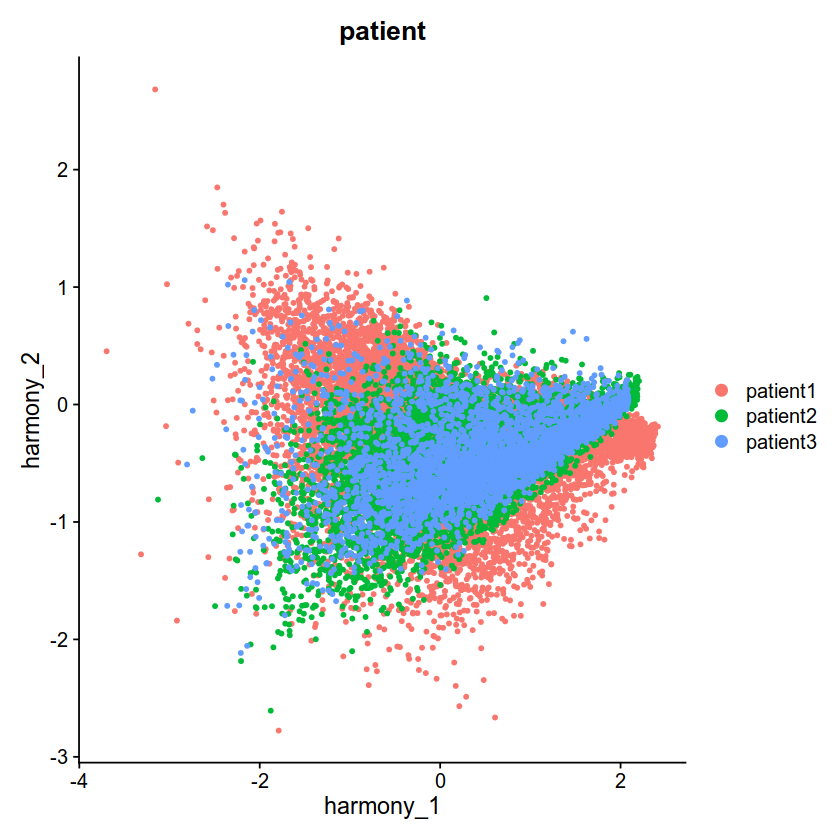

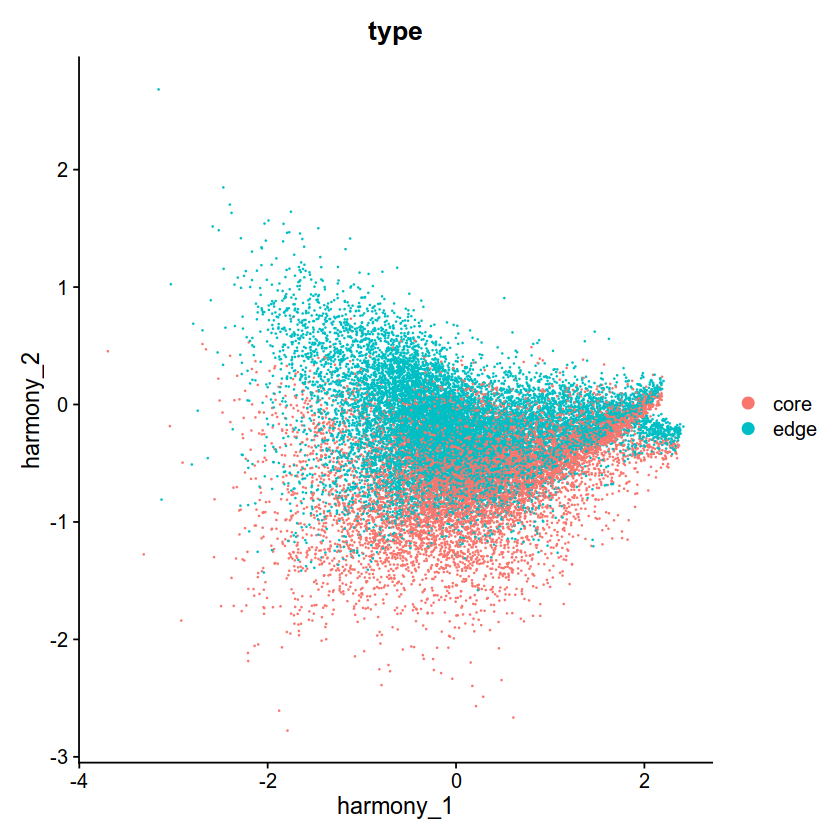

In [54]:
DimPlot(glio.int, group.by = 'patient', pt.size = 1,reduction="harmony")
DimPlot(glio.int, group.by = 'type', pt.size = 0.1,reduction="harmony")

In [142]:
DefaultAssay(glio.int) <- "peaks"
glio.int<-FindNeighbors(glio.int,dims=1:30,k.param=60,reduction = 'harmony',prune.SNN=1/20)
#filtered_seurat<-FindNeighbors(filtered_seurat,dims=1:30)
names(glio.int@graphs)

Computing nearest neighbor graph

Computing SNN



[1] "wknn"        "wsnn"        "CCA_RNA_nn"  "CCA_RNA_snn" "peaks_nn"   
[6] "peaks_snn"

In [143]:
for( res in c(0.1,0.2,0.25,0.3,0.4,0.6,0.8,1)){
    glio.int<-FindClusters(glio.int,graph.name='peaks_snn',resolution=res,algorithm=1)
    #filtered_seurat<-FindClusters(filtered_seurat,resolution=res)
}

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 22741
Number of edges: 3169219

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.9283
Number of communities: 2
Elapsed time: 11 seconds


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-1') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 22741
Number of edges: 3169219

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8902
Number of communities: 4
Elapsed time: 14 seconds


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-1') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 22741
Number of edges: 3169219

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8762
Number of communities: 6
Elapsed time: 13 seconds


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-1') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 22741
Number of edges: 3169219

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8642
Number of communities: 6
Elapsed time: 12 seconds


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-1') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 22741
Number of edges: 3169219

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8426
Number of communities: 6
Elapsed time: 11 seconds


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-1') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 22741
Number of edges: 3169219

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8117
Number of communities: 10
Elapsed time: 11 seconds


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-1') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 22741
Number of edges: 3169219

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.7904
Number of communities: 12
Elapsed time: 11 seconds


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-1') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 22741
Number of edges: 3169219

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.7726
Number of communities: 16
Elapsed time: 12 seconds


Warning message:
"UNRELIABLE VALUE: One of the 'future.apply' iterations ('future_lapply-1') unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore"."


In [144]:
library(RColorBrewer)
n <- 20
qual_col_pals = brewer.pal.info[brewer.pal.info$category == 'qual',]
col_vector = unlist(mapply(brewer.pal, qual_col_pals$maxcolors, rownames(qual_col_pals)))
col<-sample(col_vector, n)

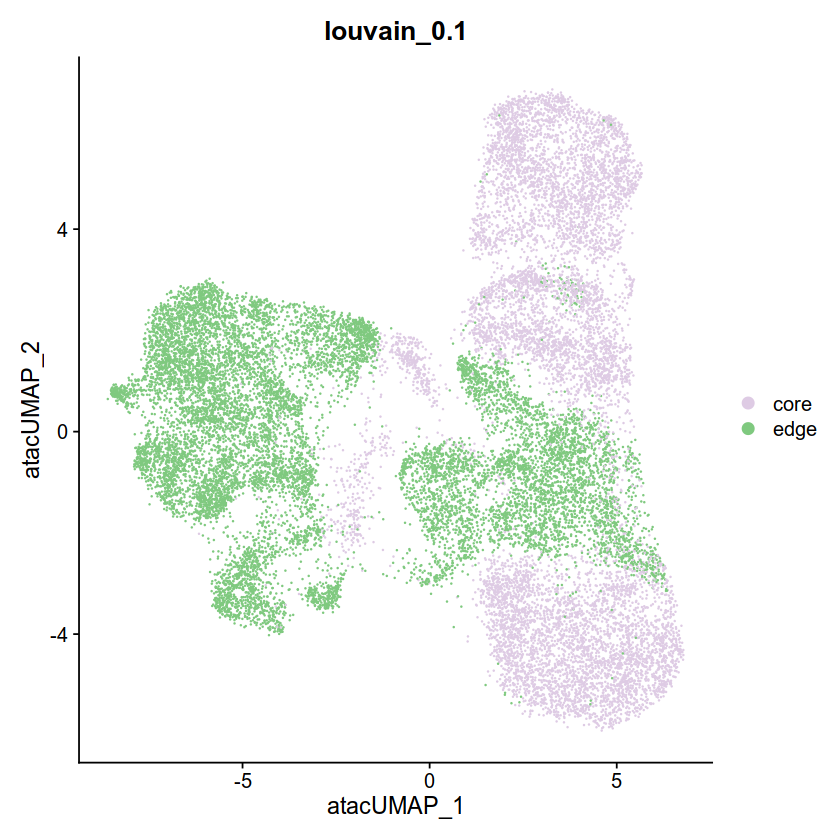

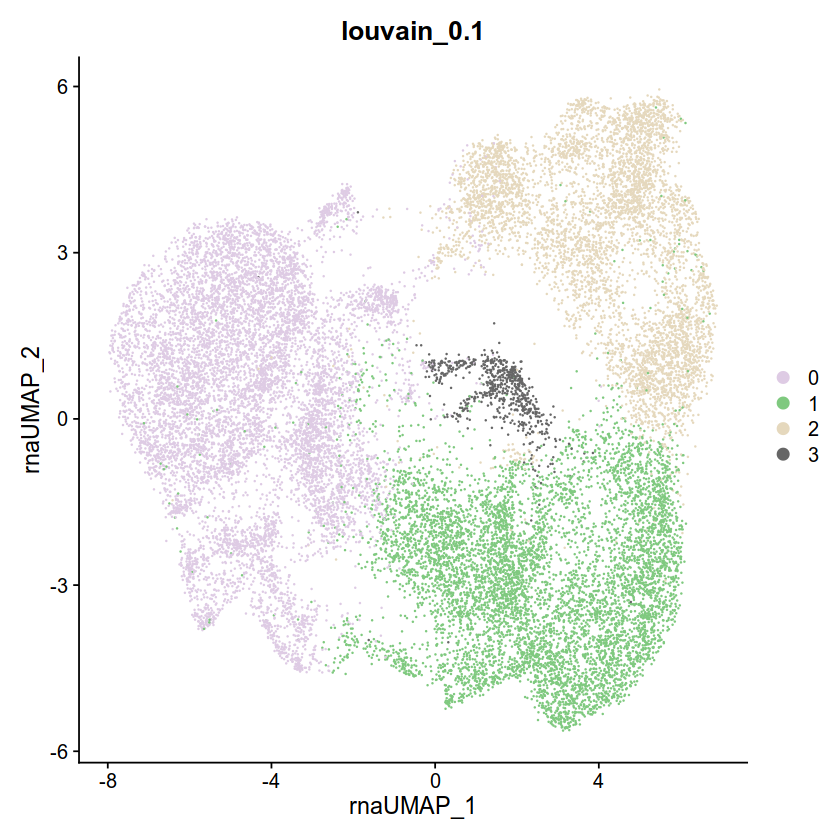

In [216]:
DimPlot(glio.int, reduction = "umap", group.by = "type",cols = col) + ggtitle("louvain_0.1")
DimPlot(glio.int, reduction = "rna.umap", group.by = "CCA_RNA_snn_res.0.2",cols = col) + ggtitle("louvain_0.1")


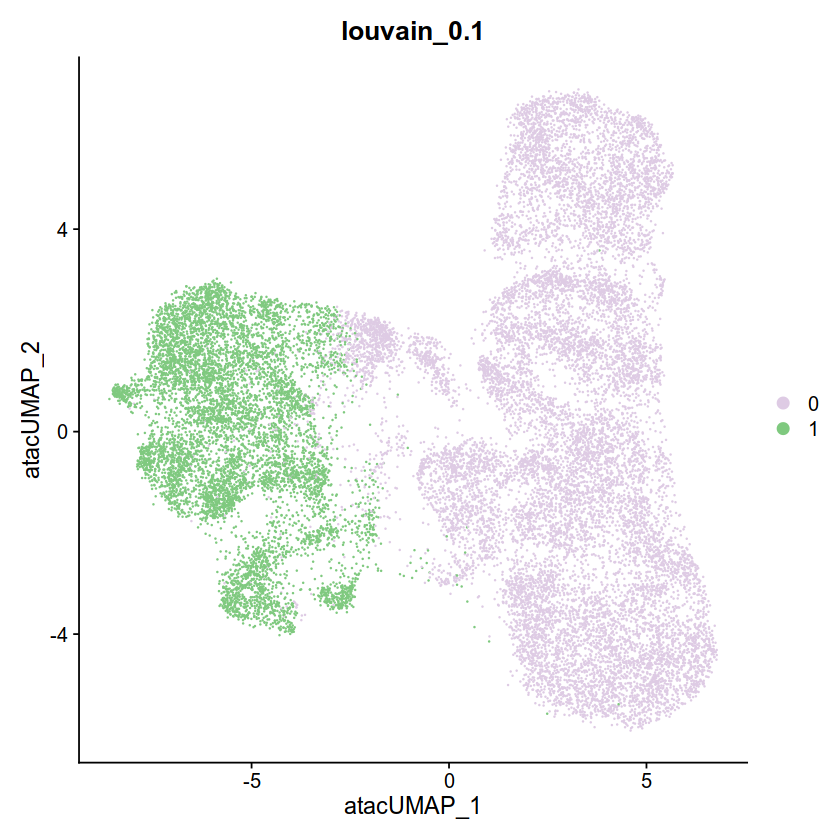

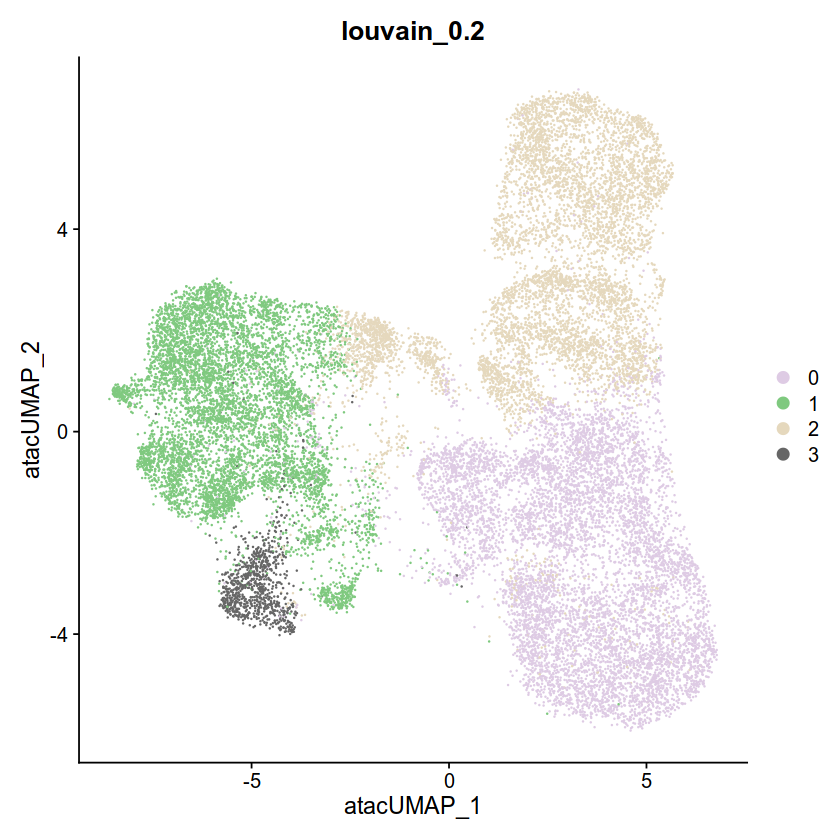

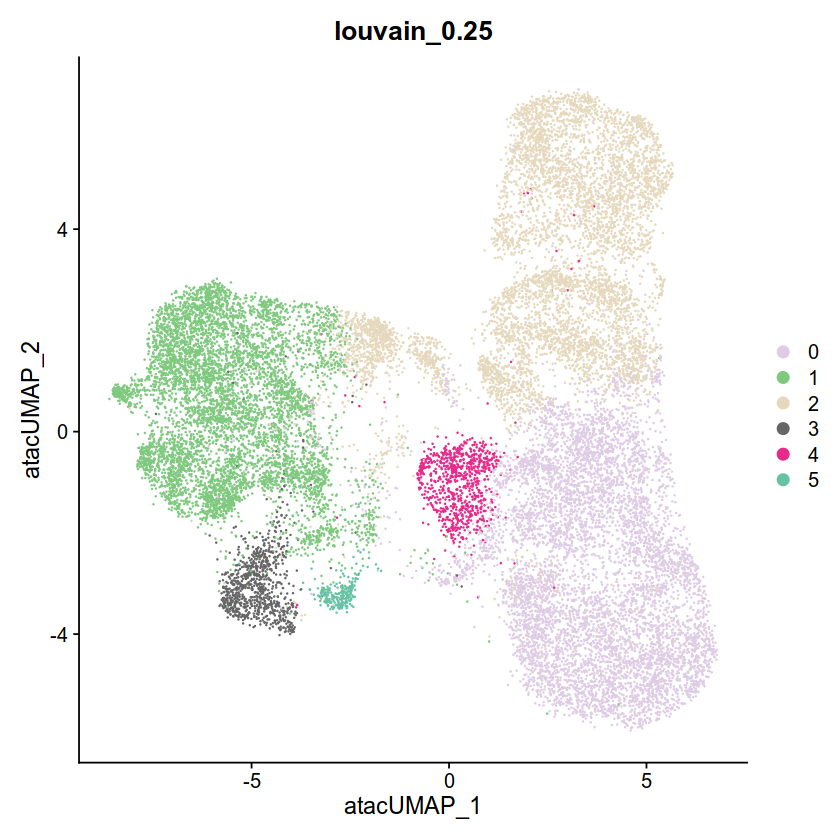

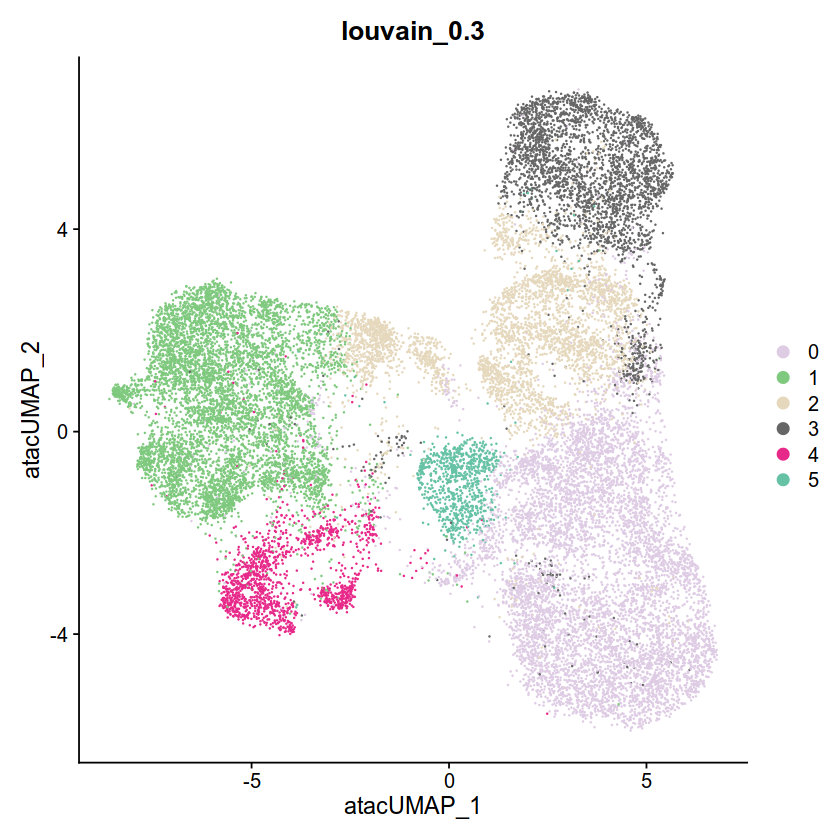

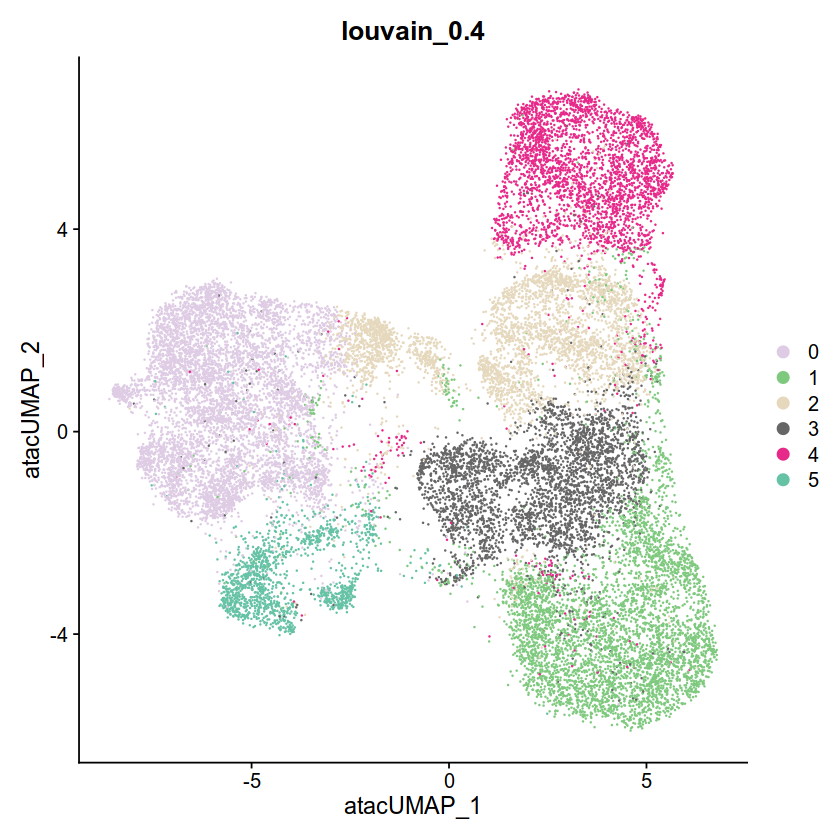

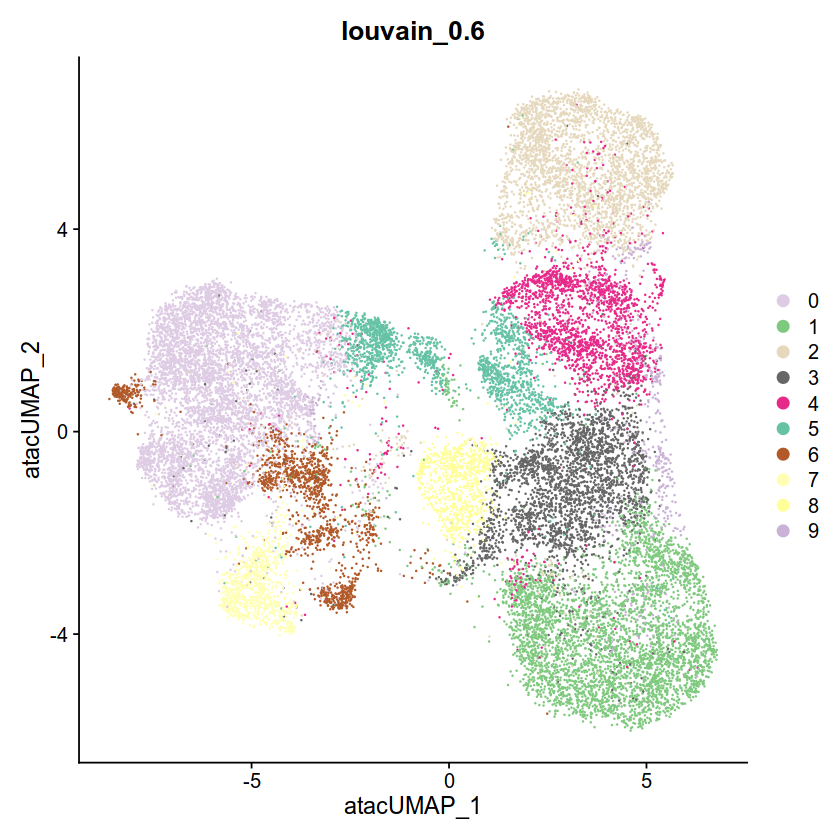

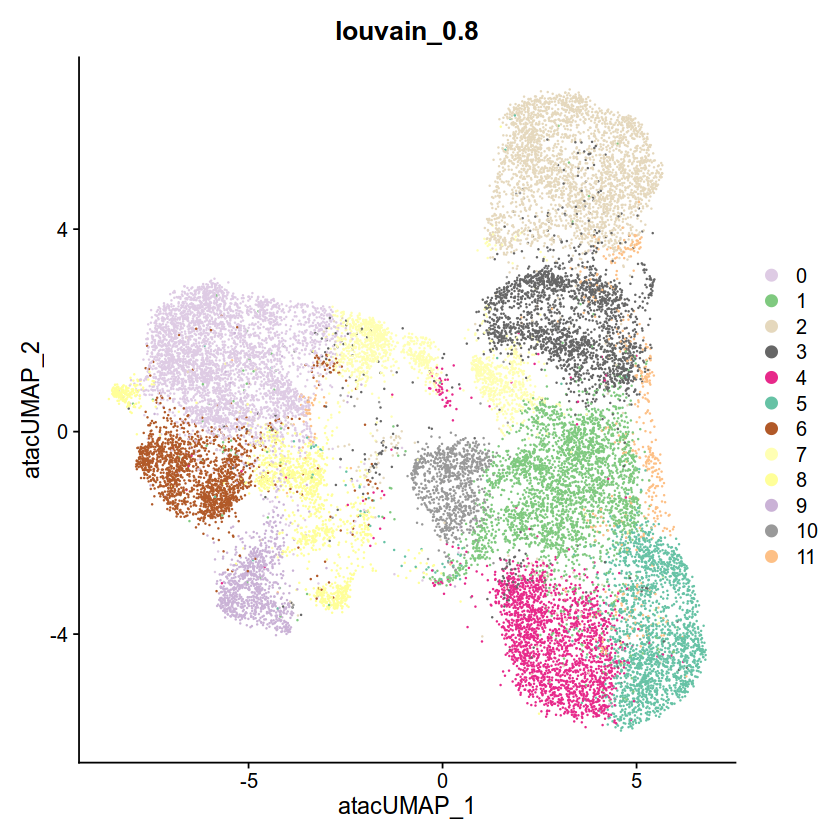

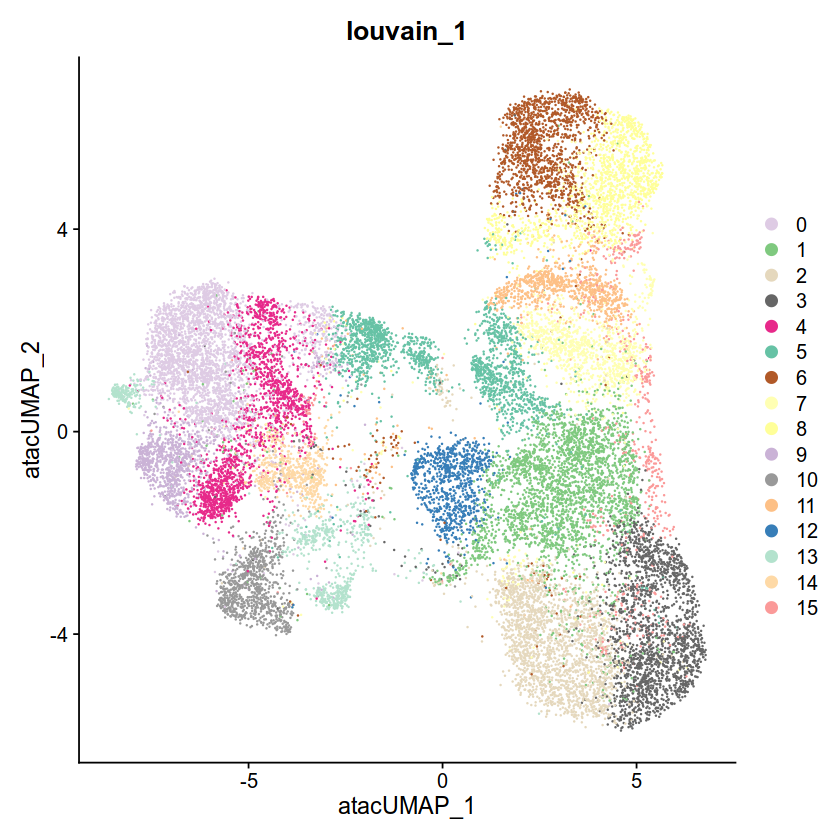

In [145]:
DimPlot(glio.int, reduction = "umap", group.by = "peaks_snn_res.0.1",cols = col) + ggtitle("louvain_0.1")
DimPlot(glio.int,reduction="umap",group.by="peaks_snn_res.0.2",cols = col) + ggtitle("louvain_0.2")
DimPlot(glio.int,reduction="umap",group.by="peaks_snn_res.0.25",cols = col) + ggtitle("louvain_0.25")

DimPlot(glio.int,reduction="umap",group.by="peaks_snn_res.0.3",cols = col) + ggtitle("louvain_0.3")
DimPlot(glio.int,reduction="umap",group.by="peaks_snn_res.0.4",cols = col) + ggtitle("louvain_0.4")
#DimPlot(alldata.int,reduction="tsne",group.by="CCA_snn_res.0.4",cols = col) + ggtitle("louvain_0.4")
DimPlot(glio.int, reduction = "umap", group.by = "peaks_snn_res.0.6",cols = col) + ggtitle("louvain_0.6")
DimPlot(glio.int,reduction="umap",group.by="peaks_snn_res.0.8",cols = col) + ggtitle("louvain_0.8")
DimPlot(glio.int, reduction = "umap", group.by = "peaks_snn_res.1",cols = col) + ggtitle("louvain_1")

In [147]:
table(glio.int$peaks_snn_res.0.2,glio.int$`CCA_RNA_snn_res.0.2`)

   
       0    1    2    3
  0 1476 4015 2470  188
  1 6097  119  667  151
  2 1060 3166 2138  317
  3  762    5   95   15

In [55]:
#TF analysis
library(chromVAR)
library(JASPAR2020)
library(TFBSTools)
library(motifmatchr)
library(BSgenome.Hsapiens.UCSC.hg38)




Attaching package: 'TFBSTools'


The following object is masked from 'package:Matrix':

    Matrix




In [56]:
DefaultAssay(glio.int) <- "peaks"
pwm_set <- getMatrixSet(x = JASPAR2020, opts = list(species = 9606, all_versions = FALSE))
#motif.matrix <- CreateMotifMatrix(features = granges(glio), pwm = pwm_set, genome = 'hg38', use.counts = FALSE)
#motif.object <- CreateMotifObject(data = motif.matrix, pwm = pwm_set)
#glio <- SetAssayData(glio, assay = 'ATAC', slot = 'motifs', new.data = motif.object)


In [57]:
main.chroms <- standardChromosomes(BSgenome.Hsapiens.UCSC.hg38)
keep.peaks <- which(as.character(seqnames(granges(glio.int))) %in% main.chroms)
glio.int[["peaks"]] <- subset(glio.int[["peaks"]], features = rownames(glio.int[["peaks"]])[keep.peaks])

In [58]:
motif.matrix <- CreateMotifMatrix(features = granges(glio.int), pwm = pwm_set, genome = 'hg38', use.counts = FALSE)

In [59]:
motif.object <- CreateMotifObject(data = motif.matrix, pwm = pwm_set)
glio.int <- SetAssayData(glio.int, assay = 'peaks', slot = 'motifs', new.data = motif.object)



In [60]:
glio.int <- RunChromVAR(
  object = glio.int,
  genome = BSgenome.Hsapiens.UCSC.hg38
)

Computing GC bias per region

Selecting background regions

Computing deviations from background

Constructing chromVAR assay



In [200]:
#save(glio.int,file="glio.int.all.chromvar.rdata")

In [9]:
#load("glio.int.all.chromvar.rdata")

In [61]:
#save(glio.int,file="glio.int.all.peaks.chromvar.rdata")

In [119]:
getwd()

[1] "/disk1/xilu/glioblastoma_single_cell/1.RNA/1.RNA_seq_seurat"

In [7]:
load("glio.int.all.peaks.chromvar.rdata")

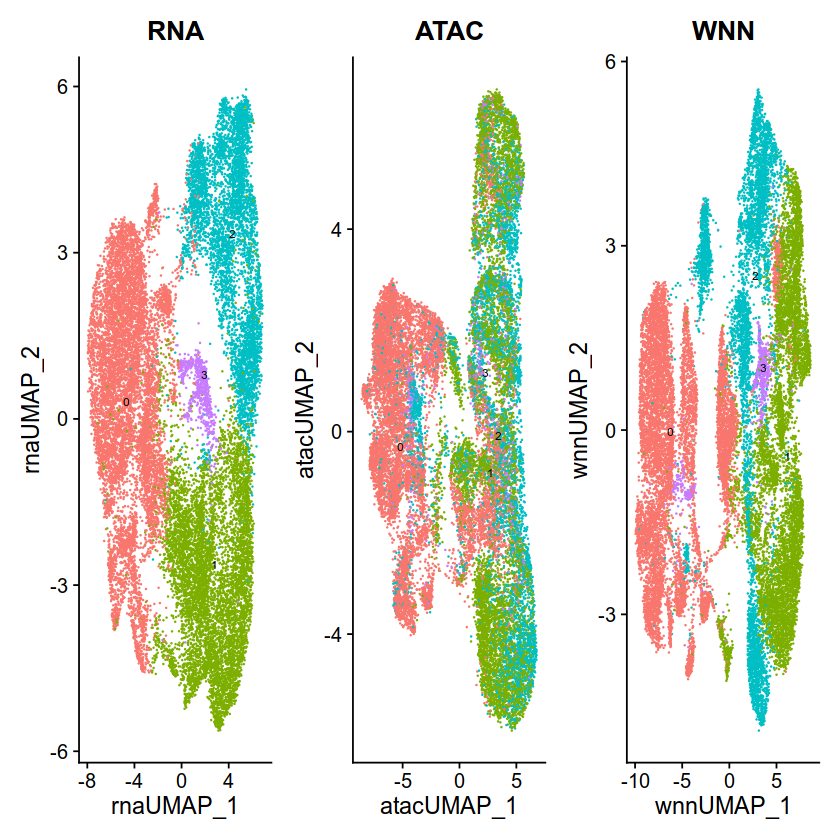

In [22]:
p1 <- DimPlot(glio.int, reduction = "rna.umap", group.by = "CCA_RNA_snn_res.0.2", label = TRUE, label.size = 2.5, repel = TRUE) + ggtitle("RNA")
p2 <- DimPlot(glio.int, reduction = "umap", group.by = "CCA_RNA_snn_res.0.2", label = TRUE, label.size = 2.5, repel = TRUE) + ggtitle("ATAC")
p3 <- DimPlot(glio.int, reduction = "wnn.umap", group.by = "CCA_RNA_snn_res.0.2",label = TRUE, label.size = 2.5, repel = TRUE) + ggtitle("WNN")
p1 + p2 + p3 & NoLegend() & theme(plot.title = element_text(hjust = 0.5))

Warning message:
"Could not find MA0511.2 in the default search locations, found in chromvar assay instead"


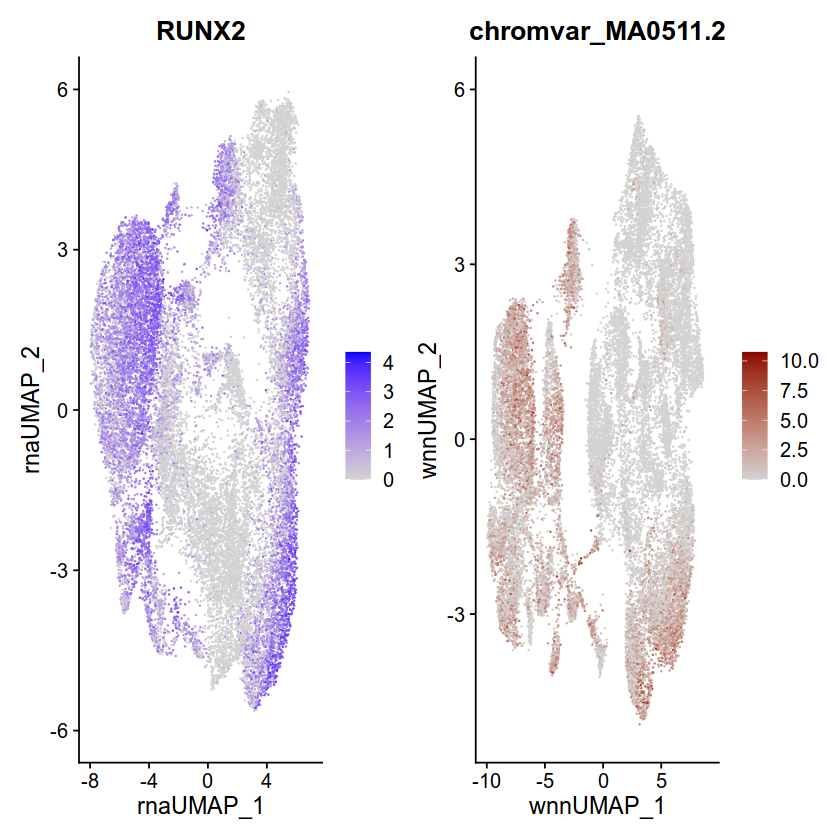

In [9]:
DefaultAssay(glio.int) <- "ATAC_common_peak"
motif.name <- ConvertMotifID(glio.int, name = 'RUNX2')
DefaultAssay(glio.int) <- "RNA"
gene_plot <- FeaturePlot(glio.int, features = "RUNX2", reduction = 'rna.umap')
motif_plot <- FeaturePlot(glio.int, features = motif.name, min.cutoff = 0, cols = c("lightgrey", "darkred"), reduction = 'wnn.umap')
#umap<-DimPlot(glio.int, reduction = "umap", group.by = "patient", label = TRUE, label.size = 2.5, repel = TRUE) + ggtitle("RNA")
 gene_plot | motif_plot


In [23]:
DefaultAssay(glio.int) <- "CCA_RNA"
markers_rna <- presto:::wilcoxauc.Seurat(X = glio.int, group_by = 'CCA_RNA_snn_res.0.2', assay = 'data', seurat_assay = 'CCA_RNA')
DefaultAssay(glio.int) <- "peaks"
markers_motifs <- presto:::wilcoxauc.Seurat(X = glio.int, group_by = 'CCA_RNA_snn_res.0.2', assay = 'data', seurat_assay = 'chromvar')
motif.names <- markers_motifs$feature
colnames(markers_rna) <- paste0("RNA.", colnames(markers_rna))
colnames(markers_motifs) <- paste0("motif.", colnames(markers_motifs))
markers_rna$gene <- markers_rna$RNA.feature
markers_motifs$gene <- ConvertMotifID(glio.int, id = motif.names)

In [24]:
topTFs <- function(CCA_RNA_snn_res.0.2, padj.cutoff = 0.05) {
  ctmarkers_rna <- dplyr::filter(
    markers_rna, RNA.group == CCA_RNA_snn_res.0.2, RNA.padj < padj.cutoff, RNA.logFC > 0.5,RNA.auc>0.5 )
#    %>% 
#    arrange(-RNA.auc)
  ctmarkers_motif <- dplyr::filter(
    markers_motifs, motif.group == CCA_RNA_snn_res.0.2, motif.padj < padj.cutoff, motif.logFC > 0.5,motif.auc > 0.5) 
#    %>% 
#    arrange(-motif.auc)
  top_tfs <- inner_join(
    x = ctmarkers_rna[, c(2, 11, 6, 7)], 
    y = ctmarkers_motif[, c(2, 1, 11, 6, 7)], by = "gene"
  )
#  top_tfs$avg_auc <- (top_tfs$RNA.auc + top_tfs$motif.auc) / 2
#  top_tfs <- arrange(top_tfs, -avg_auc)
  return(top_tfs)
}

In [25]:
topTFs_rna <- function(CCA_RNA_snn_res.0.2, padj.cutoff = 0.01) {
  ctmarkers_rna <- dplyr::filter(
    markers_rna, RNA.group == CCA_RNA_snn_res.0.2, RNA.padj < 0.01, RNA.logFC > 0.5,RNA.auc>0.6 ) 
  ctmarkers_motif <- dplyr::filter(
    markers_motifs, motif.group == CCA_RNA_snn_res.0.2, motif.padj < padj.cutoff, motif.logFC > 0) 
  top_tfs <- ctmarkers_rna
  return(top_tfs)
}

In [26]:
topTFs_motif <- function(CCA_RNA_snn_res.0.2, padj.cutoff = 0.01) {
  ctmarkers_rna <- dplyr::filter(
    markers_rna, RNA.group == CCA_RNA_snn_res.0.2, RNA.padj < padj.cutoff, RNA.logFC > 0.5,RNA.avgExpr > 0.5 ) 
  ctmarkers_motif <- dplyr::filter(
    markers_motifs, motif.group == CCA_RNA_snn_res.0.2, motif.padj < padj.cutoff, motif.logFC > 0.5,motif.auc > 0.6) 
  top_tfs <- ctmarkers_motif
  return(top_tfs)
}

In [27]:
tf1_c<-topTFs("1")
tf2_c<-topTFs("2")
tf3_c<-topTFs("3")
tf4_c<-topTFs("0")
tf_c<-rbind(tf1_c,tf2_c,tf3_c,tf4_c)

In [28]:
tf_c

RNA.group,gene,RNA.auc,RNA.pval,motif.group,motif.feature,motif.auc,motif.pval
<chr>,<chr>,<dbl>,<dbl>,<chr>,<chr>,<dbl>,<dbl>
1,SOX4,0.7418561,0,1,MA0867.2,0.6533489,3.191748e-306
0,NFIA,0.7530829,0,0,MA0670.1,0.7062963,0.000000e+00


In [29]:
tf1_motif<-topTFs_motif("1")
tf2_motif<-topTFs_motif("2")
tf3_motif<-topTFs_motif("3")
tf4_motif<-topTFs_motif("0")

In [30]:
tf1_rna<-topTFs_rna("1")
tf2_rna<-topTFs_rna("2")
tf3_rna<-topTFs_rna("3")
tf4_rna<-topTFs_rna("0")
tf_rna<-rbind(tf1_rna,tf2_rna,tf3_rna,tf4_rna)
tf_motif<-rbind(tf1_motif,tf2_motif,tf3_motif,tf4_motif)

In [31]:
tf_motif

motif.feature,motif.group,motif.avgExpr,motif.logFC,motif.statistic,motif.auc,motif.pval,motif.padj,motif.pct_in,motif.pct_out,gene
<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>
MA0091.1,1,0.9623918,1.3464493,80392146,0.7129493,0.000000e+00,0.000000e+00,100,100,TAL1::TCF3
MA0139.1,1,0.3892613,0.6642621,70016836,0.6209369,2.933232e-191,1.197894e-190,100,100,CTCF
MA0506.1,1,0.3031772,0.5127251,71151047,0.6309956,4.923075e-224,2.733602e-223,100,100,NRF1
MA0507.1,1,0.4825331,0.5583893,69115790,0.6129461,4.399035e-167,1.505183e-166,100,100,POU2F2
MA0618.1,1,0.5874753,0.6896578,70858111,0.6283977,2.554539e-215,1.325429e-214,100,100,LBX1
MA0630.1,1,0.4628457,0.5582767,69414243,0.6155929,6.577610e-175,2.352332e-174,100,100,SHOX
MA0634.1,1,0.5349511,0.6278645,70577470,0.6259089,3.919238e-207,1.837687e-206,100,100,ALX3
MA0642.1,1,0.4037149,0.5035042,68663294,0.6089332,1.454574e-155,4.770701e-155,100,100,EN2
MA0644.1,1,0.4924304,0.5881203,69760117,0.6186602,3.336214e-184,1.295597e-183,100,100,ESX1


In [32]:
markers_chromatin <- presto:::wilcoxauc.Seurat(X = glio.int, group_by = 'CCA_RNA_snn_res.0.2', assay = 'data', seurat_assay = 'peaks')


In [38]:
topTFs_chromatin <- function(CCA_RNA_snn_res.0.2, padj.cutoff = 0.05) {
  ctmarkers_chromatin <- dplyr::filter(
    markers_chromatin, group == CCA_RNA_snn_res.0.2, padj < 0.05, logFC > 0.2,auc > 0.5) 
    top_tfs <- ctmarkers_chromatin
  return(top_tfs)
}

In [39]:
tf1_chromatin<-topTFs_chromatin("0")
tf2_chromatin<-topTFs_chromatin("1")
tf3_chromatin<-topTFs_chromatin("2")
tf4_chromatin<-topTFs_chromatin("3")
tf_chromatin<-rbind(tf1_chromatin,tf2_chromatin,tf3_chromatin,tf4_chromatin)


In [40]:
tf_chromatin

feature,group,avgExpr,logFC,statistic,auc,pval,padj,pct_in,pct_out
<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
chr1-2198878-2199687,0,0.3612938,0.2149637,69814976,0.5568019,2.522908e-140,4.980767e-138,19.329431,8.107298
chr1-2208212-2208813,0,0.3533823,0.2583799,70337160,0.5609665,5.469825e-204,4.389874e-201,16.838744,4.750487
chr1-3368847-3370138,0,0.3179908,0.2579941,69546958,0.5546643,6.777453e-216,6.710588e-213,13.592336,2.712423
chr1-3515449-3516752,0,0.3081750,0.2017558,68404908,0.5455560,1.385351e-128,2.159285e-126,13.911655,4.825416
chr1-3542619-3543725,0,0.3929298,0.3098030,72279110,0.5764543,4.597728e-296,1.584224e-292,19.542310,4.338379
chr1-8879954-8880663,0,0.3612643,0.2103536,69517544,0.5544297,1.802315e-129,2.866235e-127,19.010112,8.242170
chr1-12447088-12448522,0,0.4019453,0.2480589,71187136,0.5677454,2.000332e-181,1.027705e-178,22.064928,8.639293
chr1-12448814-12449738,0,0.2829711,0.2003768,67843982,0.5410824,1.748991e-125,2.549256e-123,11.814795,3.679005
chr1-12556193-12556867,0,0.3199275,0.2474997,69197798,0.5518796,2.312670e-187,1.346063e-184,13.571048,3.251911


In [41]:
library(ComplexHeatmap)

ComplexHeatmap version 2.14.0
Bioconductor page: http://bioconductor.org/packages/ComplexHeatmap/
Github page: https://github.com/jokergoo/ComplexHeatmap
Documentation: http://jokergoo.github.io/ComplexHeatmap-reference

If you use it in published research, please cite either one:
- Gu, Z. Complex Heatmap Visualization. iMeta 2022.
- Gu, Z. Complex heatmaps reveal patterns and correlations in multidimensional 
    genomic data. Bioinformatics 2016.


The new InteractiveComplexHeatmap package can directly export static 
complex heatmaps into an interactive Shiny app with zero effort. Have a try!

This message can be suppressed by:
  suppressPackageStartupMessages(library(ComplexHeatmap))




In [43]:
library(pheatmap)
library( "RColorBrewer" )
annotation<-data.frame(glio.int$`CCA_RNA_snn_res.0.2`)
rownames(annotation)<-names(glio.int$`CCA_RNA_snn_res.0.2`)


In [44]:
#annotation<-NULL
annotation$glio.int.CCA_RNA_snn_res.0.2<-factor(glio.int$`CCA_RNA_snn_res.0.2`)

In [45]:
color = colorRampPalette(brewer.pal(3,"RdBu"))(21)
breaks<-seq(-1.5,1.5,by=0.15)

In [46]:
annotation3<-data.frame(group=annotation[order(annotation$glio.int.CCA_RNA_snn_res.0.2),])
rownames(annotation3)<-rownames(annotation)[order(annotation$glio.int.CCA_RNA_snn_res.0.2)]
annotation3$group<-factor(annotation3$group)

In [47]:
s<-as.matrix(glio.int@assays$chromvar@data[tf_motif$motif.feature,])
s2<-as.matrix(s[,rownames(annotation3)])


In [48]:
tf_motif$motif.group

[1] "1" "1" "1" "1" "1" "1" "1" "1" "1" "1" "1" "1" "1" "1" "1" "1" "1" "1"
 [19] "1" "1" "1" "1" "1" "1" "1" "1" "1" "1" "1" "1" "1" "1" "1" "1" "1" "1"
 [37] "1" "1" "1" "1" "1" "1" "1" "1" "1" "1" "1" "1" "1" "1" "1" "1" "1" "1"
 [55] "1" "1" "1" "1" "1" "1" "1" "1" "1" "1" "1" "1" "1" "1" "1" "1" "1" "1"
 [73] "1" "1" "1" "1" "1" "1" "1" "1" "1" "1" "1" "1" "1" "1" "1" "1" "1" "1"
 [91] "1" "1" "1" "1" "1" "1" "1" "1" "1" "1" "1" "1" "1" "1" "2" "2" "2" "2"
[109] "2" "2" "2" "2" "2" "2" "2" "2" "2" "2" "2" "2" "2" "2" "2" "2" "2" "2"
[127] "2" "2" "2" "2" "2" "2" "2" "2" "2" "2" "2" "2" "2" "2" "2" "2" "2" "2"
[145] "2" "2" "2" "2" "2" "2" "2" "2" "2" "2" "2" "2" "2" "2" "2" "2" "2" "2"
[163] "2" "2" "2" "2" "2" "2" "2" "2" "2" "2" "2" "2" "2" "2" "2" "2" "2" "2"
[181] "2" "2" "2" "2" "3" "3" "3" "3" "3" "3" "3" "3" "3" "0" "0" "0" "0" "0"
[199] "0" "0" "0" "0" "0" "0" "0" "0" "0" "0" "0" "0" "0" "0" "0" "0" "0" "0"
[217] "0" "0" "0" "0" "0" "0" "0" "0" "0" "0" "0" "0" "0" "0" "0" "0" "0" "0"
[235] "0" "0" "0" "0" "0" "0" "0" "0" "0" "0" "0" "0" "0" "0" "0" "0" "0" "0"
[253] "0" "0" "0" "0" "0" "0" "0" "0" "0" "0" "0" "0" "0" "0" "0" "0" "0" "0"
[271] "0" "0" "0" "0" "0" "0" "0" "0" "0" "0" "0" "0" "0" "0" "0"

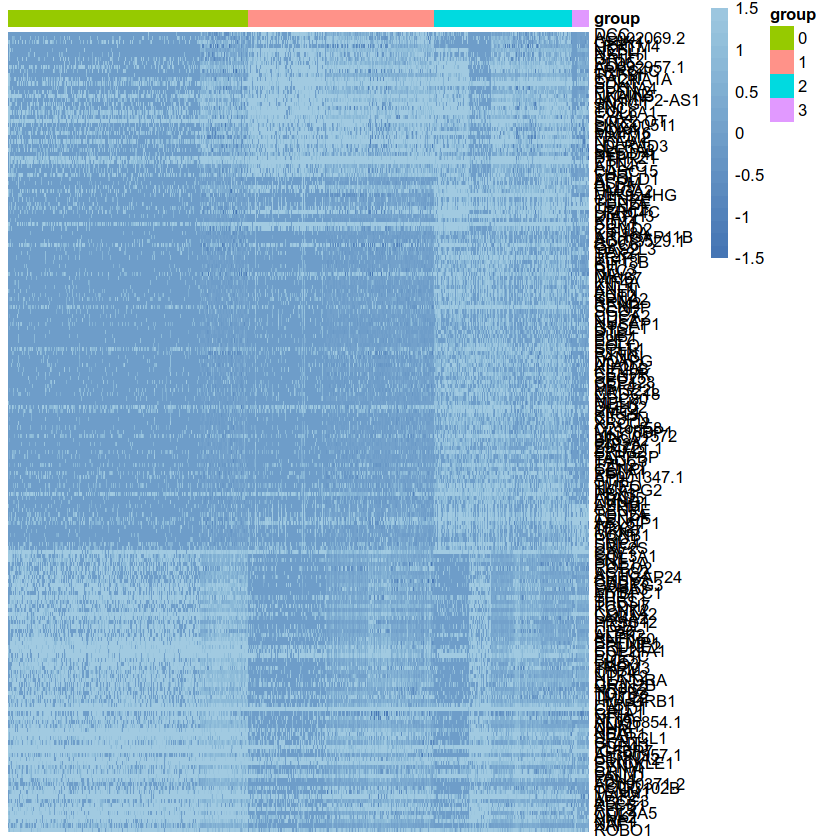

In [54]:
pheatmap(s2, show_rownames=T, cluster_rows=F,cluster_cols = F,annotation_col=annotation3,clustering_distance_rows="euclidean",breaks=breaks,clustering_distance_cols="euclidean",scale="none",show_colnames= F,colors=color)


pdf 
  3

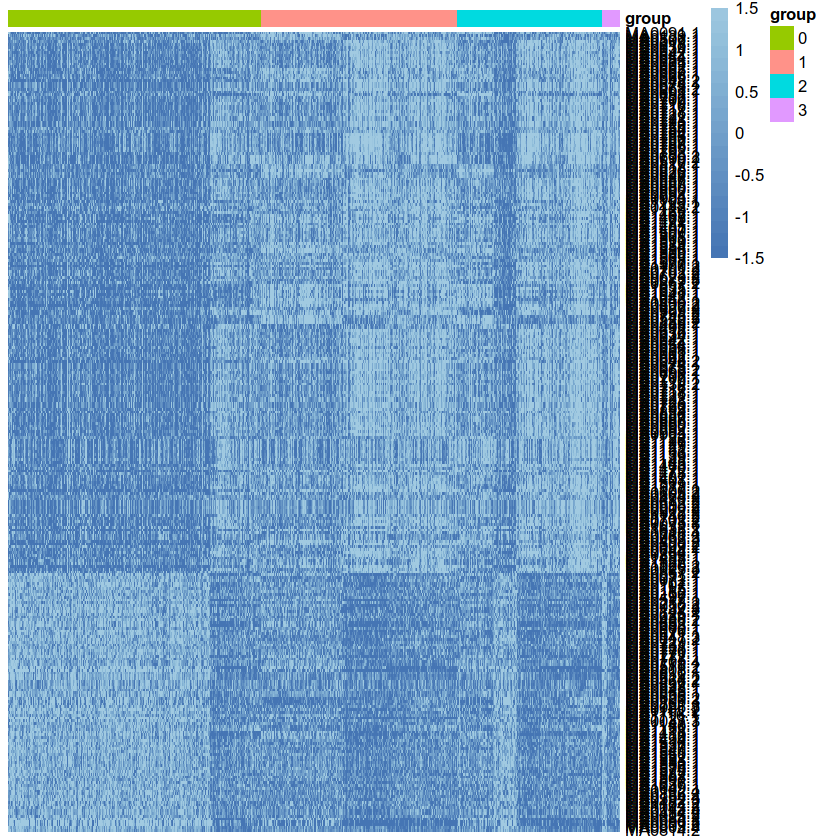

In [50]:
pheatmap(s2, show_rownames=T, cluster_rows=F,cluster_cols = F,annotation_col=annotation3,clustering_distance_rows="euclidean",breaks=breaks,clustering_distance_cols="euclidean",scale="none",show_colnames= F)

pdf("motif.scatac.pdf")
pheatmap(s2, show_rownames=F, cluster_rows=F,cluster_cols = F,clustering_distance_cols="euclidean",scale="row",show_colnames= T,color = rev(color),annotation_col=annotation3,clustering_distance_rows="euclidean", cex=1, clustering_method="complete", border_color=FALSE,fontsize_row=0.2,fontsize_col=4,breaks=breaks)
dev.off()

In [51]:
#rna
s<-as.matrix(glio.int@assays$CCA_RNA@data[tf_rna$RNA.feature,])
s2<-as.matrix(s[,rownames(annotation3)])


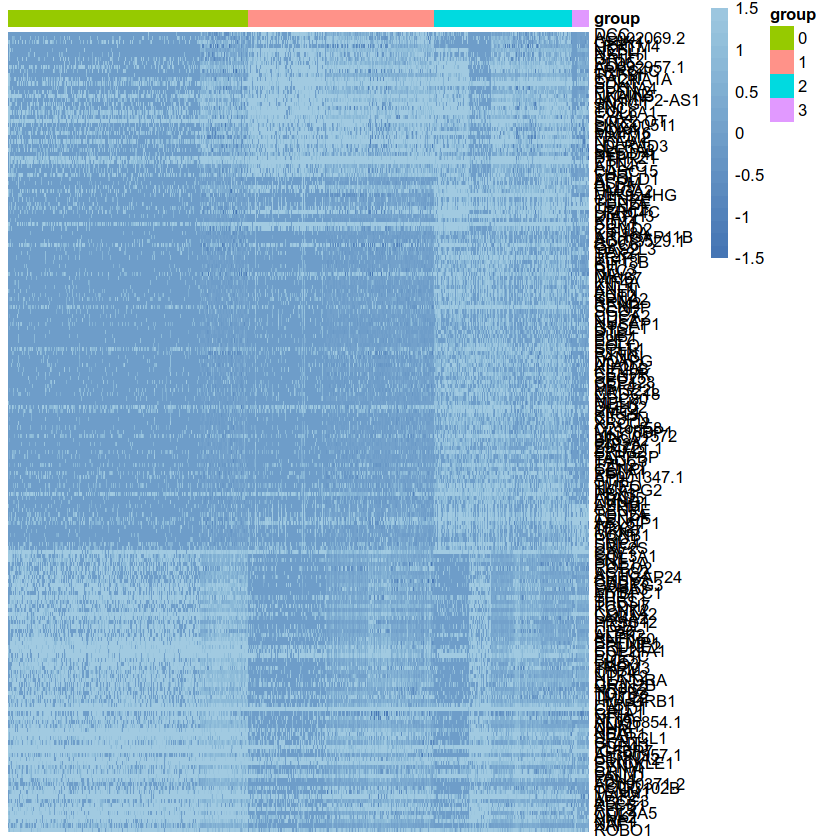

In [52]:
pheatmap(s2, show_rownames=T, cluster_rows=F,cluster_cols = F,annotation_col=annotation3,clustering_distance_rows="euclidean",breaks=breaks,clustering_distance_cols="euclidean",scale="none",show_colnames= F)


In [53]:
pheatmap(s2, show_rownames=T, cluster_rows=F,cluster_cols = F,annotation_col=annotation3,clustering_distance_rows="euclidean",breaks=breaks,clustering_distance_cols="euclidean",scale="none",show_colnames= F)
pdf("gene.scatac.pdf")
pheatmap(s2, show_rownames=T, cluster_rows=F,cluster_cols = F,annotation_col=annotation3,clustering_distance_rows="euclidean",breaks=breaks,clustering_distance_cols="euclidean",scale="none",show_colnames= F)
dev.off()

In [ ]:
#chromatin 
s<-as.matrix(glio.int@assays$peaks@data[tf_chromatin$feature,])
s2<-as.matrix(s[,rownames(annotation3)])


In [ ]:
pheatmap(s2, show_rownames=T, cluster_rows=F,cluster_cols = F,annotation_col=annotation3,clustering_distance_rows="euclidean",breaks=breaks,clustering_distance_cols="euclidean",scale="none",show_colnames= F)


In [ ]:
pheatmap(s2, show_rownames=T, cluster_rows=F,cluster_cols = F,annotation_col=annotation3,clustering_distance_rows="euclidean",breaks=breaks,clustering_distance_cols="euclidean",scale="none",show_colnames= F)
pdf("chromatin.scatac.pdf")
pheatmap(s2, show_rownames=T, cluster_rows=F,cluster_cols = F,annotation_col=annotation3,clustering_distance_rows="euclidean",breaks=breaks,clustering_distance_cols="euclidean",scale="none",show_colnames= F)
dev.off()

In [ ]:
DefaultAssay(glio.int) <- "peaks"


In [ ]:
glio.int <- RegionStats(glio.int, genome = BSgenome.Hsapiens.UCSC.hg38)


In [ ]:
peaklink <- LinkPeaks(
  object = glio.int,
  peak.assay = "peaks",
  expression.assay = "CCA_RNA",
  genes.use = c("NFIA", "GFAP")
)

In [ ]:
p1 <- CoveragePlot(
  object = peaklink,
  region = "NFIA",
  features = "NFIA",
  expression.assay = "CCA_RNA",
  idents = c("0","1","2","3"),
  extend.upstream = 500,
  extend.downstream = 10000
)
patchwork::wrap_plots(p1, ncol = 1)

In [ ]:
p2 <- CoveragePlot(
  object = peaklink,
  region = "GFAP",
  features = "GFAP",
  expression.assay = "CCA_RNA",
  idents = c("0","1","2","3"),
  extend.upstream = 500,
  extend.downstream = 10000
)
patchwork::wrap_plots(p2, ncol = 1)